# Initializations
Before running first cell, make sure a nameserver is running on the network, the Qick board is connected to it, and the ip address listed below matches that of the nameserver. 

You just need to run the first cell, then should be able to run any other cell in whatever order. 



In [1]:
import os
import time
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from qick import QickConfig
from exp_handling.instrumentmanager import InstrumentManager
import experiments as meas
import config
from calib import qubit_tuning, tuneup
import handy
# import importlib 
# importlib.reload(meas)

%load_ext autoreload
%autoreload 2

# Configuration
ip = '192.168.137.1'
expt_path = 'C:\\_Data\\LLotsa\\Tuning_2025_01_11\\'
cfg_file = 'llotsa05.yml'
max_t1 = 75

# Set seaborn color palette
colors = ["#0869c8", "#b51d14", '#ddb310', '#658b38', '#7e1e9c', '#75bbfd', '#cacaca']
sns.set_palette(sns.color_palette(colors))

# Figure parameters
plt.rcParams['figure.figsize'] = [8, 4]
plt.rcParams.update({'font.size': 13})

print('Data will be stored in', expt_path)

# Results config file
cfg_path = os.path.join(os.getcwd(), 'configs', cfg_file)
auto_cfg = config.load(cfg_path)

# Connect to instruments
im = InstrumentManager(ns_address=ip)
print(im)
soc = QickConfig(im[auto_cfg['aliases']['soc']].get_cfg())
print(soc)

num_qubits = len(auto_cfg.device.qubit.f_ge)
cfg_dict = {'soc': soc, 'expt_path': expt_path, 'cfg_file': cfg_path, 'im': im}


imported experiments.single_qubit.active_reset
imported experiments.single_qubit.inactive
imported experiments.single_qubit.pulse_probe_spectroscopy
imported experiments.single_qubit.rabi
imported experiments.single_qubit.resonator_spectroscopy
imported experiments.single_qubit.single_shot
imported experiments.single_qubit.t1
imported experiments.single_qubit.t1_cont
imported experiments.single_qubit.t1_stark
imported experiments.single_qubit.t2
imported experiments.single_qubit.t2_echo
imported experiments.single_qubit.t2_ramsey
imported experiments.single_qubit.t2_ramsey_stark
imported experiments.single_qubit.tof_calibration
imported experiments.two_qubit.rabi_2q
imported experiments.two_qubit.t1_2q
imported experiments.two_qubit.t1_2q_cont
imported experiments.two_qubit.t1_2q_conttest
Data will be stored in C:\_Data\LLotsa\Tuning_2025_01_11\
{'Pyro.NameServer': <Pyro4.core.Proxy at 0x1a9796101f0; not connected; for PYRO:Pyro.NameServer@192.168.137.1:9090>, 'Qick233': <Pyro4.core.Pr

## Set up new config or data folder

After running, move expt_path and cfg_file to the first cell. 

Note: make sure you set your ADC/DAC channels correctly. This code does not automatically fill in the ADC/DAC into your configuration file, so you should check yourself to make sure these values are correct. 

In [2]:
new_config = False
new_folder = False
import os 
import config 

if new_config or new_folder:
    expt_path = 'C:\\_Data\\LLotsa\\Tuning_2024_12_20_tprocv2\\'
    cfg_file='llotsa05.yml'
    if new_config:
        
        config.init_config( os.getcwd() + '\\configs\\' + cfg_file, 20, type='full', aliases='Qick233', t1=30)

    os.mkdir(expt_path)
    os.mkdir(expt_path + 'images')
    os.mkdir(expt_path + 'images\\summary')


## Signalcore init

In [3]:
sc1 = im['SC1']
sc2 = im['SC2']

sc1.open_device()
sc2.open_device()

def set_frequency(sc, freq):
    sc.set_standby(enable = True)
    sc1.set_frequency(freq*1e6)
    sc2.set_standby(enable = False)
    time.sleep(5)

def set_power(sc, power):
    sc.set_standby(enable = True)

    sc.set_power(power)
    sc.set_standby(enable = False)

    time.sleep(5)

KeyError: 'SC1'

In [ ]:
sc1.set_power(13)
sc2.set_power(13)

In [ ]:
sc1
sc1.close_device()

## Check QICK issues

### Check mirror frequencies 

In [3]:
import qick_check

qick_check.check_freqs(3, cfg_dict['cfg_file'])

We mirror around 4792.32
Possible frequencies are 5054.5825 and 4530.057499999999
Possible ef frequencies are 4865.8348 and 4718.8052
Anharmonicity is 188.7477000000008. With alt_ef it is 335.77730000000065
Both ef frequencies are less than chosen freq and greater than alt freq, so freq is correct choice


In [26]:
cfg_dict['soc']._get_ch_cfg(ro_ch=0)['f_dds']/2
cfg_dict['soc'].cycles2us(1)

0.0023251488095238095

### Make sure you're not near the nyquist frequency of the ADC

In [280]:
import qick_check
qick_check.check_adc(cfg_dict)

Distance to Nyquist zone 2 boundary: 87.6 MHz


# Time of Flight (TOF)

TOF measures the time it takes for the signal to run through the wires. It will give us the time in clock ticks that we should wait to make a measurements 

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit5_00002.h5


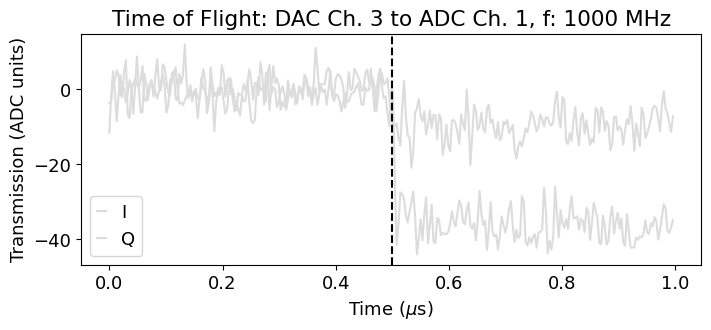

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit5_00003.h5


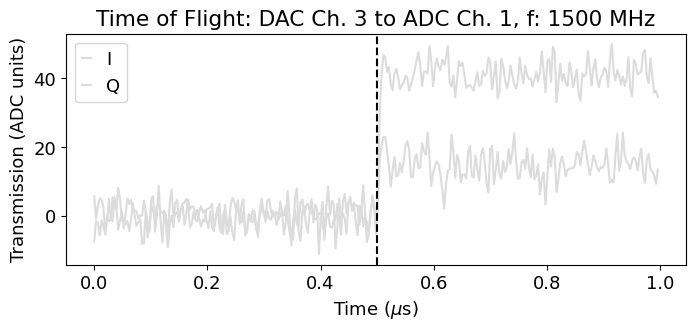

  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [281]:
qubit_list = np.arange(3)
qubit_list = [5]
f = [2450,24]
#f = [2800,2900,3000,3100]
#f= [1900,2200]
f = [1000,1500,2000,2200,2400.0, 2442, 2450, 2452, 2454, 2455, 2455.3, 2455.6, 2456, 2457, 2459, 2461,3000]
for fi in f: 
        for qi in qubit_list:        
                tof=meas.ToFCalibrationExperiment(cfg_dict=cfg_dict, qi=qi,params={'frequency':fi})
# use this to set trig_offset in config file

# Resonator Spectroscopy 

Run resonator spectroscopy for all resonators by choosing a large frequency scan to look over. The scan will then find the different resonators and fill in the config file with their respective frequencies. In the autocalibration, there will be a finer sweep of each resonator to more accurately find its frequency. The frequencies are saved in <code>auto_cfg.device.readout.frequency</code>

## Coarse 

This will perform peak finding

  0%|          | 0/2000000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_coarsecoarse_qubit0_00018.h5
Number of peaks: 0


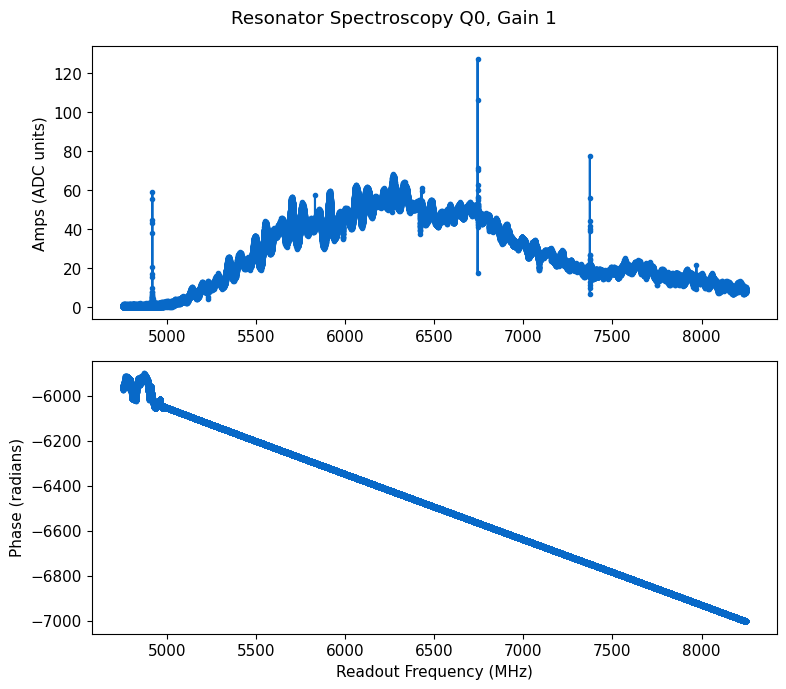

In [334]:
#rspec = cfg.make_rspec_coarse(soc, expt_path, cfg_path, i, im=im, start=6000, span=800, reps=2000, npts=5000)
qi=0
rspecc = meas.ResSpec(cfg_dict, qi=qi, style='coarse', params={'start':150, 'span':3500, 'soft_avgs':1, 'reps':20, 'gain':1, 'expts':100000})
res_values = rspecc.data['coarse_peaks']

Change prom (prominence value) to adjust how to find the peaks

In [ ]:
rspecc.analyze(peaks=True, debug=True, fit=False, prom=0.05)
rspecc.display(peaks=True, fit=False)
res_values = rspecc.data['coarse_peaks']

Can delete values from res_values if they don't seem to be real res_values. 

In [23]:
res_values = np.delete(res_values,1)

## Fine

  0%|          | 0/146200 [00:00<?, ?it/s]

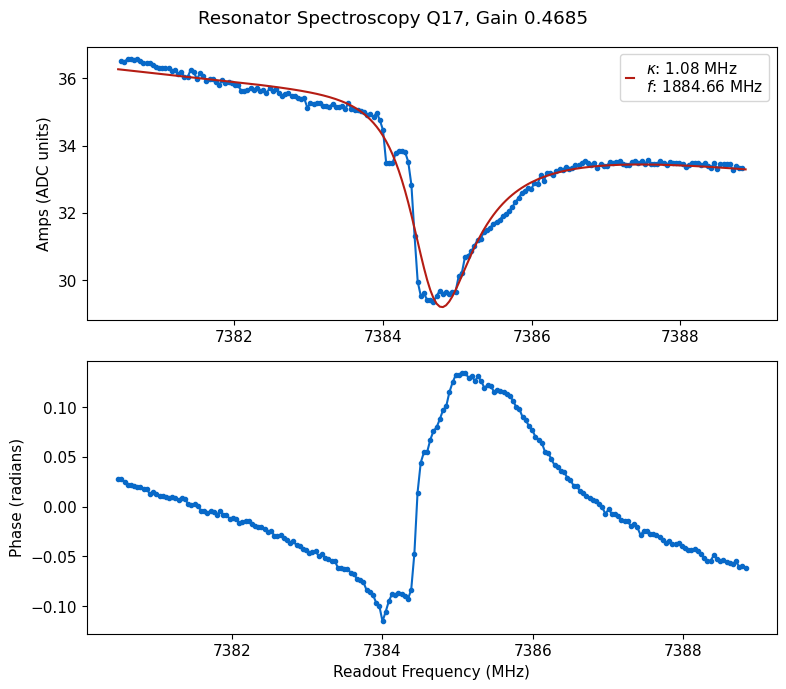

*Set cfg readout 17 frequency to 1884.6793 from 1884.6589*
*Set cfg readout 17 qi to 0.8244 from 0.6869*
*Set cfg readout 17 qe to 4.0233 from 3.7349*
*Set cfg readout 17 kappa to 1.0794 from 1.0549*


In [545]:
# Just run one  
update=True

qubit_list = np.arange(10)
qubit_list=[17]
for qi in qubit_list:    
    #rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':5, 'center':res_values[qi], 'gain':0.25}) # Use this to sweep through the res_values list
    rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':'kappa'})
    #rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':10})
    if update:
        rspec.update(cfg_dict['cfg_file'])

In [ ]:
config.update_lo(cfg_path, 'gain', 0.18, qi);

## Resonator Power Spectroscopy 

Find a good value for gain to park your readout at until you run readout optimization. From the 2D sweep that is produced, choose a value for gain that is right before the resonator 'breaks' (goes from e -> f). Want to choose a high value for gain because we want to be in the shot noise limited regime which increases our signal:noise ratio. The gain value should be saved in <code>auto_cfg.device.readout.gain</code>

[0, 0, 1, 1, 1, 1, 2, 3, 4, 6, 9, 13, 18, 26, 37, 53, 76, 109, 156, 224]


  0%|          | 0/20 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_power_sweep_qubit10_00006.h5
High power peak [MHz]: 985.9621080159778
Low power peak [MHz]: 986.1051998259587
Lamb shift [MHz]: -0.14309180998088777


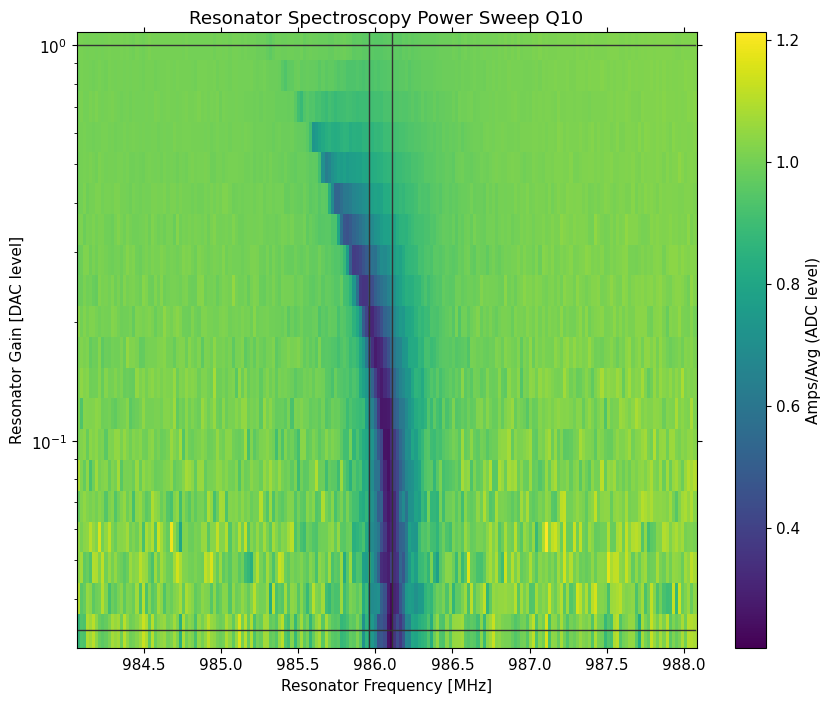

In [50]:
update=False
qubit_list = np.arange(13,20)
d=[]
qubit_list=[10]
for qi in qubit_list:
    #rpowspec=meas.ResSpecPower(cfg_dict, qi=qi)
    rpowspec=meas.ResSpecPower(cfg_dict, qi=qi, params={'rng':30, 'span':4,"f_off":0})
    d.append(rpowspec)
    if update:
        auto_cfg = config.update_readout(cfg_path, 'lamb', rpowspec.data['lamb_shift'], qi)


In [ ]:
auto_cfg = config.load(cfg_path)
horz_line = auto_cfg.device.readout.gain
handy.plot_many(d, title='Resonator Power', save_path=cfg_dict['expt_path'], chan='amps', yax='log', norm=True, horz_line=horz_line)

### Save gain values 

In [ ]:
# assign the resonator gain to the results config file
gain_values = [0.1,0.01]
for i in range(num_qubits):
    auto_cfg = config.update_readout(cfg_file, 'gain', int(gain_values[i]), i)

### Check effect of changing LO power

In [ ]:
lo = [0.01,0.02,0.04, 0.08, 0.16, 0.3, 0.5]
d=[]
for l in lo:
    config.update_lo(cfg_path, 'gain', l, qi)
    qubit_list=[10]
    for qi in qubit_list:
        rpowspec=meas.ResSpecPower(cfg_dict, qi=qi, params={'rng':10})
        d.append(rpowspec)

fig, ax = plt.subplots(3,3, figsize=(10,10))
ax = ax.flatten()
fig.suptitle('Lamb Shift')
for i in range(len(d)):
    ax[i].pcolormesh(d[i].data['xpts'],d[i].data['ypts'],d[i].data['amps'])
    ax[i].set_title(f"LO gain {lo[i]}")
    fig.colorbar(ax[i].collections[0], ax=ax[i])
fig.tight_layout()


# Qubit Spectroscopy

Now that things seems to be working, can thinking about getting rid of sections for different scan widths/powers; unless it's nice to keep the old data displayed in multiple cells?

## Find qubits

2


  0%|          | 0/600000 [00:00<?, ?it/s]

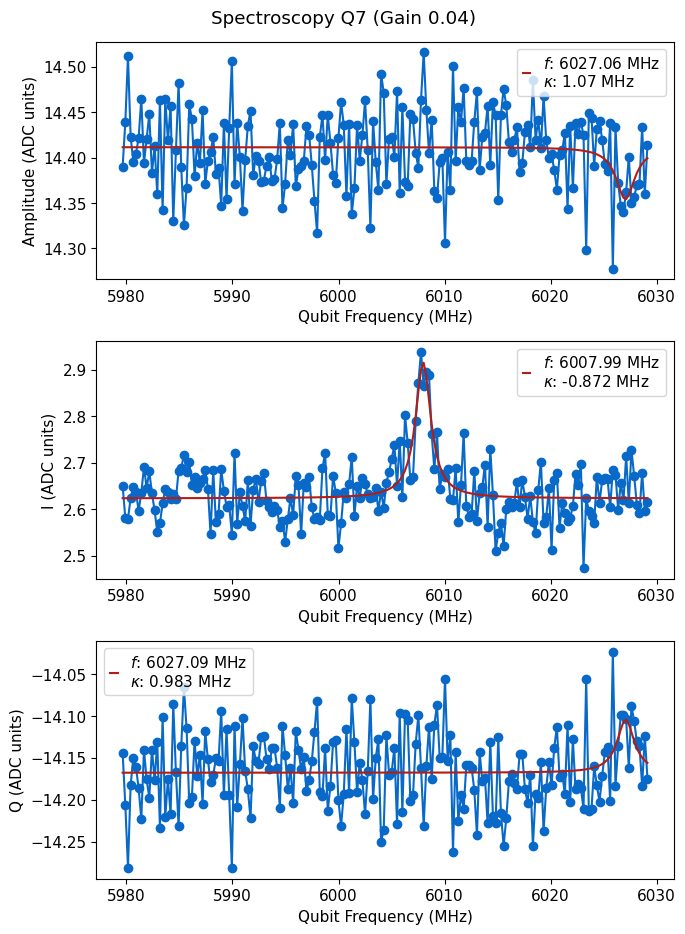

*Set cfg qubit 7 f_ge to 6007.9882 from 6004.3901*
3


  0%|          | 0/600000 [00:00<?, ?it/s]

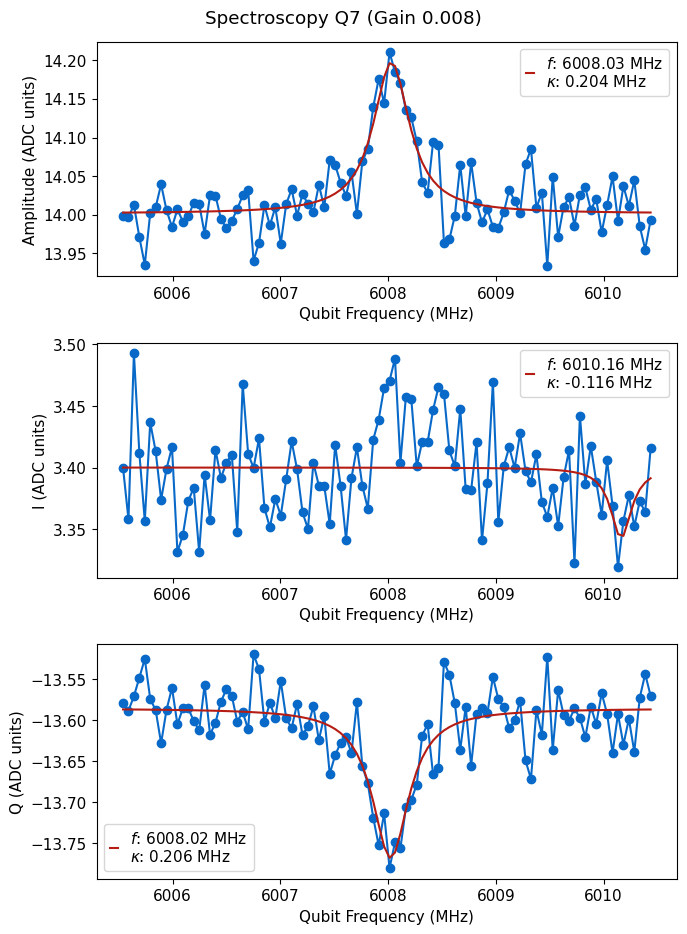

*Set cfg qubit 7 f_ge to 6008.0308 from 6007.9882*
Found qubit 7


In [9]:
qubit_list= [7]
#qubit_list = np.arange(13,20)
bad_qubits=[]
for qi in qubit_list:
    status, ntries = qubit_tuning.find_spec(qi, cfg_dict, start='medium')
    if not status:
        bad_qubits.append(qi)

### Updating frequencies (currently defunct, not using peak finding)

In [ ]:
# Here, choose which peak you want to save the value for, adjust index accordingly
auto_cfg = config.update_qubit(cfg_file, 'f_ef', qspec.data["coarse_peaks_x"][0], i)
auto_cfg = config.update_qubit(cfg_file, 'f_ge', qspec.data["coarse_peaks_x"][1], i)

## General search, specify width 

fine, medium, coarse, huge (will change scan width and power)

  0%|          | 0/175600 [00:00<?, ?it/s]

R2:0.910	Fit par error:0.034	 Best fit:b'amps'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy__fine_qubit5_00009.h5


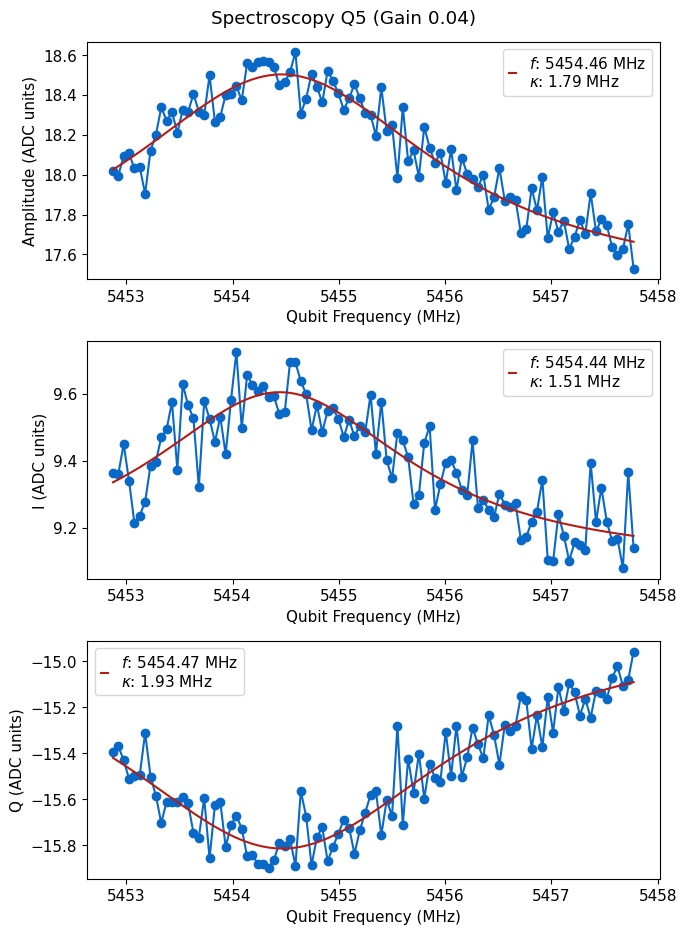

*Set cfg qubit 5 f_ge to 5454.4633 from 5455.3244*
*Set cfg qubit 5 kappa to 3.5833 from 8.9177*


In [197]:
qubit_list = [5]
update=True
#qubit_list = np.arange(5)
for qi in qubit_list: 
    qspec=meas.QubitSpec(cfg_dict, qi=qi, style='fine')
    if update and qspec.status: 
        auto_cfg = config.update_qubit(cfg_path, 'f_ge', qspec.data["best_fit"][2], qi)
        auto_cfg = config.update_qubit(cfg_path, 'kappa',2*qspec.data["best_fit"][3], qi)
    else:
        print('Bad qubit!')


## Power sweep

### Wide scan looking for qubit

In [ ]:
qubit_list = np.arange(20)
#qubit_list=[0]
d = []
for qi in qubit_list:
    qi = meas.QubitSpecPower(cfg_dict, qi=qi, style='coarse', params={'max_gain':0.3})
    d.append(qi)
handy.plot_many(d, title='Qubit Power', save_path=cfg_dict['expt_path'], yax='log', chan='amps')

### Narrow scan

  0%|          | 0/10 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\finequbit_spectroscopy_power_qubit0_00000.h5


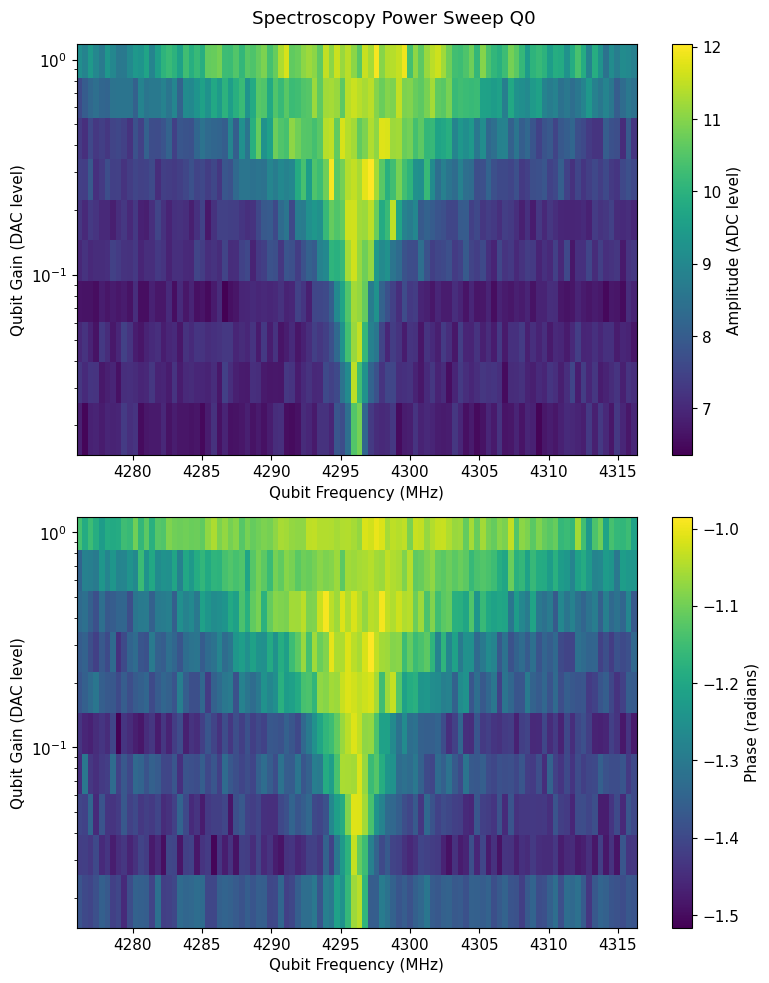

IndexError: list index out of range

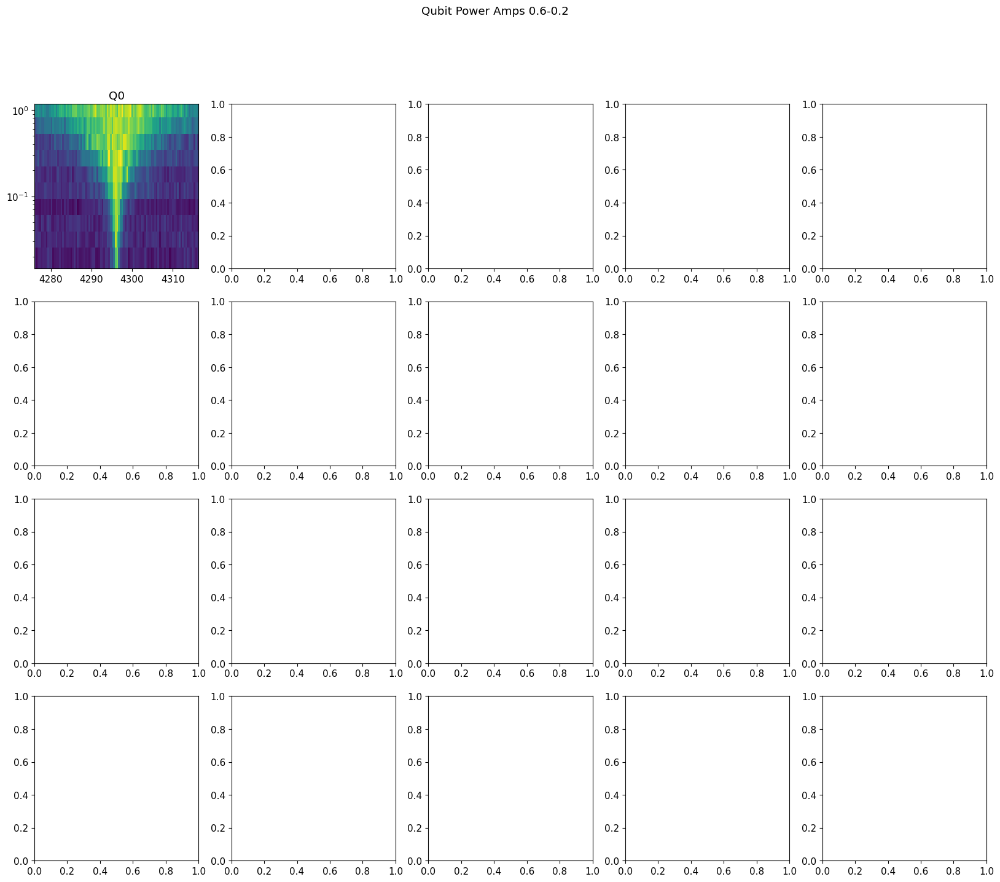

In [341]:
qq=[]
# qubit_list = np.arange(20)
qubit_list=[0]
for qi in qubit_list:
    qspec_pow = meas.QubitSpecPower(cfg_dict, qi=qi, style='fine', params={'length':'t1','max_gain':1})
    # expts_gain=13, rng=300, soft_avgs=2, len='t1', span=60)
    qq.append(qspec_pow)
#handy.plot_many(qq, title='Qubit Power Amps 0.6-0.2', save_path=cfg_dict['expt_path'], yax='log', chan='amps')
#handy.plot_many(qq, title='Qubit Power Phase 0.6-0.2', save_path=cfg_dict['expt_path'], yax='log', chan='phases')

In [369]:
qubit_list = np.arange(14,20)
qubit_list=[10]
#qubit_list = [0,1,2,10,11,12]
for qi in qubit_list: 
    auto_cfg = config.update_qubit(cfg_path, 'tuned_up',False, qi)

*Set cfg qubit 10 tuned_up to False from True*


# Coherent scans

## Fast tuneup

Options are: 

first_time: assume we don't know t1 time,don't have single shot working

single: do single shot readout optimization 

readout: set readout frequency based on resonator fit

  0%|          | 0/1200000 [00:00<?, ?it/s]

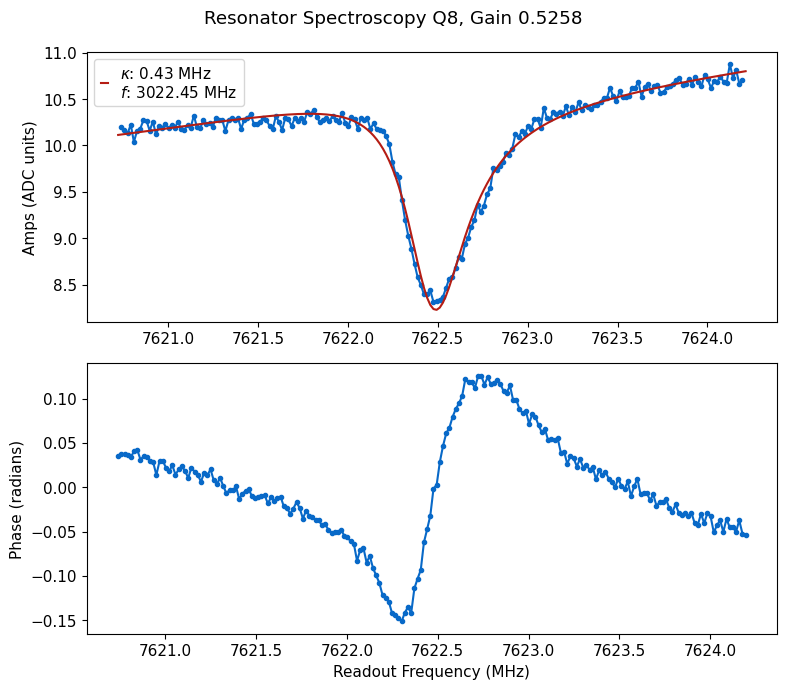

*Set cfg readout 8 frequency to 3022.4546 from 3022.4694*
*Set cfg readout 8 qi to 2.2978 from 2.2242*
*Set cfg readout 8 qe to 8.0748 from 7.754*
*Set cfg readout 8 kappa to 0.4261 from 0.4368*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

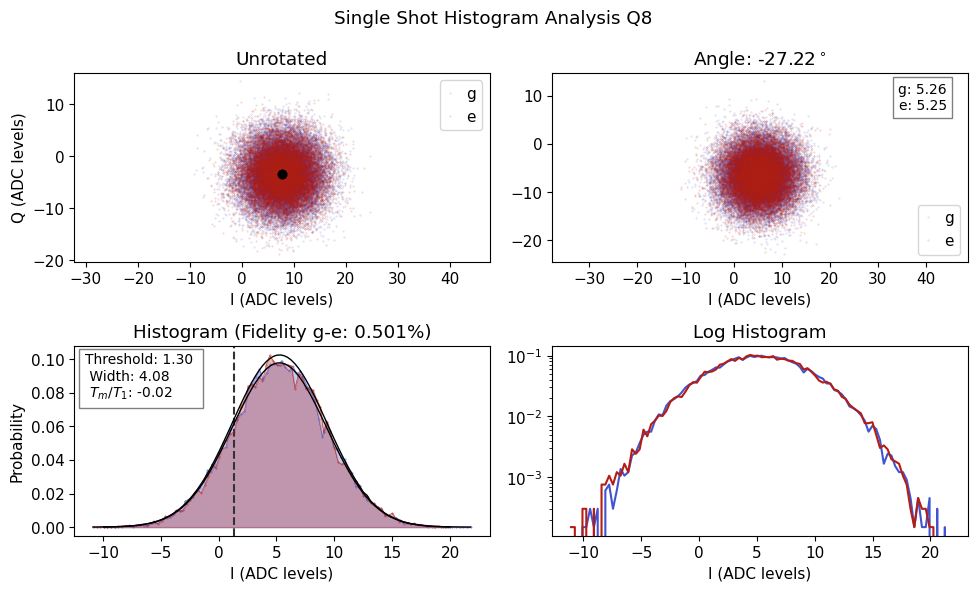

ge Fidelity (%): 0.501
Rotation angle (deg): -27.216
Threshold ge: 1.304
*Set cfg readout 8 phase to -27.2161 from 147.043*
*Set cfg readout 8 threshold to 1.3043 from -3.7387*
*Set cfg readout 8 fidelity to 0.005 from 0.0167*
*Set cfg readout 8 sigma to 4.0794 from 4.002*
*Set cfg readout 8 tm to -0.0237 from 2.0959*


  0%|          | 0/2 [00:00<?, ?it/s]

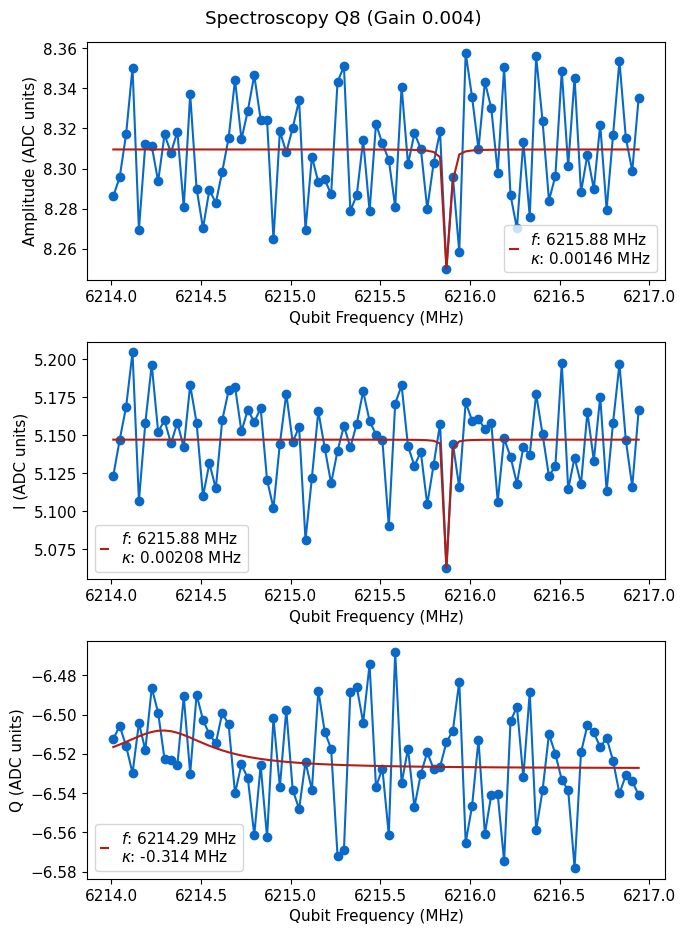

2


  0%|          | 0/1200000 [00:00<?, ?it/s]

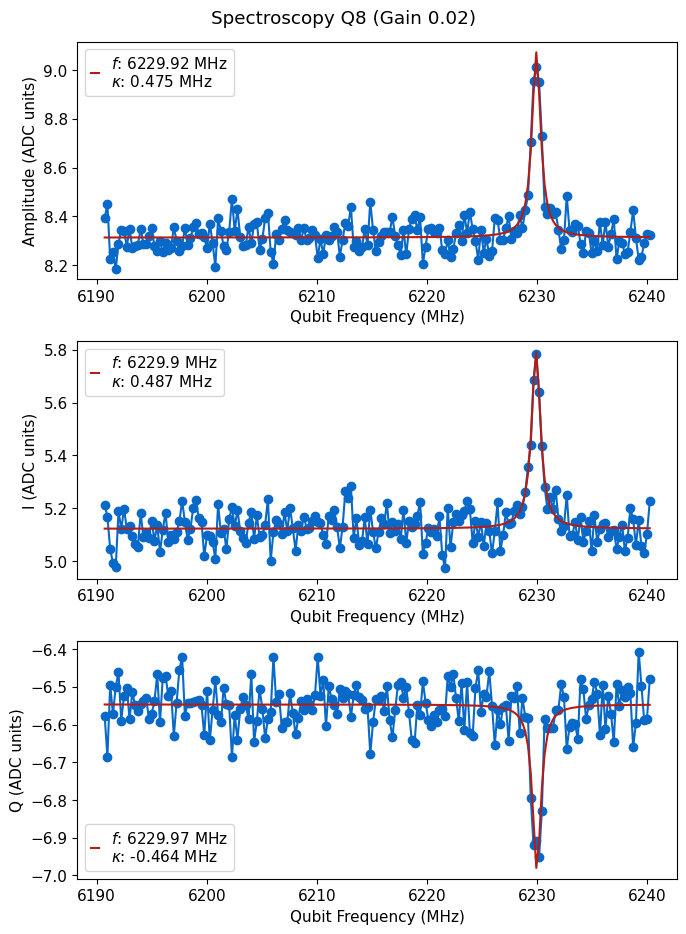

*Set cfg qubit 8 f_ge to 6229.9248 from 6215.4755*
3


  0%|          | 0/1200000 [00:00<?, ?it/s]

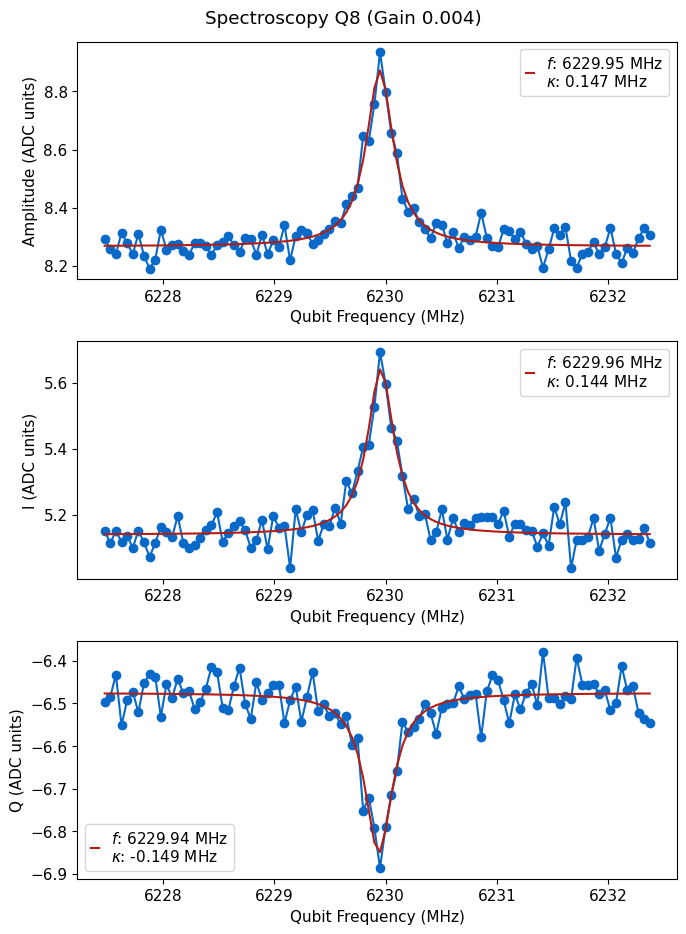

*Set cfg qubit 8 f_ge to 6229.9485 from 6229.9248*
Found qubit 8


  0%|          | 0/360000 [00:00<?, ?it/s]

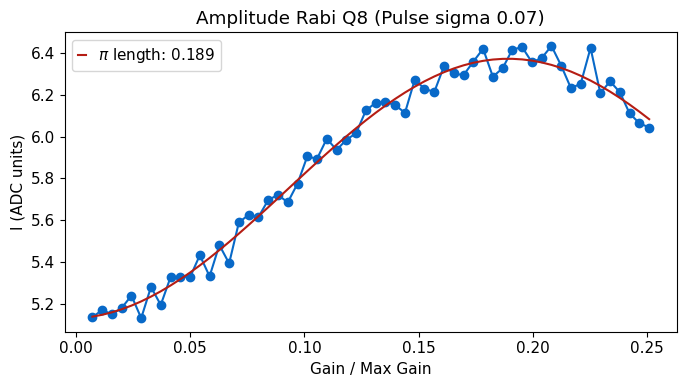

*Set cfg qubit 8 ('pulses', 'pi_ge', 'gain') to 0.1892 from 0.0511*
Try 0


  0%|          | 0/1200000 [00:00<?, ?it/s]

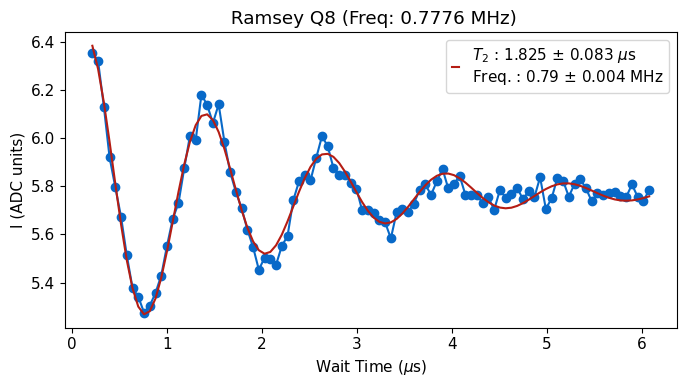

Scan successful. New frequency error is -0.012 MHz
*Set cfg qubit 8 f_ge to 6229.9363 from 6229.9485*
*Set cfg qubit 8 T2r to 1.8249 from 2.02*
Total Change in frequency: -0.012 MHz
[-0.012248669486597197]
Qubit 8 recentered from 6229.9485 to 6229.9363


  0%|          | 0/360000 [00:00<?, ?it/s]

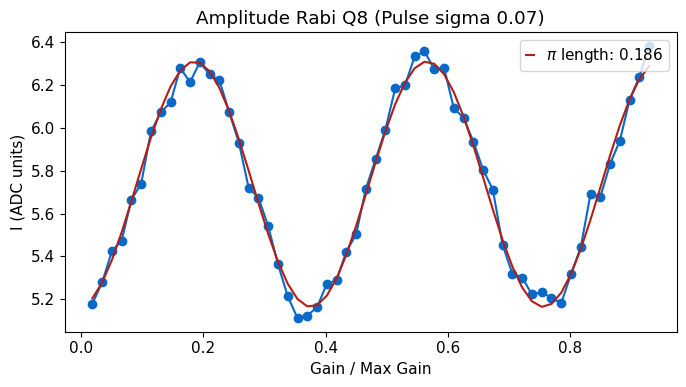

*Set cfg qubit 8 ('pulses', 'pi_ge', 'gain') to 0.1861 from 0.1892*
Unexpected parameters found in params: {'step_len', 'step_gain', 'step_f'}


  0%|          | 0/5 [00:00<?, ?it/s]

Max fidelity 15.635 %
Optimal params: 
 Freq (MHz) 3022.455 
 Gain (DAC units) 0.526 
 Readout length (us) 2.326
Set fidelity: 14.855 %
Set params: 
 Freq (MHz) 3022.455 
 Gain (DAC units) 0.526 
 Readout length (us) 2.114


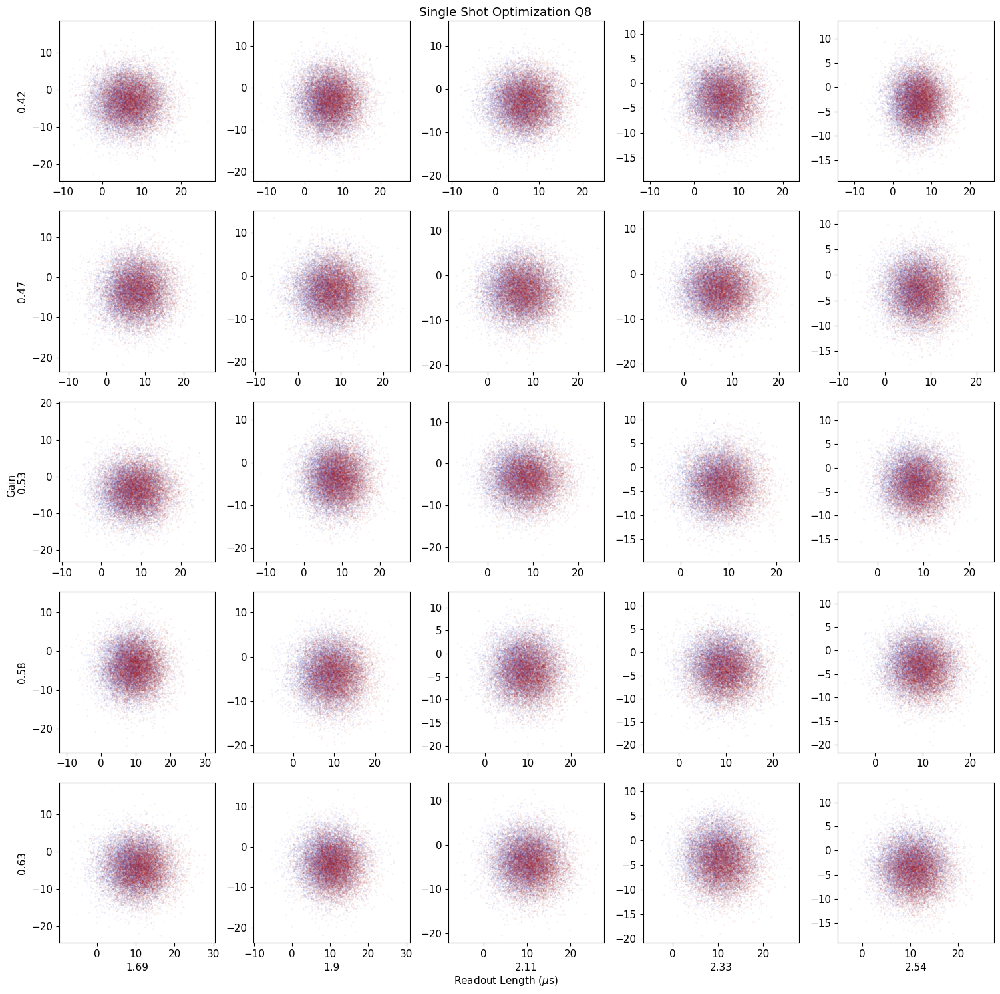

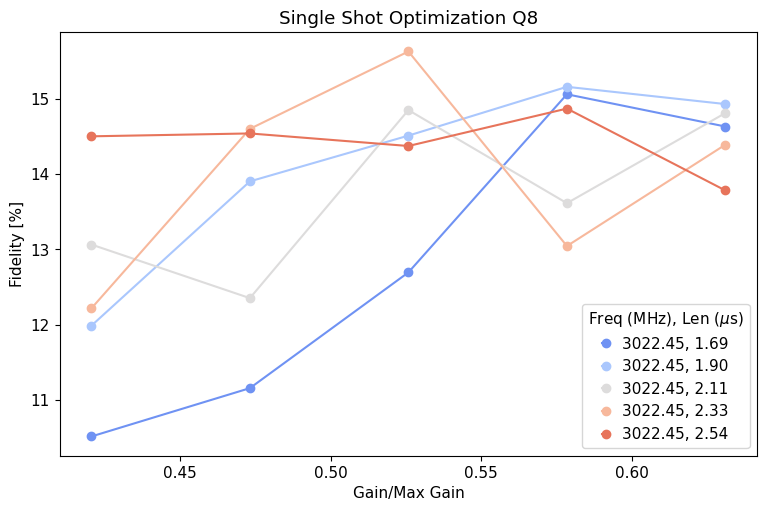

*Set cfg readout 8 gain to 0.5258 from 0.5258*
*Set cfg readout 8 readout_length to 2.1142 from 2.1142*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

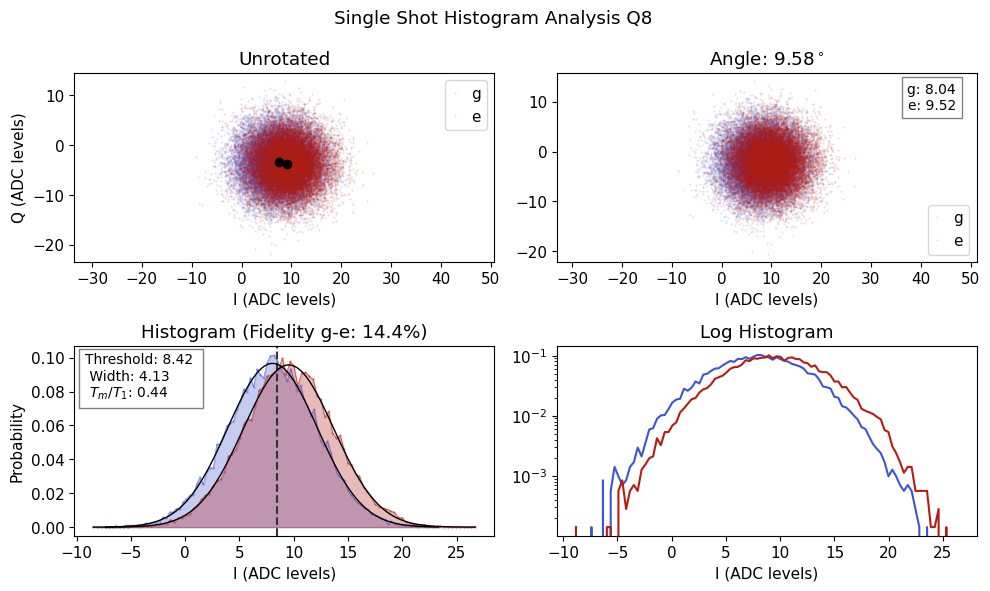

ge Fidelity (%): 14.416
Rotation angle (deg): 9.584
Threshold ge: 8.424
*Set cfg readout 8 phase to 9.584 from -27.2161*
*Set cfg readout 8 threshold to 8.4245 from 1.3043*
*Set cfg readout 8 fidelity to 0.1442 from 0.005*
*Set cfg readout 8 sigma to 4.1262 from 4.0794*
*Set cfg readout 8 tm to 0.4378 from -0.0237*


  0%|          | 0/1200000 [00:00<?, ?it/s]

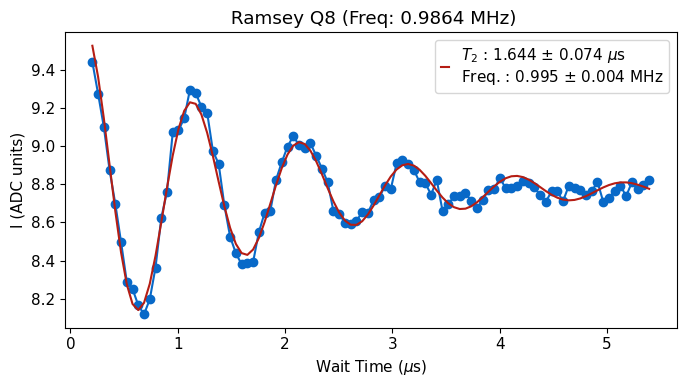

*Set cfg qubit 8 T2r to 1.64 from 1.8249*


  0%|          | 0/720000 [00:00<?, ?it/s]

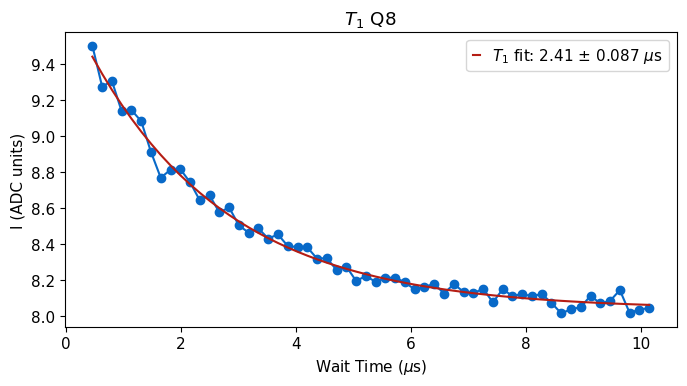

*Set cfg qubit 8 T1 to 2.41 from 2.72*
*Set cfg readout 8 final_delay to 14.49 from 16.31*


  0%|          | 0/1200000 [00:00<?, ?it/s]

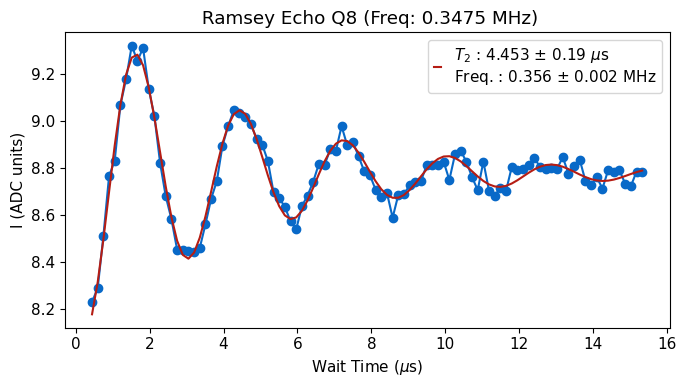

*Set cfg qubit 8 T2e to 4.45 from 5.18*


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

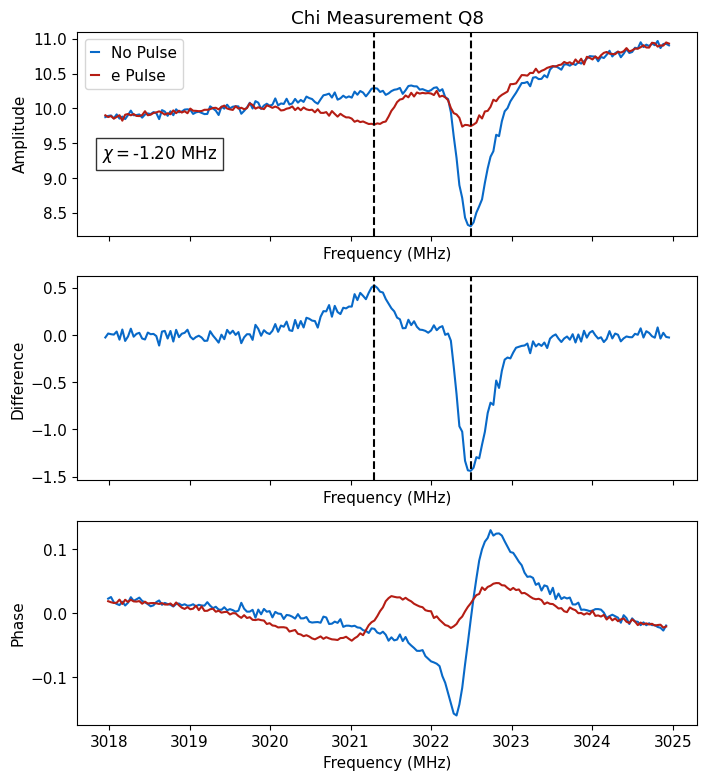

*Set cfg readout 8 chi to -1.1958 from -1.1254*


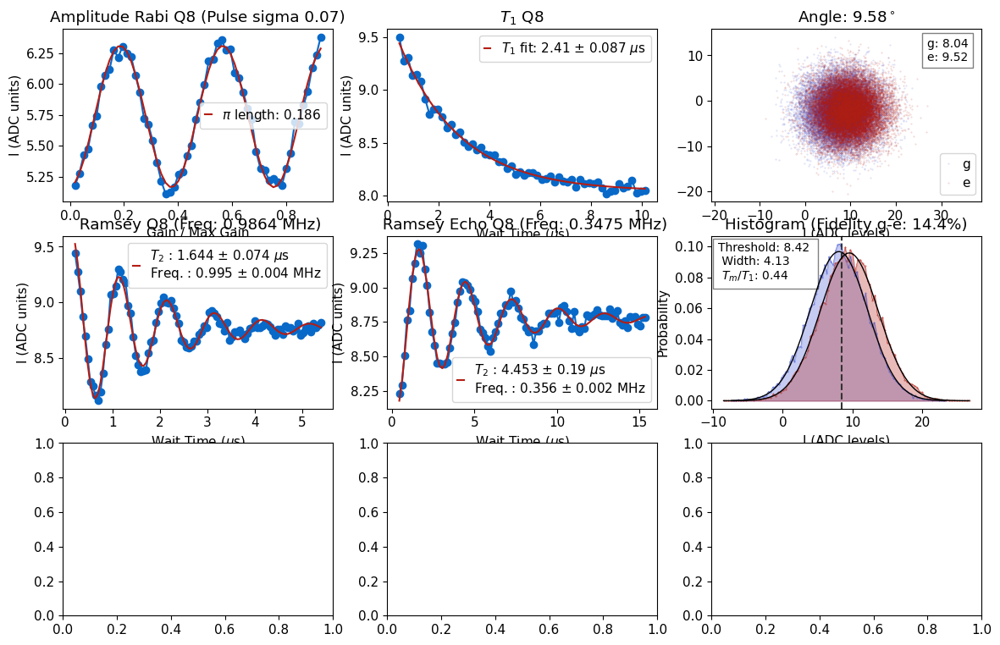

ge Fidelity (%): 14.416
Rotation angle (deg): 9.584
Threshold ge: 8.424
C:\_Data\LLotsa\Tracking\16.0hrs_2025_03_14_10_24images\summary\qubit8_tuneup_20250314_1032.png
Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "c:\Users\slab\anaconda3\envs\slab\lib\site-packages\IPython\core\interactiveshell.py", line 3508, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "C:\Users\slab\AppData\Local\Temp\ipykernel_14744\4164912889.py", line 7, in <module>
    qubit_tuning.tune_up_qubit(qi, cfg_dict, first_time=False, single=True, readout = True)
  File "c:\_Lib\python\slab_qick_calib\calib\qubit_tuning.py", line 120, in tune_up_qubit
    make_summary_figure(cfg_dict, progs, qi)
  File "c:\_Lib\python\slab_qick_calib\calib\qubit_tuning.py", line 312, in make_summary_figure
    fig.savefig(fname)
  File "c:\Users\slab\anaconda3\envs\slab\lib\site-packages\matplotlib\figure.py", line 3378, in savefig
    self.canvas.print_figure(fname, **kwargs)
  File "c:\Users\slab\anaconda3\envs\slab\lib\site-packages\matplotlib\backend_bases.py", line 2366, in print_figure
    result = print_method(
  File "c:\Users\slab\anaconda3\envs\slab\lib\site-packages

In [26]:
qubit_list = np.arange(1)
#qubit_list=np.delete(qubit_list, [5])
# Worst issue with this right now is when the qubit frequency is not correct and readout is bad; gets stuck doing ramsey/spectroscopy forever. In this case, cancel it and go back to find qubits, try changing readout gain. 
qubit_list = [8]
plt.rcParams.update({'font.size': 11})
for qi in qubit_list: 
    qubit_tuning.tune_up_qubit(qi, cfg_dict, first_time=False, single=True, readout = True)

## Set number of reps

In [23]:
max_inc = 15 # dont' let it do more than 15x standard number of reps sot hat thtings don't take forever
auto_cfg = config.load(cfg_path)
qubit_list = [6,7,8,9]
#qubit_list = np.arange(20)
for qi in qubit_list:
    config.update_readout(cfg_path, 'reps', 1/auto_cfg['device']['readout']['fidelity'][qi]**1.6, qi, rng_vals=[1,max_inc]);

*Set cfg readout 6 reps to 2.2082 from 2.1035*
*Set cfg readout 7 reps to 11.5002 from 15*
Val is out of range, setting to max
*Set cfg readout 8 reps to 15 from 15*
*Set cfg readout 9 reps to 5.4209 from 9.0502*


## Time tracking

Starting run 0, for qubit 8. Time elapsed 0.00 hrs
Starting run 1, for qubit 8. Time elapsed 0.01 hrs
Starting run 2, for qubit 8. Time elapsed 0.03 hrs
Starting run 3, for qubit 8. Time elapsed 0.04 hrs
Starting run 4, for qubit 8. Time elapsed 0.06 hrs
Starting run 5, for qubit 8. Time elapsed 0.07 hrs
Starting run 6, for qubit 8. Time elapsed 0.09 hrs
Starting run 7, for qubit 8. Time elapsed 0.10 hrs
Starting run 8, for qubit 8. Time elapsed 0.12 hrs
Starting run 9, for qubit 8. Time elapsed 0.13 hrs
Starting run 10, for qubit 8. Time elapsed 0.15 hrs
Starting run 11, for qubit 8. Time elapsed 0.16 hrs
Starting run 12, for qubit 8. Time elapsed 0.18 hrs
Starting run 13, for qubit 8. Time elapsed 0.19 hrs
Val is out of range, setting to min
Starting run 14, for qubit 8. Time elapsed 0.20 hrs
Starting run 15, for qubit 8. Time elapsed 0.22 hrs
Val is out of range, setting to min
Starting run 16, for qubit 8. Time elapsed 0.23 hrs
Val is out of range, setting to min
Starting run 17, f

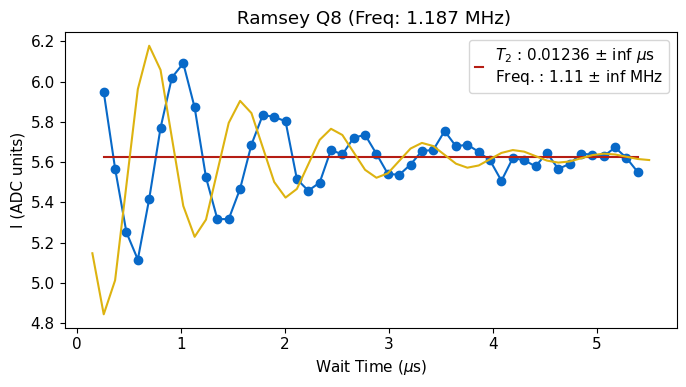

Refitting
[0.9744157678479715, 1.1438297872340422, 151.1027767102621, 1.2840634300595235, 5.623753092364321]


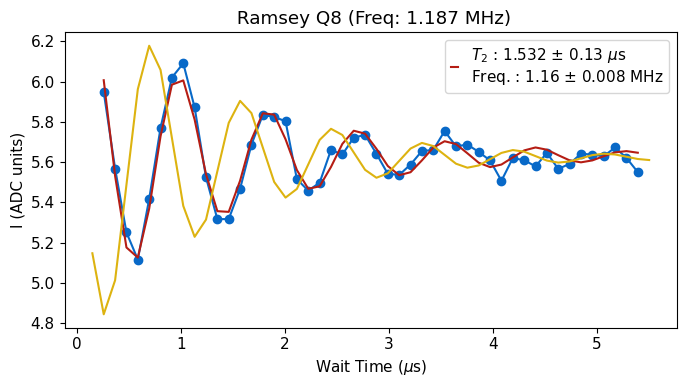

0.9301796677780552
[0.07206716 0.00715426 0.10186062 0.08618136 0.00127953]
2


  0%|          | 0/1200000 [00:00<?, ?it/s]

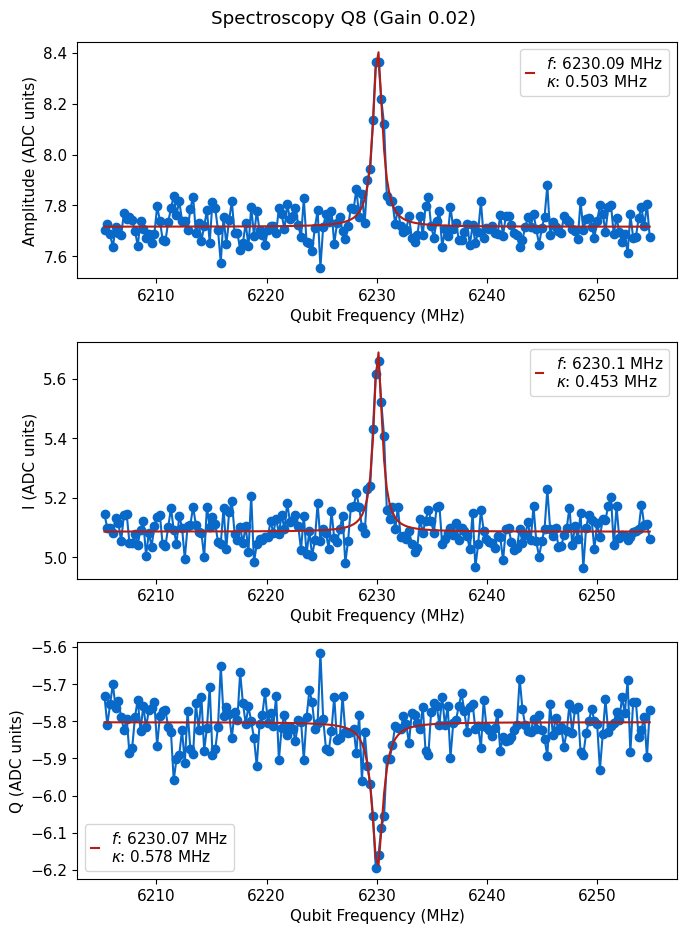

*Set cfg qubit 8 f_ge to 6230.0855 from 6230.0339*
3


  0%|          | 0/1200000 [00:00<?, ?it/s]

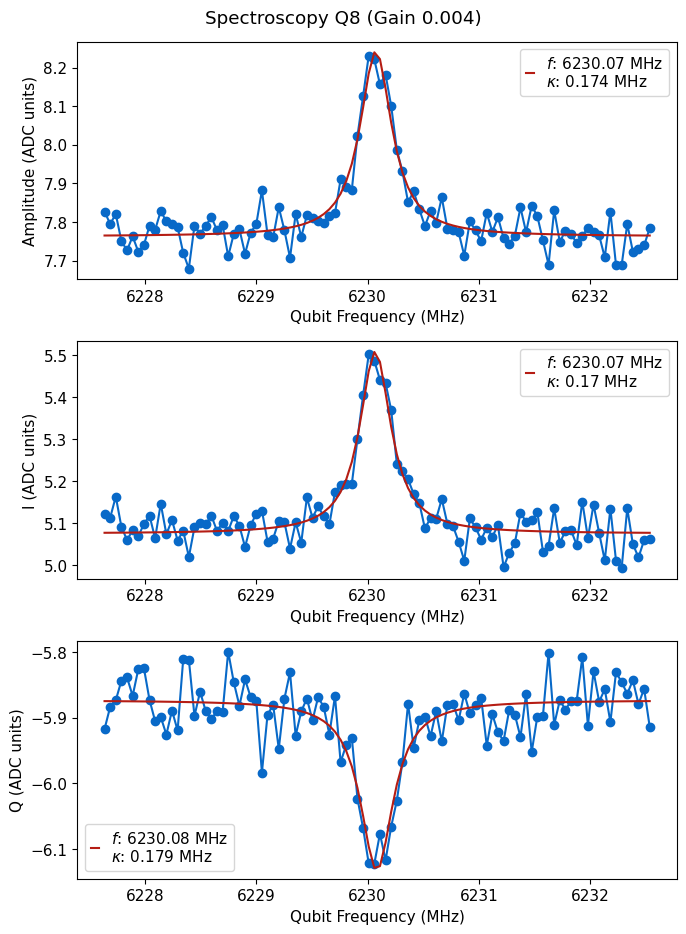

*Set cfg qubit 8 f_ge to 6230.074 from 6230.0855*
Found qubit 8
Recentered qubit frequency
Starting run 72, for qubit 8. Time elapsed 1.08 hrs
Val is out of range, setting to min
Starting run 73, for qubit 8. Time elapsed 1.10 hrs
Starting run 74, for qubit 8. Time elapsed 1.11 hrs


In [ ]:
cfg_dict['expt_path']=expt_path
#qubit_list = np.arange(20)
#bad_qubits = [5]
qubit_list = [8]

#qubit_list = np.delete(qubit_list, bad_qubits)

tt=qubit_tuning.time_tracking(qubit_list, cfg_dict,total_time=16)
cfg_dict['expt_path']=expt_path

Starting run 0, for qubit 4. Time elapsed 0.00 hrs
Starting run 1, for qubit 4. Time elapsed 0.00 hrs
Starting run 2, for qubit 4. Time elapsed 0.01 hrs
Starting run 3, for qubit 4. Time elapsed 0.01 hrs
Starting run 4, for qubit 4. Time elapsed 0.02 hrs
Starting run 5, for qubit 4. Time elapsed 0.02 hrs
Starting run 6, for qubit 4. Time elapsed 0.03 hrs
Starting run 7, for qubit 4. Time elapsed 0.03 hrs
Starting run 8, for qubit 4. Time elapsed 0.03 hrs


c:\_Lib\python\slab_qick_calib\fitting.py:90: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-x/decay)


Starting run 9, for qubit 4. Time elapsed 0.04 hrs
Starting run 10, for qubit 4. Time elapsed 0.04 hrs
Starting run 11, for qubit 4. Time elapsed 0.05 hrs
Starting run 12, for qubit 4. Time elapsed 0.05 hrs
Starting run 13, for qubit 4. Time elapsed 0.06 hrs
Starting run 14, for qubit 4. Time elapsed 0.06 hrs
Starting run 15, for qubit 4. Time elapsed 0.06 hrs
Starting run 16, for qubit 4. Time elapsed 0.07 hrs
Starting run 17, for qubit 4. Time elapsed 0.07 hrs
Starting run 18, for qubit 4. Time elapsed 0.08 hrs
Starting run 19, for qubit 4. Time elapsed 0.08 hrs
Starting run 20, for qubit 4. Time elapsed 0.09 hrs
Starting run 21, for qubit 4. Time elapsed 0.09 hrs
Starting run 22, for qubit 4. Time elapsed 0.09 hrs
Starting run 23, for qubit 4. Time elapsed 0.10 hrs
Starting run 24, for qubit 4. Time elapsed 0.10 hrs
Starting run 25, for qubit 4. Time elapsed 0.11 hrs
Starting run 26, for qubit 4. Time elapsed 0.11 hrs
Starting run 27, for qubit 4. Time elapsed 0.12 hrs
Starting run 

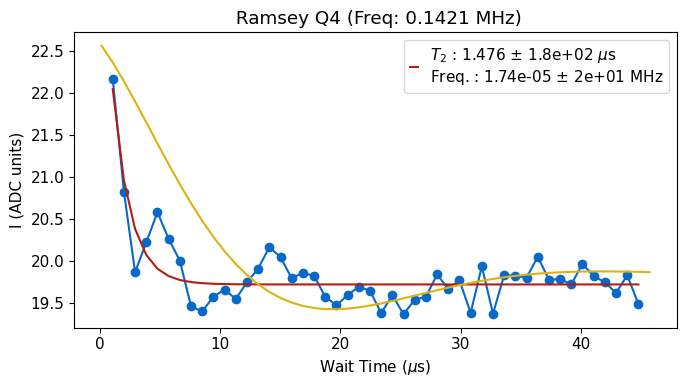

0.7253967688924462
[1.71803684e+05 8.95620119e+05 6.28343460e+05 1.22897034e+02
 1.99923346e-03 5.93070894e+05]
2


  0%|          | 0/73000 [00:00<?, ?it/s]

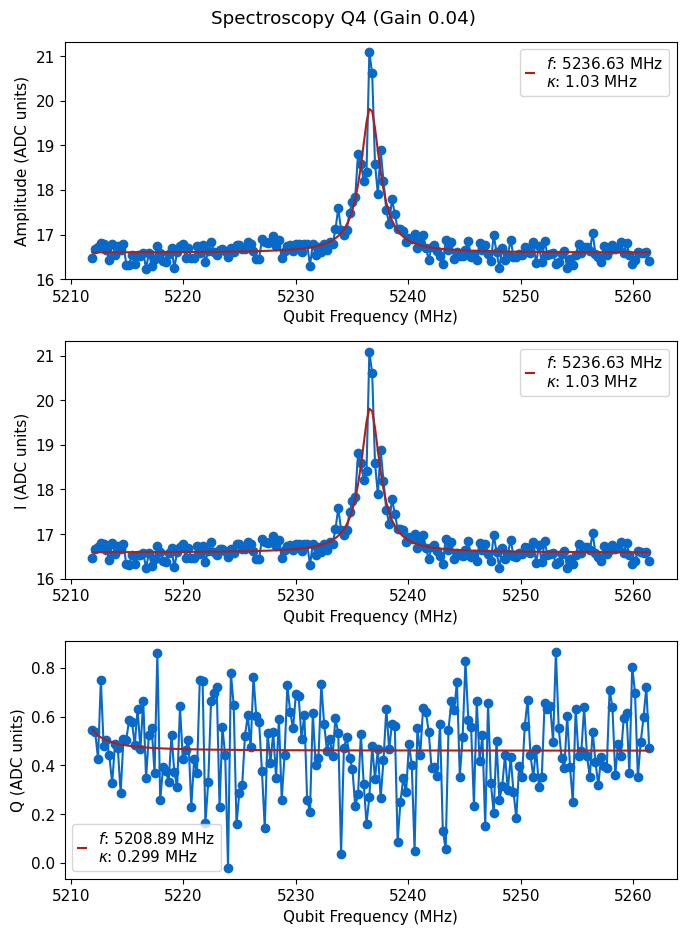

*Set cfg qubit 4 f_ge to 5236.6298 from 5236.6675*
3


  0%|          | 0/73000 [00:00<?, ?it/s]

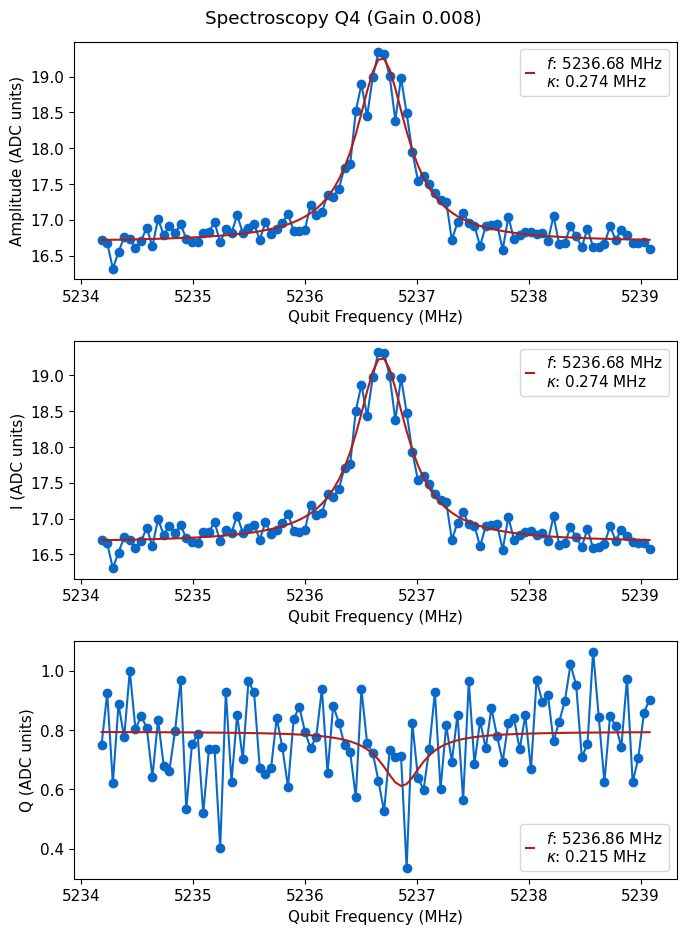

*Set cfg qubit 4 f_ge to 5236.6839 from 5236.6298*
Found qubit 4
Recentered qubit frequency
Starting run 340, for qubit 4. Time elapsed 1.47 hrs
Starting run 341, for qubit 4. Time elapsed 1.47 hrs
Starting run 342, for qubit 4. Time elapsed 1.48 hrs
Starting run 343, for qubit 4. Time elapsed 1.48 hrs
Starting run 344, for qubit 4. Time elapsed 1.48 hrs
Starting run 345, for qubit 4. Time elapsed 1.49 hrs
Starting run 346, for qubit 4. Time elapsed 1.49 hrs
Starting run 347, for qubit 4. Time elapsed 1.50 hrs
Starting run 348, for qubit 4. Time elapsed 1.50 hrs
Starting run 349, for qubit 4. Time elapsed 1.51 hrs
Starting run 350, for qubit 4. Time elapsed 1.51 hrs
Starting run 351, for qubit 4. Time elapsed 1.51 hrs
Starting run 352, for qubit 4. Time elapsed 1.52 hrs
Starting run 353, for qubit 4. Time elapsed 1.52 hrs
Starting run 354, for qubit 4. Time elapsed 1.53 hrs
Starting run 355, for qubit 4. Time elapsed 1.53 hrs
Starting run 356, for qubit 4. Time elapsed 1.54 hrs
Startin

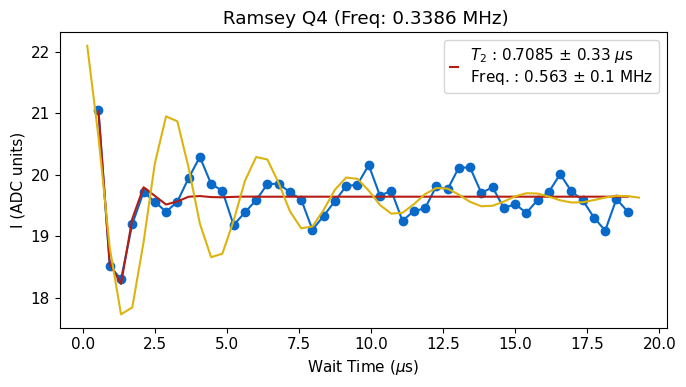

0.6195191890925085
[ 6.68123778e-01  2.14690343e-01  3.28624921e+01  4.65453092e-01
  2.15561842e-03 -7.63831822e-01]
2


  0%|          | 0/73000 [00:00<?, ?it/s]

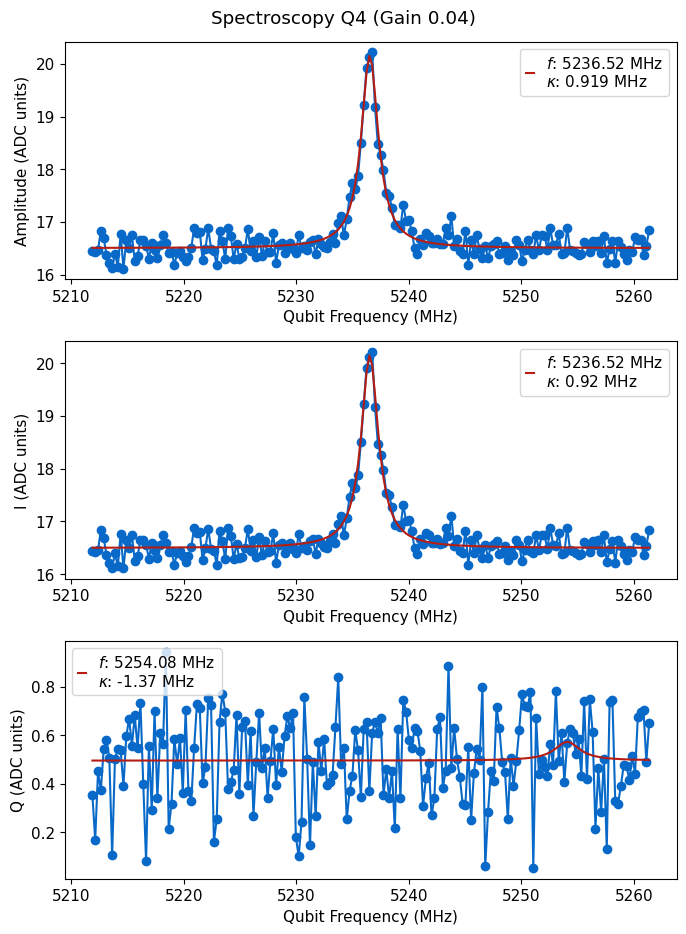

*Set cfg qubit 4 f_ge to 5236.5247 from 5236.612*
3


  0%|          | 0/73000 [00:00<?, ?it/s]

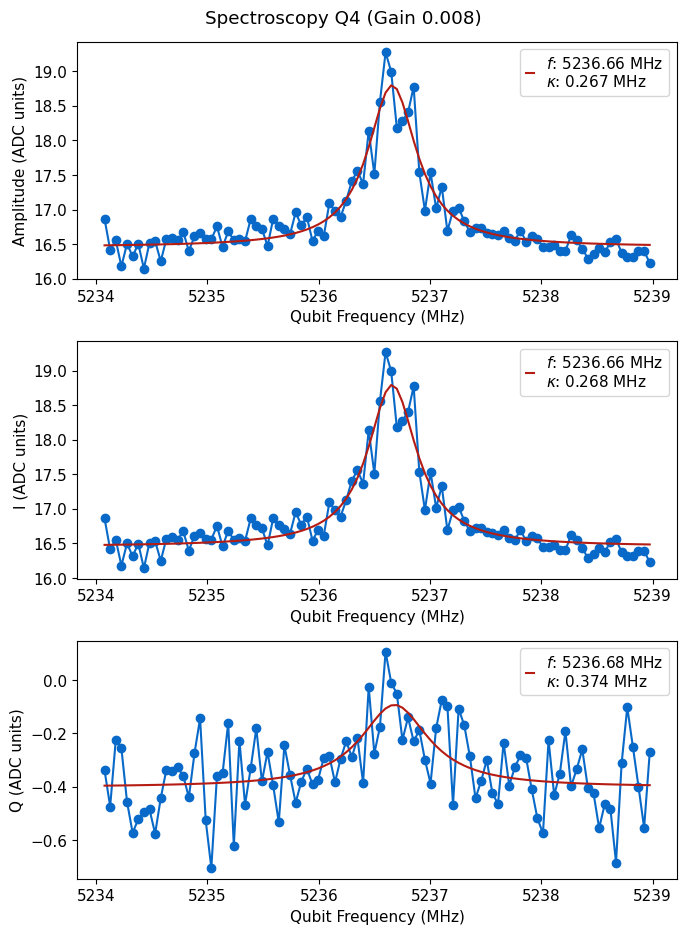

*Set cfg qubit 4 f_ge to 5236.6594 from 5236.5247*
Found qubit 4
Val is out of range, setting to min
Recentered qubit frequency
Starting run 3675, for qubit 4. Time elapsed 14.19 hrs
Starting run 3676, for qubit 4. Time elapsed 14.19 hrs
Starting run 3677, for qubit 4. Time elapsed 14.19 hrs
Starting run 3678, for qubit 4. Time elapsed 14.20 hrs
Starting run 3679, for qubit 4. Time elapsed 14.20 hrs
Starting run 3680, for qubit 4. Time elapsed 14.21 hrs
Starting run 3681, for qubit 4. Time elapsed 14.21 hrs
Starting run 3682, for qubit 4. Time elapsed 14.22 hrs
Starting run 3683, for qubit 4. Time elapsed 14.22 hrs
Starting run 3684, for qubit 4. Time elapsed 14.23 hrs
Starting run 3685, for qubit 4. Time elapsed 14.23 hrs
Starting run 3686, for qubit 4. Time elapsed 14.23 hrs
Starting run 3687, for qubit 4. Time elapsed 14.24 hrs
Starting run 3688, for qubit 4. Time elapsed 14.24 hrs
Starting run 3689, for qubit 4. Time elapsed 14.25 hrs
Starting run 3690, for qubit 4. Time elapsed 14

In [7]:
cfg_dict['expt_path']=expt_path
#qubit_list = np.arange(20)
#bad_qubits = [5]
qubit_list = [4]
#qubit_list = np.delete(qubit_list, bad_qubits)

tt=qubit_tuning.time_tracking(qubit_list, cfg_dict,total_time=16)
cfg_dict['expt_path']=expt_path

Text(0.5, 1.0, 'Histogram of T1 Means Across Qubits')

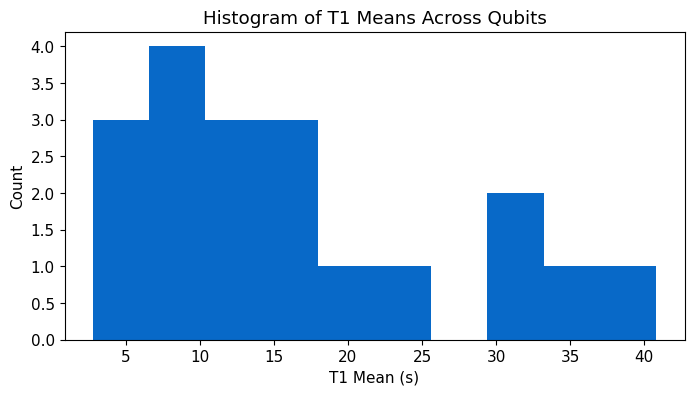

In [136]:
import pandas as pd
import tkinter as tk
from tkinter import filedialog

# Create and hide the main tkinter window
root = tk.Tk()
root.withdraw()

# Open the file dialog
filename = filedialog.askopenfilename(
    title="Select a file",
    filetypes=(
        ("CSV files", "*.csv"),
        ("All files", "*.*")
    )
)
# Basic reading
df = pd.read_csv('filename.csv')


Text(0.5, 1.0, 'Histogram of T1 Means Across Qubits')

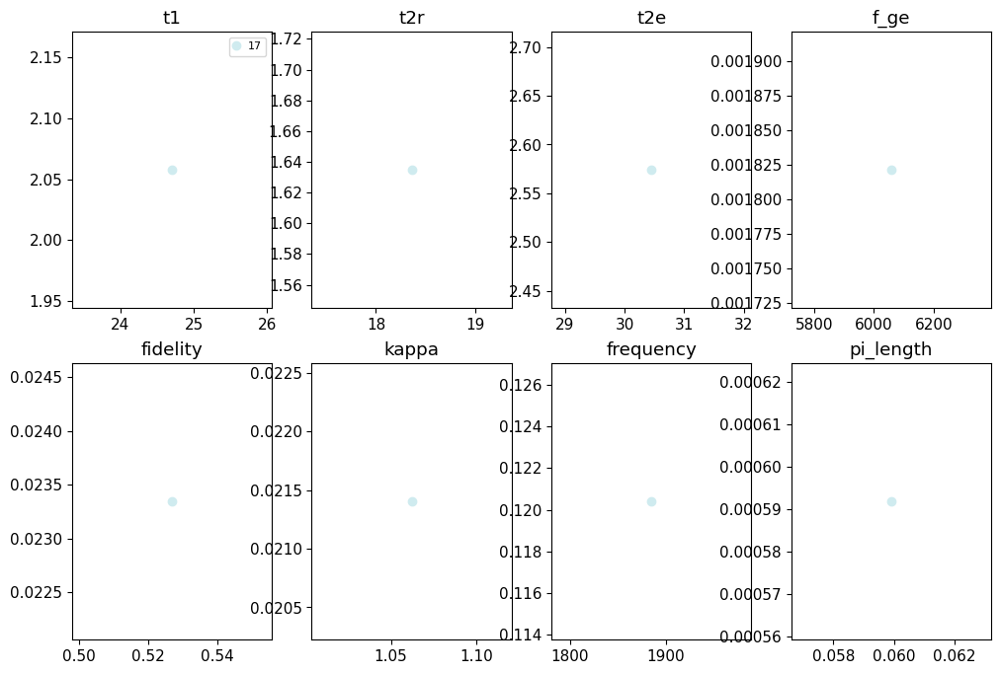

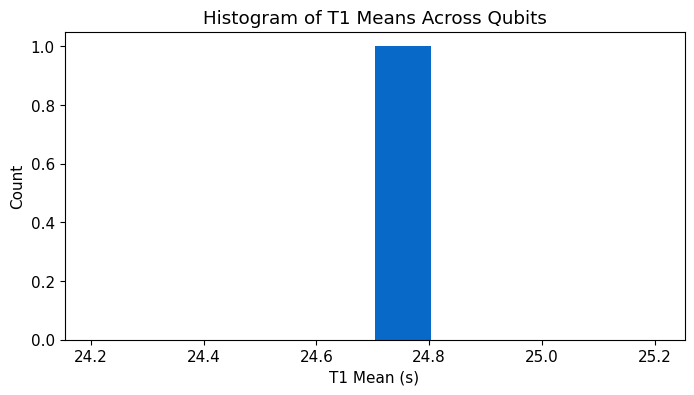

In [543]:
ss=sns.cubehelix_palette(start=.5, rot=-.75, as_cmap=True)

ss=sns.color_palette('cubehelix', (np.max(qubit_list)+1)%10)
b = {}
for key in tt[0].keys():
    for j, qi in enumerate(qubit_list): 
        if j==0: 
            b[key+'_mn']=np.zeros(len(qubit_list))
            b[key+'_std']=np.zeros(len(qubit_list))

        b[key+'_mn'][j]=np.nanmean(tt[j][key])
        b[key+'_std'][j]=np.nanstd(tt[j][key])

i=0
fig, ax = plt.subplots(2,4, figsize=(12,8))
ax=ax.flatten()
%matplotlib inline

for key in ['t1', 't2r', 't2e', 'f_ge', 'fidelity', 'kappa', 'frequency', 'pi_length']:
        for j, qi in enumerate(qubit_list):
            ax[i].plot(b[key+'_mn'][j], b[key+'_std'][j],'o', color=ss[qi%10], label=qi)
        ax[i].set_title(key)
        i=i+1

ax[0].legend(fontsize=8, ncols=3)
#fig.tight_layout()

plt.figure()
plt.hist(b['t1_mn'])
plt.xlabel('T1 Mean (s)')
plt.ylabel('Count')
plt.title('Histogram of T1 Means Across Qubits')


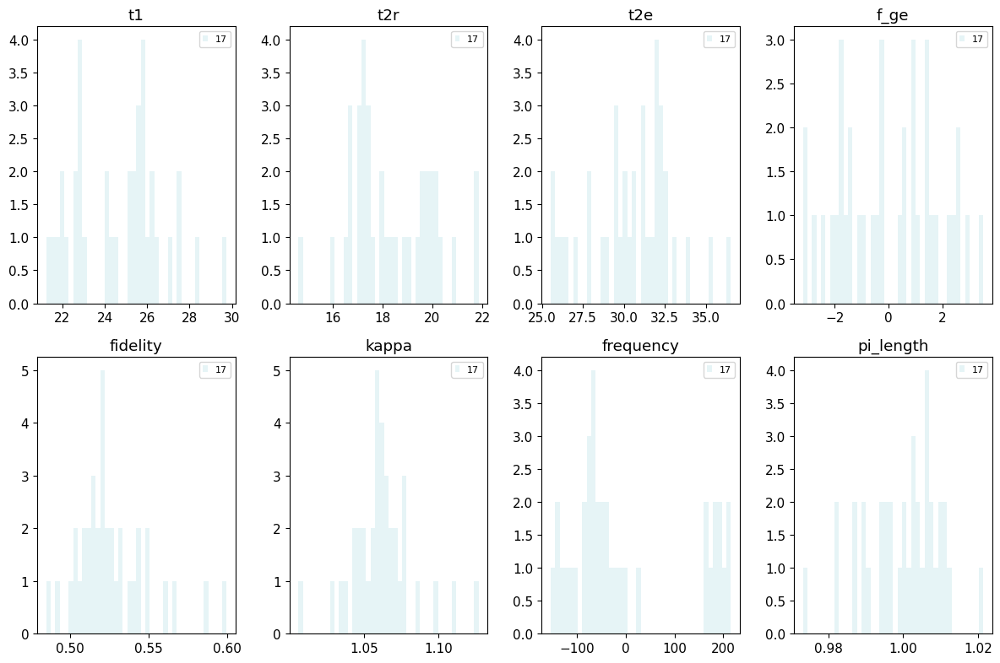

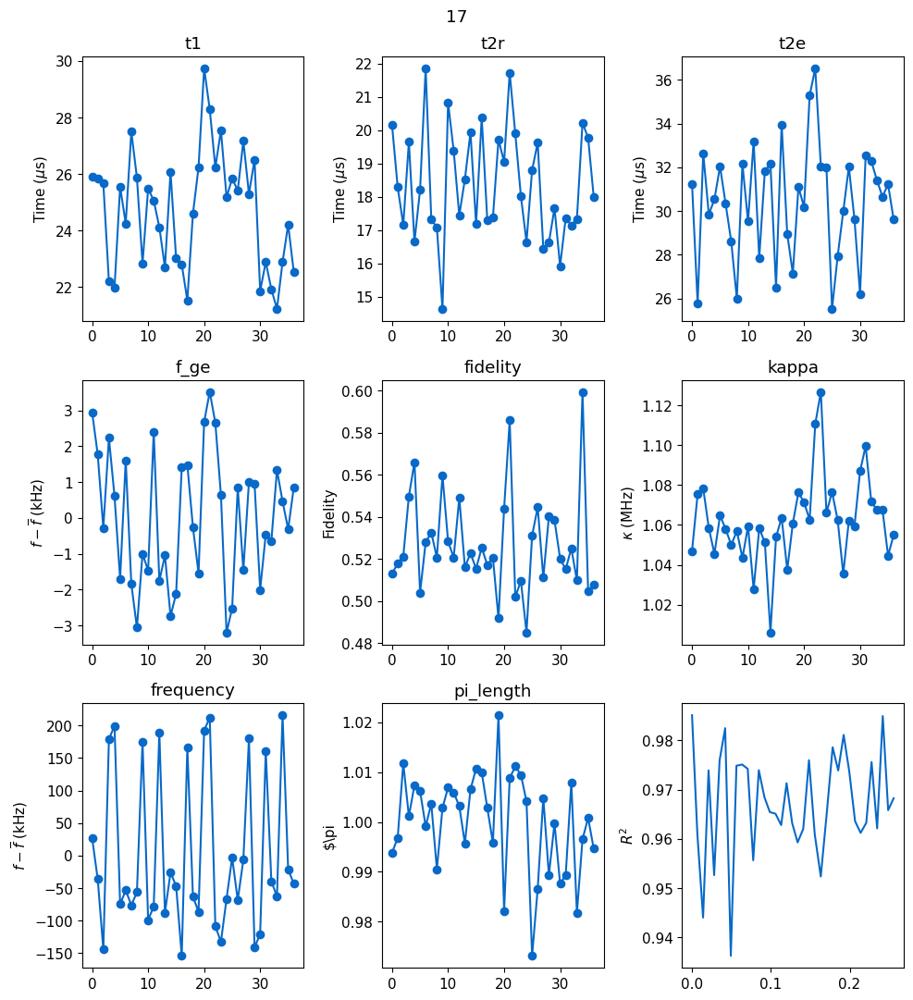

In [544]:
fig2, ax2 = plt.subplots(2,4, figsize=(12,8))
ax2=ax2.flatten()

for j, qi in enumerate(qubit_list):
    fig, ax = plt.subplots(3,3, figsize=(10,11))
    ax=ax.flatten()
    fig.suptitle(qi)
    i=0
    for k, key in enumerate(['t1', 't2r', 't2e', 'f_ge', 'fidelity', 'kappa', 'frequency', 'pi_length']):
        r2_scan = ['t1_r2', 't2r_r2', 't2e_r2','t2r_r2', None, 'rspec_r2', 'rspec_r2', 'amp_rabi_r2']
        # Remove outliers, those with values far away from mean or small r^2
        if r2_scan[k] is not None: 
            #inds = np.array(tt[j][r2_scan[k]])>0.8
            inds = tt[j][r2_scan[k]]>np.nanmean(np.array(tt[j][r2_scan[k]]))-0.08 #
            
            inds2 = np.abs(tt[j][key]-np.mean(tt[j][key]))<np.std(tt[j][key])*5
            inds = np.logical_and(inds, inds2)
            inds = np.where(inds)[0]
            #print(np.sum(~np.array(inds, dtype=bool)))
            
        else:
            inds = np.arange(len(tt[j][key]))
        if key in ['f_ge', 'frequency']:
            y=1e3*(tt[j][key]-np.nanmean(tt[j][key]))
            ylab = '$f-\overline{f}$ (kHz)'
        elif key in ['pi_length']:
            y=tt[j][key]/np.nanmean(tt[j][key])
            ylab = '$\pi'
        else:
            y = tt[j][key]  
        if key in ['t1','t2r','t2e']:
            ylab = 'Time ($\mu$s)'
        elif key=='kappa':
            ylab = '$\kappa$ (MHz)'
        elif key=='fidelity':
            ylab = 'Fidelity'
        ax[i].plot(np.array(y)[inds], 'o-')
        std_val = np.std(y)
        ax[i].set_title(key)
        ax2[i].hist(np.array(y)[inds], bins=40, alpha=0.5, label=qi, color=ss[qi%10])
        ax2[i].set_title(key)
        ax[i].set_ylabel(ylab)
        i+=1
    ax[-1].plot(tt[j]['elapsed'],tt[j]['t2r_r2'])
    ax[-1].set_ylabel('$R^2$')
    fig.tight_layout()

for a in ax2:
    a.legend(fontsize=8, ncols=2)
fig2.tight_layout()

In [148]:
tt[0]['f_ge']-np.nanmean(tt[0]['f_ge'])

array([-0.110531,  1.180769, -0.111031, -0.109031, -0.108631, -0.110531,
       -0.109031, -0.107531, -0.107931, -0.107531, -0.106631, -0.107131,
       -0.111231, -0.111031, -0.112631, -0.109231, -0.111031, -0.110731,
       -0.109131, -0.113331, -0.137631, -0.109831, -0.109631, -0.111331,
       -0.109231, -0.108831, -0.110931,       nan, -0.111931, -0.110731,
       -0.110531, -0.112331, -0.108531, -0.113631, -0.112831, -0.111931,
       -0.108931, -0.108631,  1.185169, -0.108331, -0.110831, -0.111631,
       -0.108131, -0.109031,  1.209769, -0.111631, -0.110431, -0.112731,
       -0.111931, -0.112631,  1.127569, -0.118331,  1.169169, -0.114431,
       -0.112431, -0.109431, -0.109631, -0.112831, -0.113131, -0.112331,
       -0.117531, -0.112431, -0.111931, -0.112831, -0.112831, -0.110931,
       -0.113431, -0.114731, -0.112831, -0.115231, -0.112231, -0.113131,
       -0.113831, -0.109831, -0.111531, -0.113331, -0.111831,  1.163069,
        1.199569, -0.115631, -0.114931, -0.113931, 

## Check how gain * sigma varies across qubits

In [ ]:
auto_cfg = config.load(cfg_path)
plt.figure()
gain_proxy = np.array(auto_cfg.device.qubit.pulses.pi_ge.gain)*np.array(auto_cfg.device.qubit.pulses.pi_ge.sigma)
gain_proxy1 = gain_proxy[0:10]
gain_proxy2 = gain_proxy[10:]
gain_proxy[gain_proxy>0.1]=np.nan
#plt.plot(np.array(auto_cfg.device.qubit.f_ge)[inds], gain_proxy[inds], 'o')

plt.plot(np.array(auto_cfg.device.qubit.f_ge)[0:10], gain_proxy1, 'o')
plt.plot(np.array(auto_cfg.device.qubit.f_ge)[10:], gain_proxy2, 'o')

## Rabi

### Amplitude

  0%|          | 0/14520 [00:00<?, ?it/s]

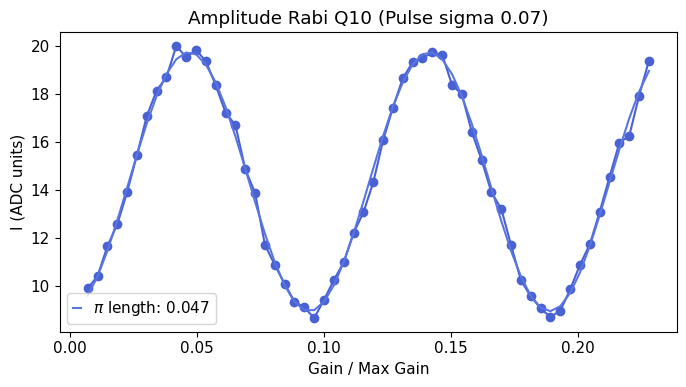

*Set cfg qubit 10 ('pulses', 'pi_ge', 'gain') to 0.0467 from 0.0466*


In [448]:
qubit_list = np.arange(13,20)
qubit_list=[10]
pulse_len = 0.07

update=True

for qi in qubit_list: 
    #config.update_qubit(cfg_path,('pulses','pi_ge','sigma'), pulse_len,qi)
    amp_rabi = meas.RabiExperiment(cfg_dict,qi=qi)
#    amp_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params={'active_reset':True, 'gain':0.25,'freq':4370, 'reps':1000,'soft_avgs':3,'pulse_type':'const','sigma':1})

    if update and amp_rabi.status:
        config.update_qubit(cfg_path, ('pulses','pi_ge','gain'), amp_rabi.data['pi_length'], qi)
        

#### Chevron

Unexpected parameters found in params: {'span_f', 'expts_f'}


  0%|          | 0/30 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_chevron__qubit5_00008.h5


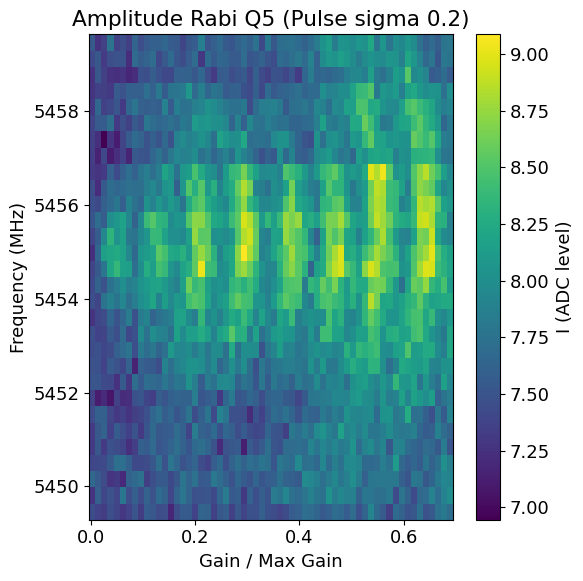

NameError: name 'amp_rabi' is not defined

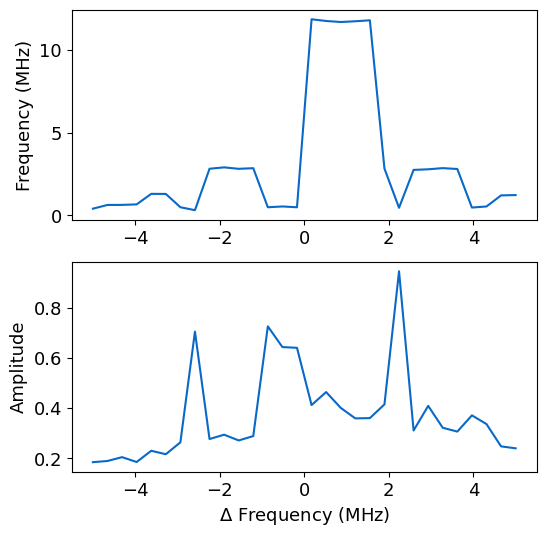

In [4]:
d2=[]
qubit_list = np.arange(18)
# Fix ; doing length rabi by default, plotting error 
qubit_list=[5]
for qi in qubit_list: 
    amp_rabi_chevron = meas.RabiChevronExperiment(cfg_dict,qi=qi, params={'span_f':10})
    d2.append(amp_rabi)
#handy.plot_many(d2, title='Rabi Chevron Phase', save_path=cfg_dict['expt_path'], chan='phases')

#### 2 Qubit Rabi

  0%|          | 0/8940 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


R2:0.990	Fit par error:0.001	 Best fit:b'avgi'
R2:0.753	Fit par error:0.184	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_Q0_Q10_00002.h5


KeyError: 'bin_centers'

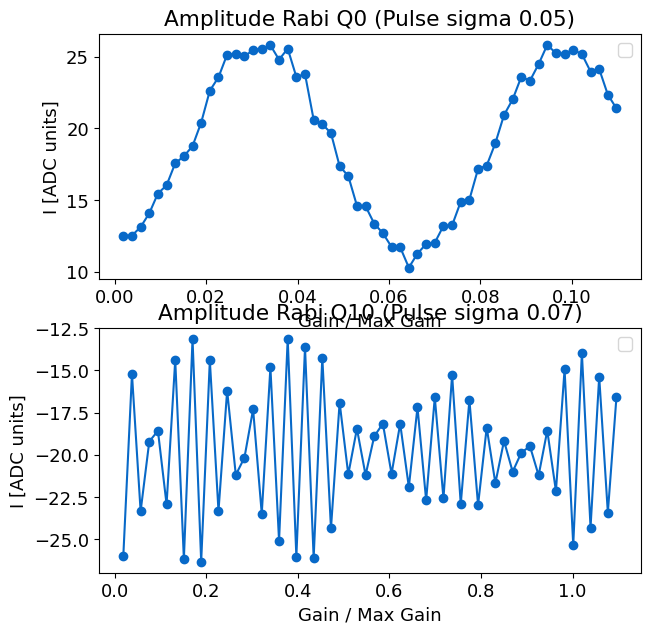

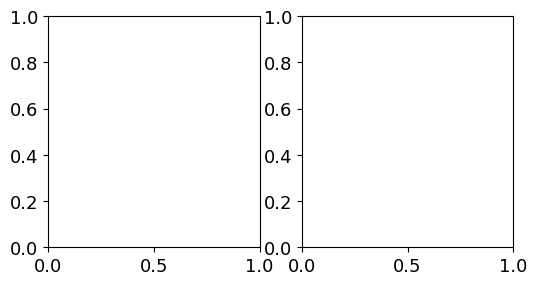

In [9]:
qi=[0,10]
amp_rabi = meas.Rabi_2Q(cfg_dict,qi=qi, params={'active_reset':False})

### Length -- Not working!!

  0%|          | 0/14340 [00:00<?, ?it/s]

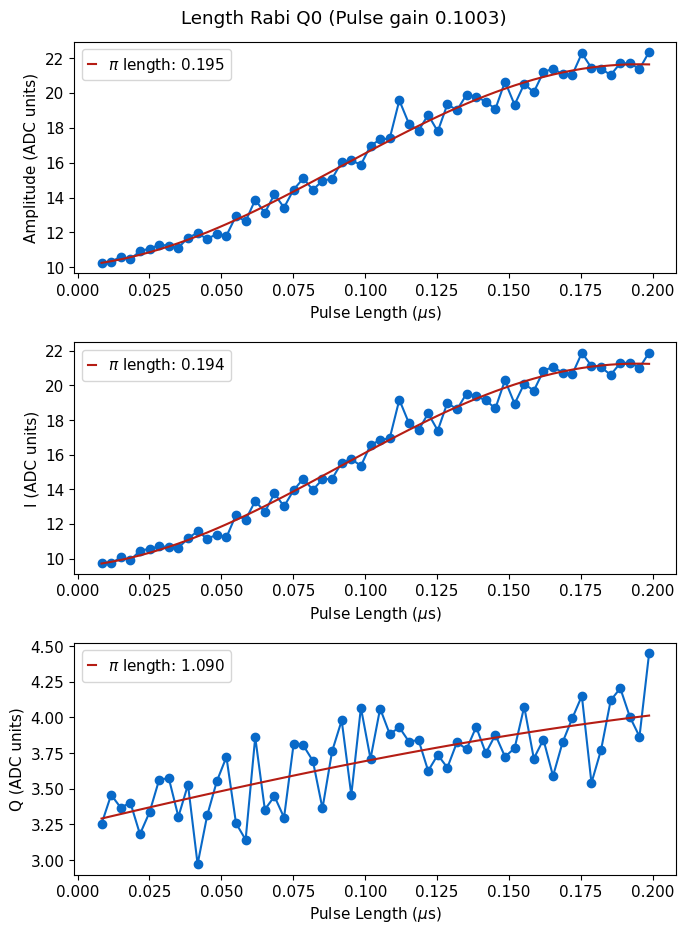

In [416]:
qubit_list = [0]
update=False
# This does not work with gaussian pulses due to multiplying qickparams issues -- need to fix
#qubit_list=[3]
for qi in qubit_list: 
    len_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params={'sweep':'length', 'type':'const', 'sigma':0.05})
    if update and len_rabi.status:
       config.update_qubit(cfg_path, ('pulses','pi_ge','sigma'), len_rabi.data['pi_length'], qi) 
    

#### Chevron

In [188]:
qubit_list = np.arange(20)
#qubit_list=[8]
for qi in qubit_list: 
    len_rabi = meas.RabiChevronExperiment(cfg_dict,qi=qi, params={'sweep':'length',"type":"const", 'sigma':0.205, 'expts_f':60, 'span_f':150, 'gain':0.4,'start_f':6280,'soft_avgs':4})

Unexpected parameters found in params: {'start_f', 'span_f', 'expts_f'}


  0%|          | 0/60 [00:00<?, ?it/s]

KeyboardInterrupt: 

## Ramsey

  0%|          | 0/73000 [00:00<?, ?it/s]

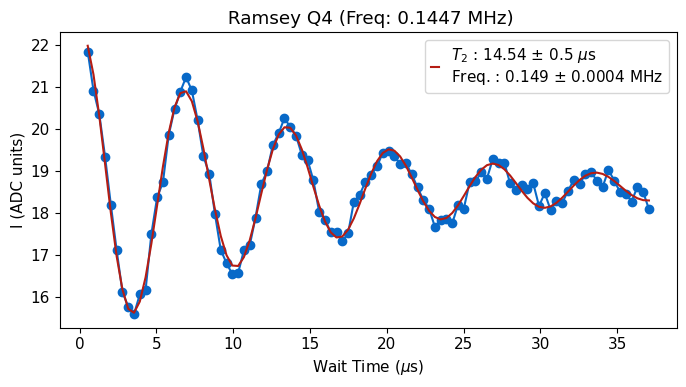

T2 Ramsey fit failed


In [5]:
step = soc.cycles2us(1)
span = 40
expts = min(int(span/step),100)
qubit_list=[4]
update = False
for qi in qubit_list:
    t2r = meas.T2Experiment(cfg_dict, qi=qi, max_err=10)
    # t2r = meas.T2Experiment(cfg_dict, qi=qi, max_err=10, params = {'ramsey_freq':1.0,'expts':expts, 'span':0.5,'start':0.01})
    if t2r.status and update:
        config.update_qubit(cfg_path, 'f_ge', t2r.data['new_freq'], qi)
        auto_cfg = config.update_qubit(cfg_path, 'T2r', t2r.data['best_fit'][3], qi, rng_vals=[1.5, max_t1], sig=2)
    else:
        print('T2 Ramsey fit failed')

[7.030793337882578, 0.018556327393536694, 98.90134394881176, 26.670038132440474, 11.293179742137205, 0]


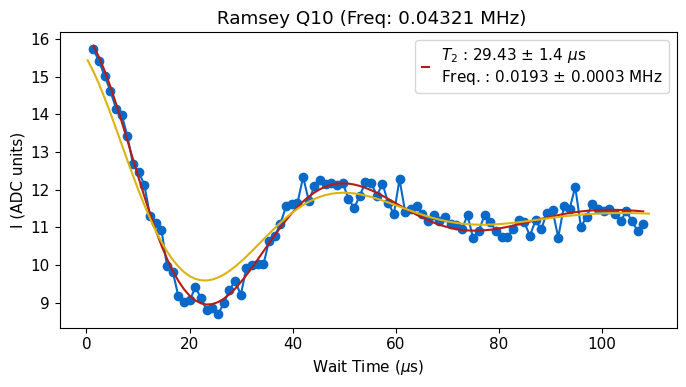

In [580]:
t2r.display(debug=True)

  0%|          | 0/25100 [00:00<?, ?it/s]

Possible errors are -0.003 and 0.123 for Ramsey frequency 0.060 MHz


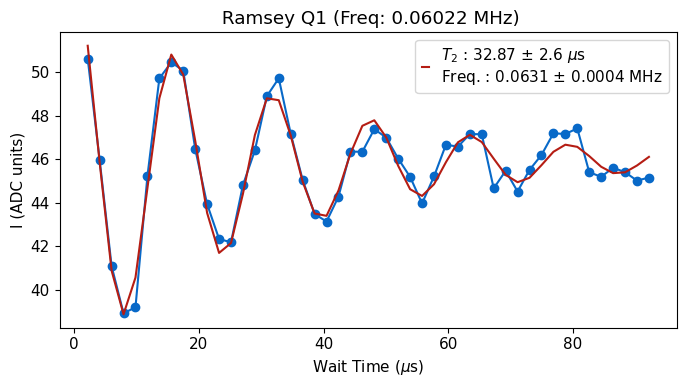

In [293]:
t2r = meas.T2Experiment(cfg_dict, qi=qi, max_err=10, style='fast')

In [295]:
t2r.data['fit_err_par']

array([ 0.08269838,  0.00592819,  0.03739884,  0.07951216,  0.00323673,
       -0.67884849])

### Use Ramsey to recenter

In [ ]:
qubit_list = [2]
for qi in qubit_list:
    status = qubit_tuning.recenter(qi,cfg_dict)            

### Ramsey coherence

In [ ]:
t1= qubit_tuning.get_coherence(meas.RamseyExperiment, qi, cfg_dict,par='T2r')

## T1

  0%|          | 0/35520 [00:00<?, ?it/s]

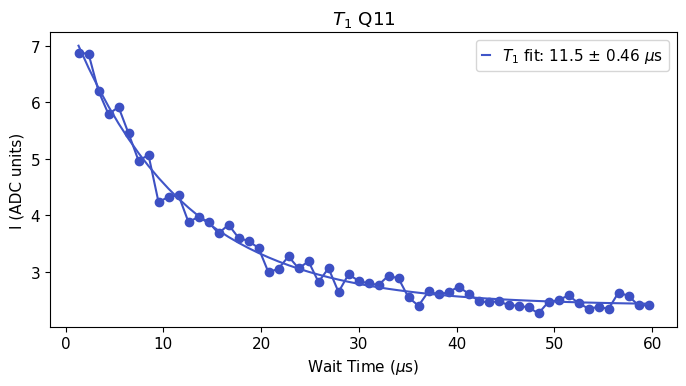

*Set cfg qubit 11 T1 to 11.51 from 16.35*


KeyboardInterrupt: 

In [513]:
qubit_list = np.arange(11,20)
# If it's the first time, also set T2r and T2e as guesses 
update=True
first_time=False
for qi in qubit_list:
    t1 = meas.T1Experiment(cfg_dict, qi=qi)
    if update: t1.update(cfg_path, first_time=first_time)

### T1 coherence

{}


  0%|          | 0/69240 [00:00<?, ?it/s]

R2:0.995	Fit par error:0.015	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit0_00125.h5


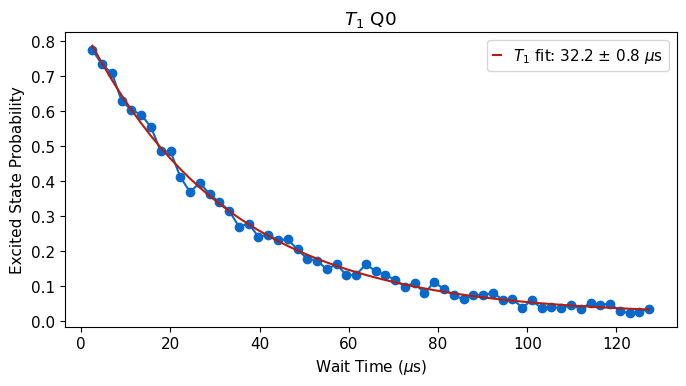

*Set cfg qubit 0 T1 to 32.23 from 34.94*


In [264]:
qi=0
qubit_tuning.get_coherence(meas.T1Experiment,qi=qi,cfg_dict=cfg_dict,par='T1')

{}


  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.985	Fit par error:0.027	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit10_00120.h5


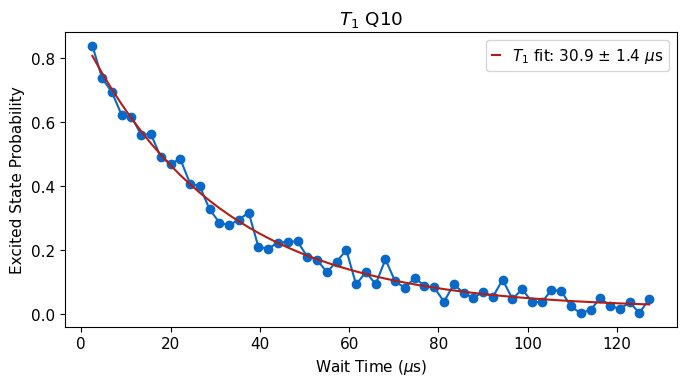

*Set cfg qubit 10 T1 to 30.92 from 34.91*


In [265]:
qi=10
qubit_tuning.get_coherence(meas.T1Experiment,qi=qi,cfg_dict=cfg_dict,par='T1')

## Continuous scan at single point

  0%|          | 0/40000 [00:00<?, ?it/s]

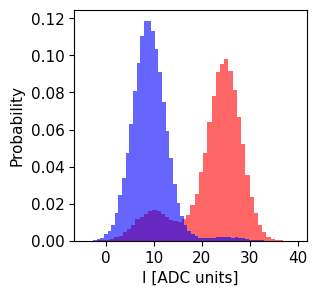

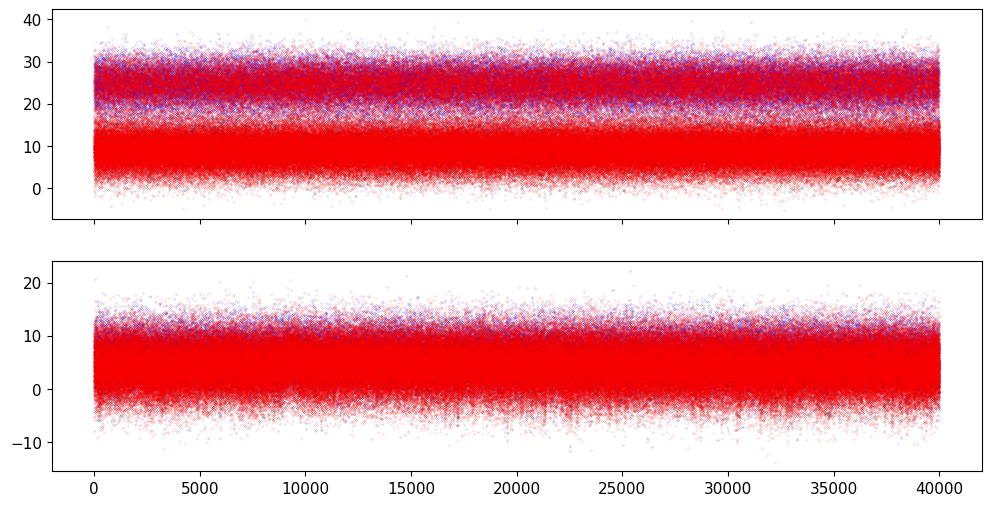

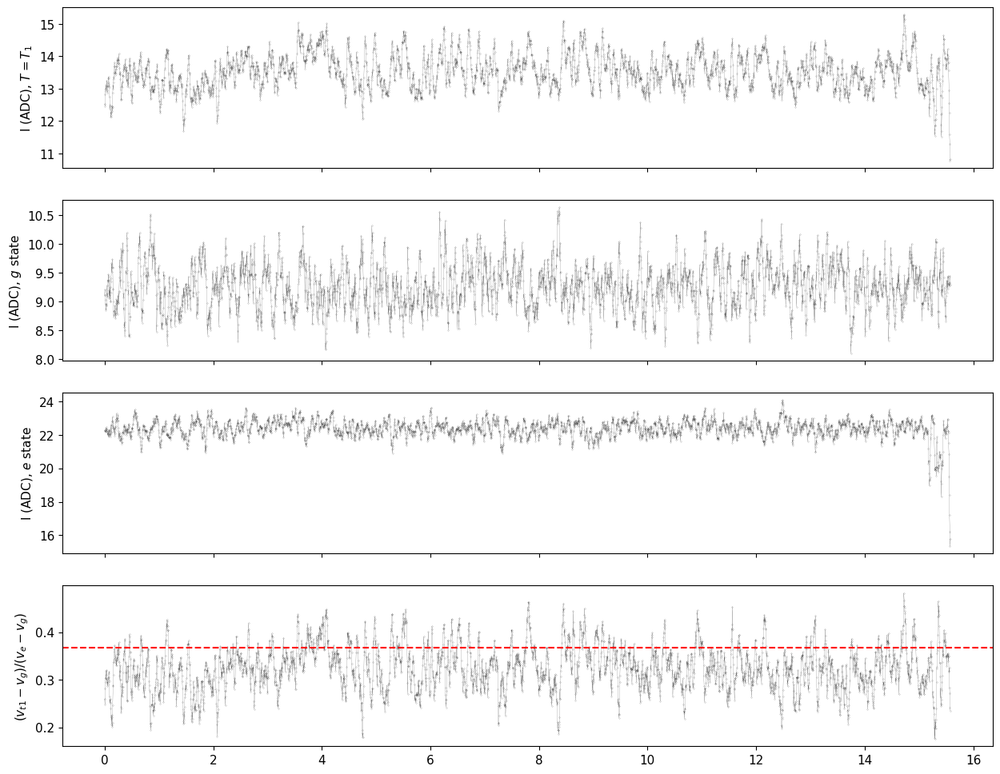

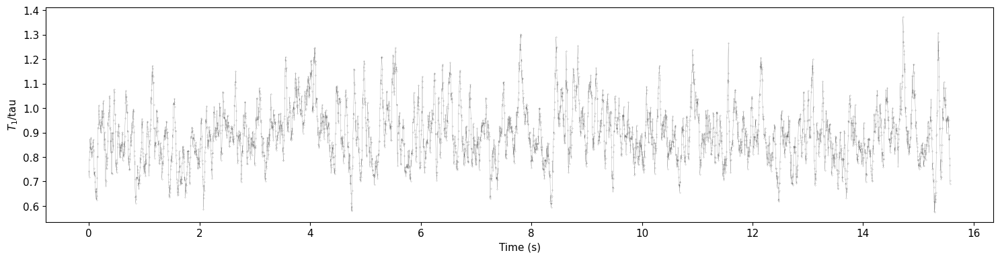

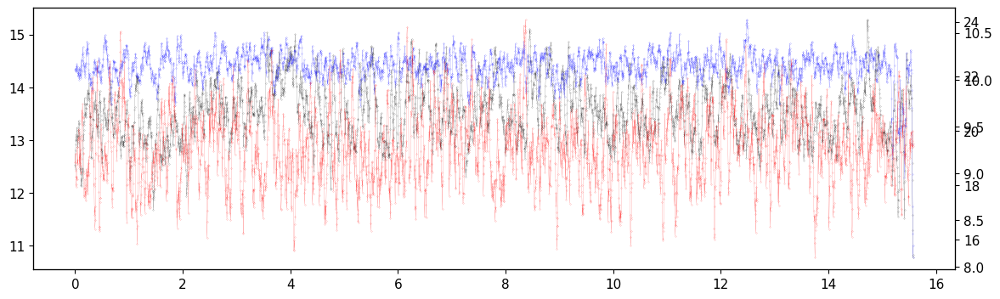

In [476]:
qi=0
#cProfile.run('meas.T1ContExperiment(cfg_dict,qi=qi, params={"shots":1000})')
meas.T1ContExperiment(cfg_dict,qi=qi, params={'shots':40000})

  0%|          | 0/100000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_cont_qubit10_00003.h5


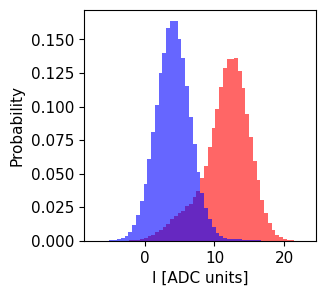

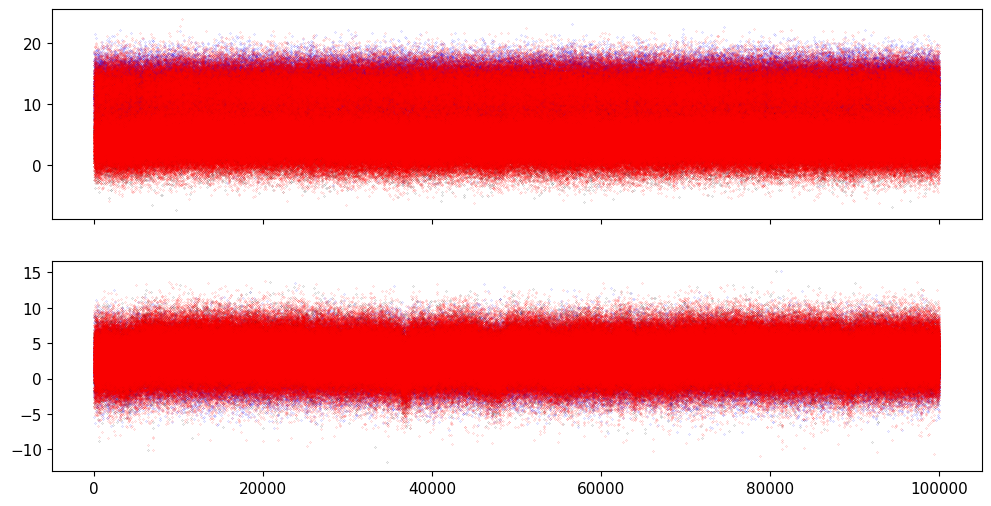

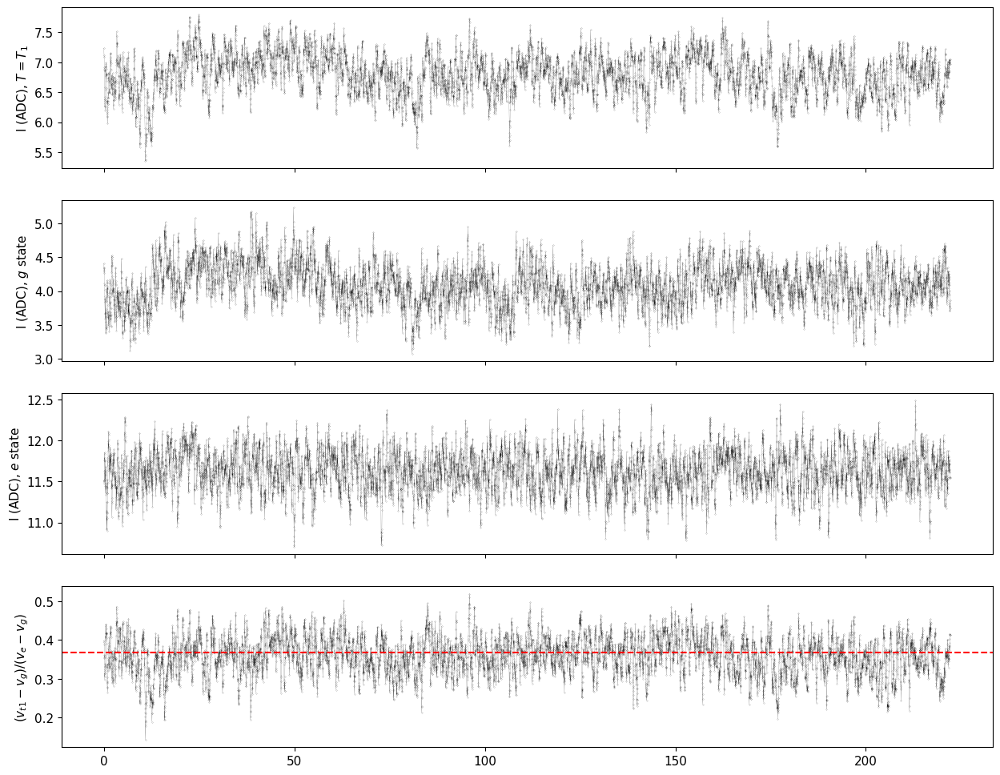

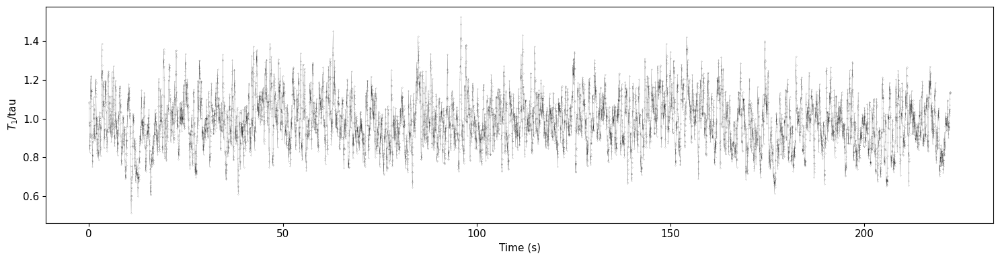

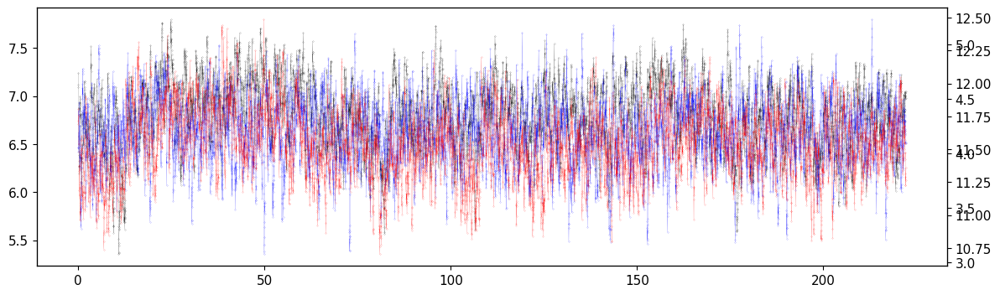

In [259]:
import cProfile

qi=10
#cProfile.run('meas.T1ContExperiment(cfg_dict,qi=qi, params={"shots":1000})')
meas.T1ContExperiment(cfg_dict,qi=qi, params={'shots':100000, 'active_reset':False})

  0%|          | 0/17280 [00:00<?, ?it/s]

R2:0.974	Fit par error:0.027	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit0_00110.h5


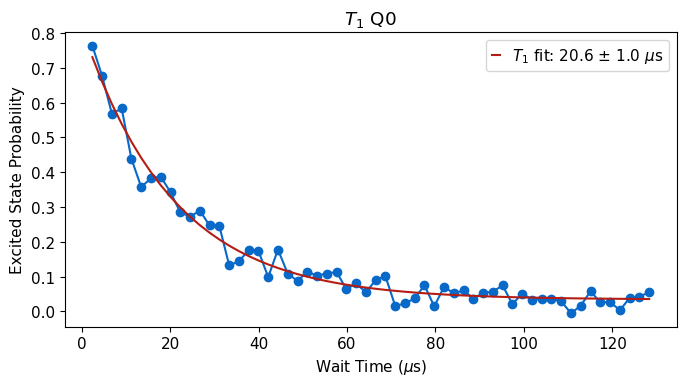

In [29]:
meas.T1Experiment(cfg_dict, qi = 0)

  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.990	Fit par error:0.023	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit10_00104.h5


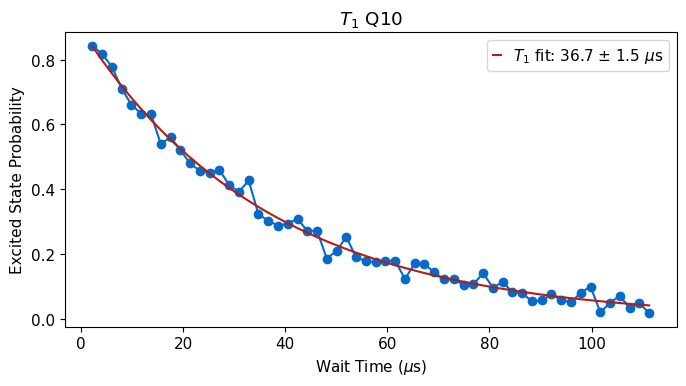

In [25]:
meas.T1Experiment(cfg_dict, qi = 10)

## T1 continuous 2Q

  0%|          | 0/69240 [00:00<?, ?it/s]

R2:0.997	Fit par error:0.002	 Best fit:b'avgi'
R2:0.996	Fit par error:0.004	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_Q10_Q0_00021.h5
('Error in saving cfg into datafile (experiment.py):', TypeError('Object of type bool_ is not JSON serializable'))


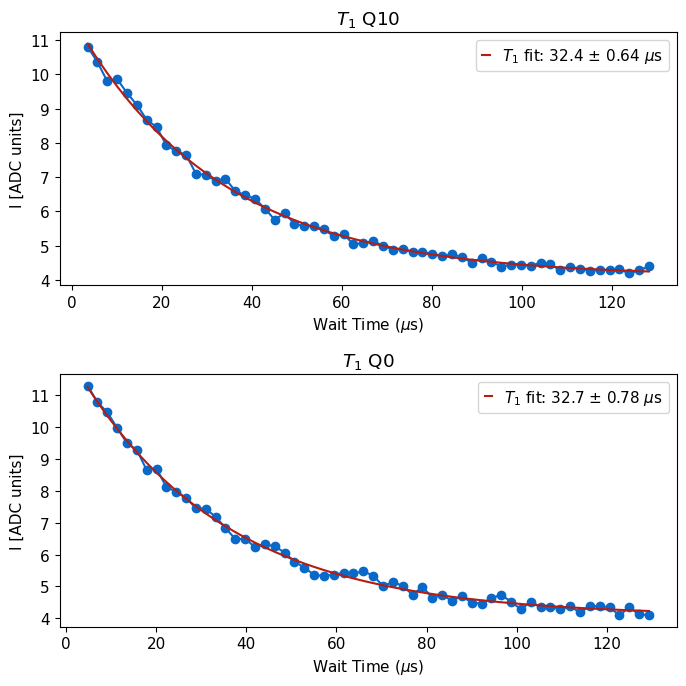

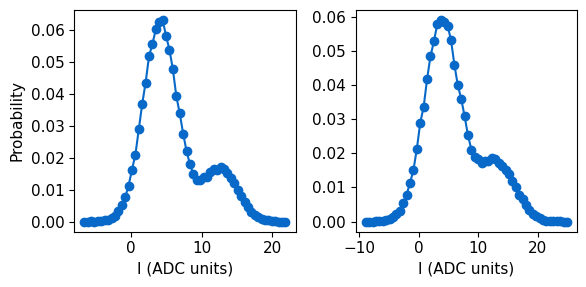

In [262]:
qi = [10,0]
meas.T1_2Q(cfg_dict,qi=qi, )

  0%|          | 0/69240 [00:00<?, ?it/s]

R2:0.995	Fit par error:0.003	 Best fit:b'avgi'
R2:0.996	Fit par error:0.003	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_Q0_Q10_00013.h5
('Error in saving cfg into datafile (experiment.py):', TypeError('Object of type bool_ is not JSON serializable'))


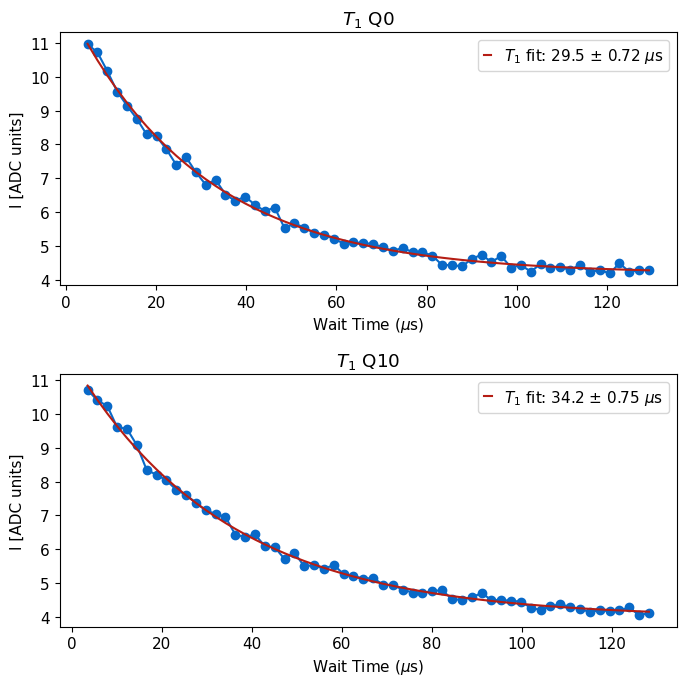

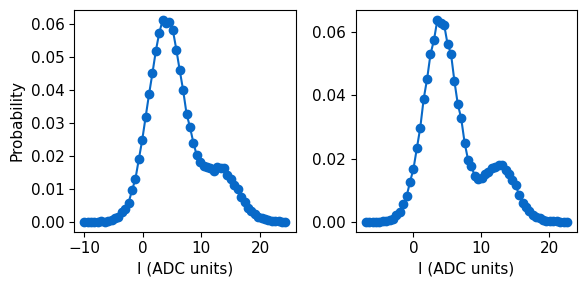

In [263]:
### T1 coherence

# from experiments.two_qubit.t1_2q import T1_2Q_Continuous
qi = [0,10]
meas.T1_2Q(cfg_dict,qi=qi, )
# meas.T1ContExperiment(cfg_dict,qi=qi, params={'shots':100000})

In [22]:
import experiments as meas

150000


  0%|          | 0/150000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_cont_Q0_Q10_00058.h5


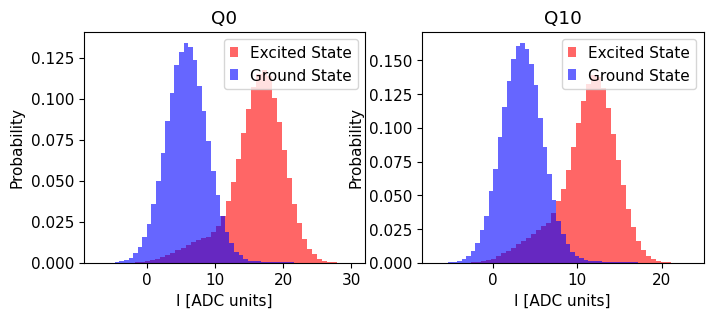

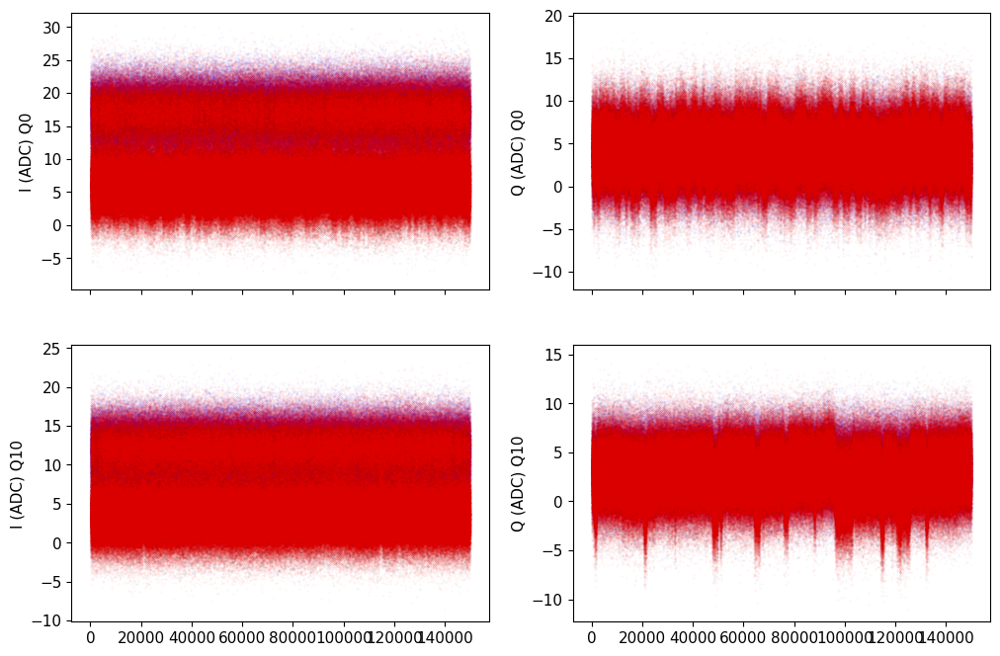

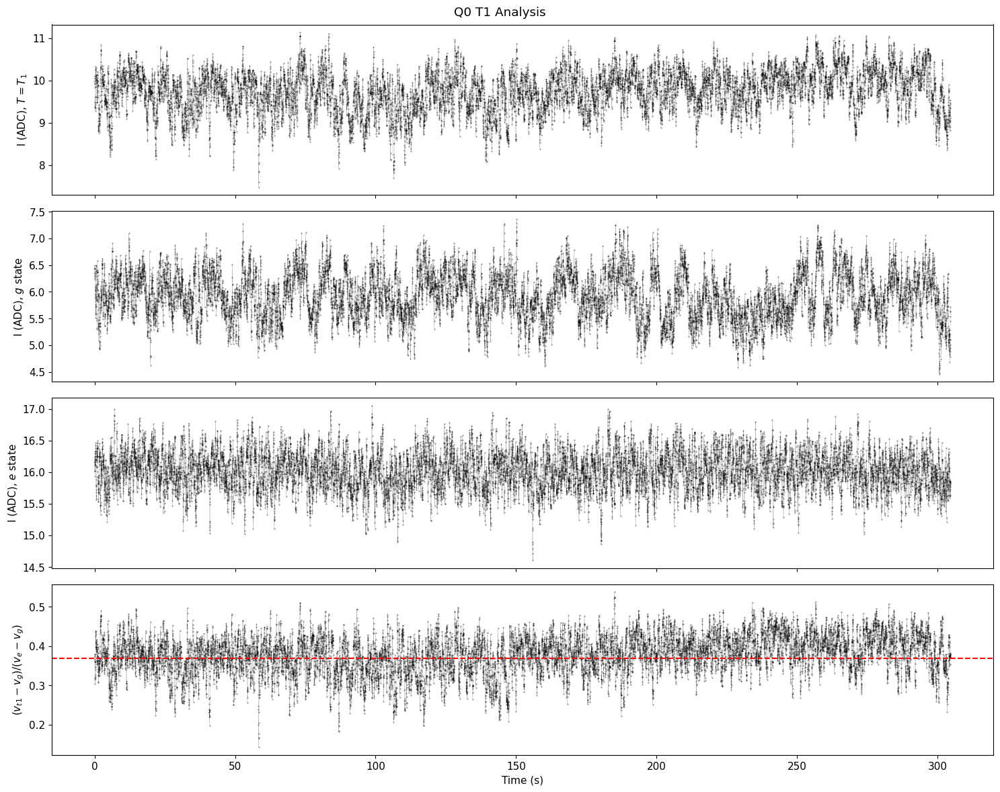

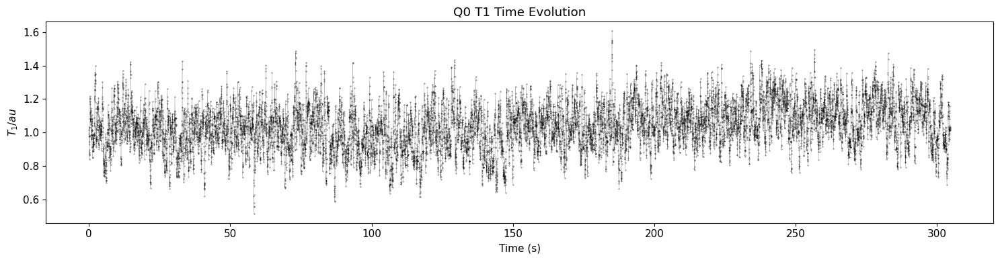

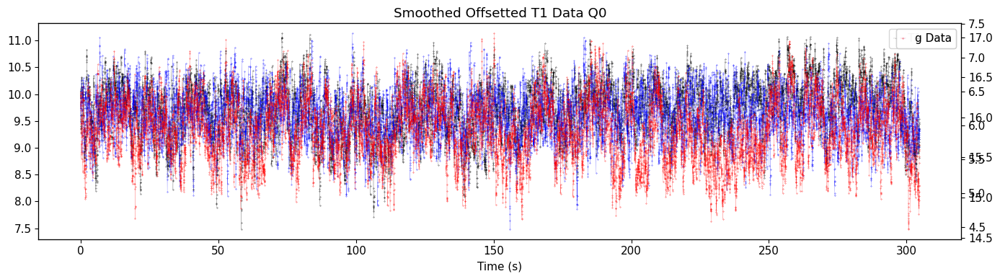

...

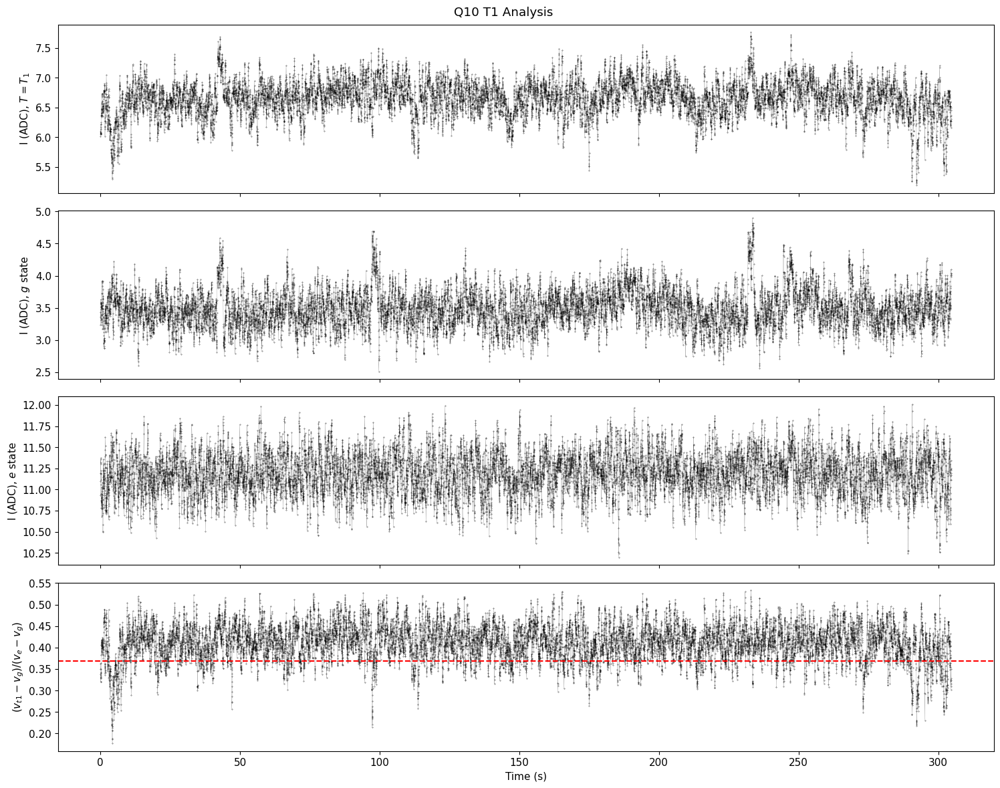

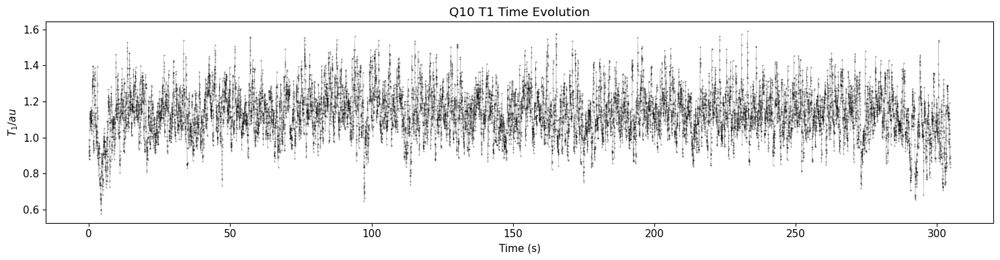

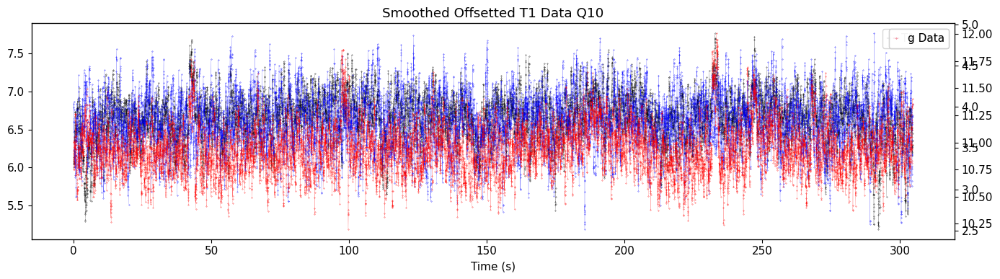

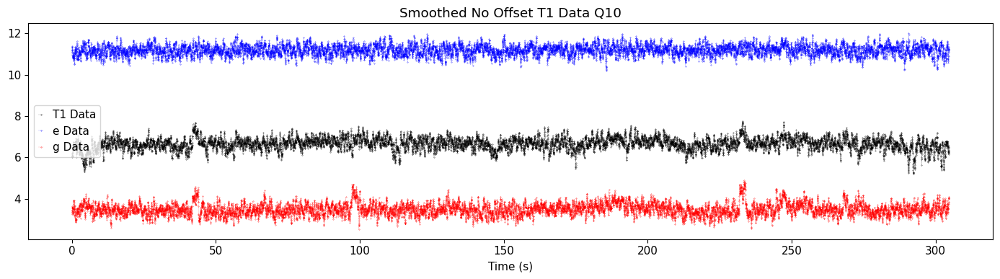

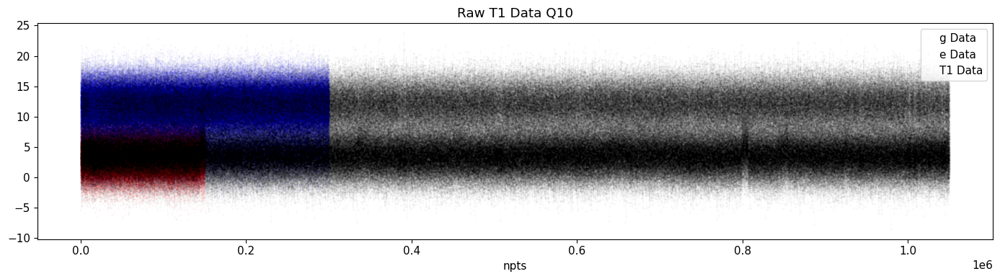

In [330]:
qi=[0,10]
scan_time = 0.1 #hours
number_of_scans = 1
shots = int(100000*scan_time*60/4)
print(shots)
for i in range(number_of_scans):
    meas.T1Cont2QExperiment(cfg_dict,qi=qi, params={'shots':shots, 'active_reset':False})
    # for q in qi:
    #     shot=meas.HistogramExperiment(cfg_dict, qi=q, params={'shots':20000})
    #     config.update_readout(cfg_path, 'phase', shot.data['angle'], q);
    #     config.update_readout(cfg_path, 'threshold',shot.data['thresholds'][0], q);
    #     config.update_readout(cfg_path, 'fidelity', shot.data['fids'][0], q);
    #     config.update_readout(cfg_path, 'sigma', shot.data['sigma'], q);
    #     config.update_readout(cfg_path, 'tm', shot.data['tm'],q);

In [568]:
3*np.pi/4

2.356194490192345

## Echo

  0%|          | 0/57000 [00:00<?, ?it/s]

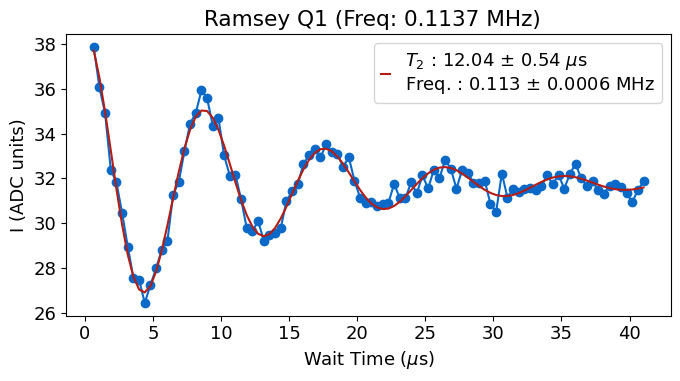

[11.410479890534138, 0.12258579409417396, 77.91266124492188, 10.092889694940476, 31.689106894773744, 0]


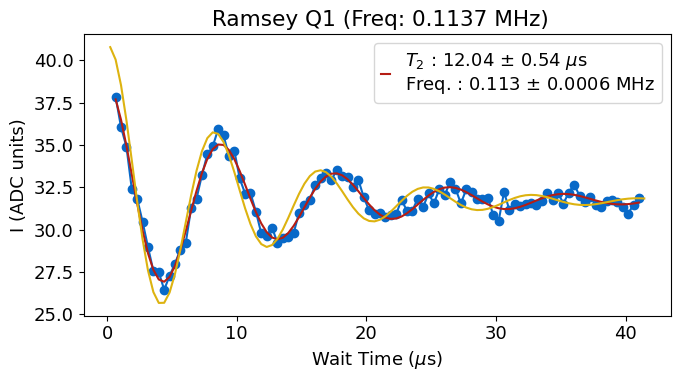

In [14]:
qubit_list = np.arange(20)
qubit_list=[1]
update=False
for qi in qubit_list:
    #status, t2e = tuneup.get_coherence(cfg.make_t2e, i, cfg_dict,'T2e', min_r2=min_r2,tol=tol, max_t1=max_t1)
    t2e = meas.T2Experiment(cfg_dict, qi=qi, params={'experiment_type':'echo'})
    if t2e.status and update:
        auto_cfg = config.update_qubit(cfg_path, 'T2e', t2e.data['best_fit'][3], qi,sig=2, rng_vals=[1.5, max_t1*2])

[11.10208913649025, 0.07781155015197572, 253.62929226466886, 15.900530133928566, 31.65754766941229, 0]


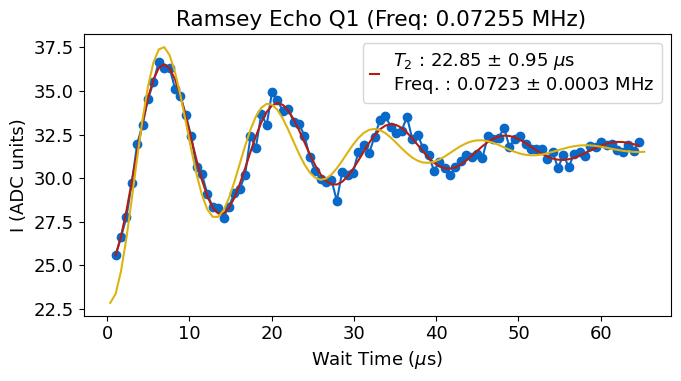

In [12]:
t2e.analyze()
t2e.display(debug=True)

### Get echo coherence

In [ ]:
qi=6
t2e = qubit_tuning.get_coherence(meas.RamseyEchoExperiment, qi, cfg_dict,'T2e')

## Feedback checks

In [ ]:
qi=10
reset = meas.MemoryExperiment(cfg_dict, qi=qi, params={'shots':1, 'expts':200})

  0%|          | 0/30000 [00:00<?, ?it/s]

  0%|          | 0/30000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00257.h5


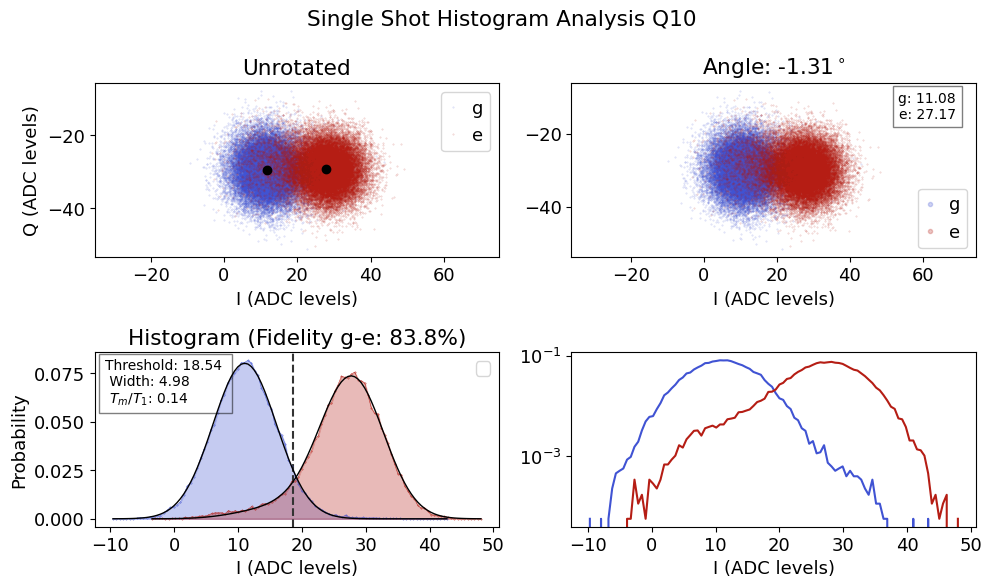

ge Fidelity (%): 83.833
Rotation angle (deg): -1.308
Threshold ge: 18.542
Reset is 0.340786 of e and 19.8981 of g


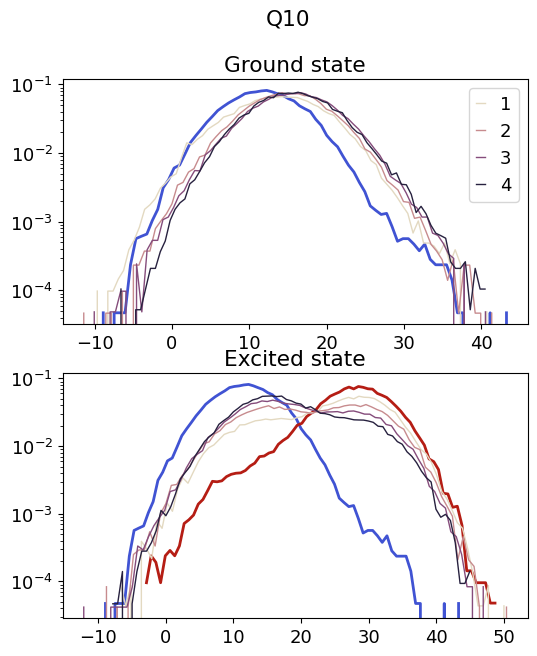

In [ ]:
# Don't do the active reset, just do the repeated measurement 
#shot=meas.RepMeasExperiment(cfg_dict, qi=qi, params={'shots':20000})
qi=1
shot = meas.RepMeasExperiment(cfg_dict, qi=qi, params={'shots':30000,'active_reset':True, 'setup_reset':True})
shot.check_reset()


# Single Shot

  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

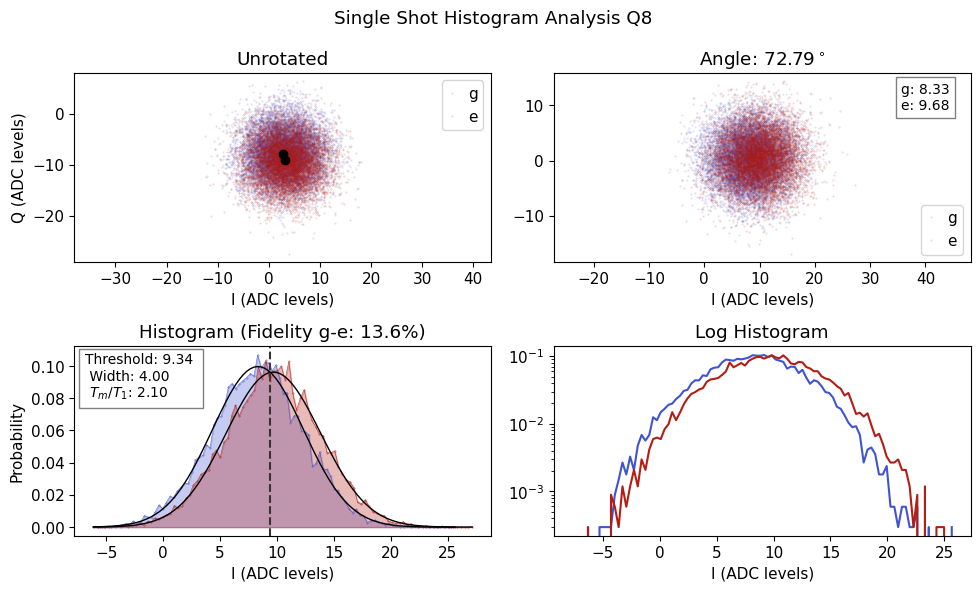

ge Fidelity (%): 13.625
Rotation angle (deg): 72.792
Threshold ge: 9.344
*Set cfg readout 8 phase to 72.7924 from -34.979*
*Set cfg readout 8 threshold to 9.3444 from 7.3854*
*Set cfg readout 8 fidelity to 0.1363 from 0.151*
*Set cfg readout 8 sigma to 4.002 from 3.6867*
*Set cfg readout 8 tm to 2.0959 from 2.1173*


In [ ]:
# Single shot 
qubit_list = np.arange(13,20)
qubit_list =[8]
for qi in qubit_list:
    shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':10000})
    shot.update(cfg_path)
    

### Test trig time

## Readout opt

### General sweep

Unexpected parameters found in params: {'step_f', 'step_len', 'step_gain'}


  0%|          | 0/5 [00:00<?, ?it/s]

Max fidelity 64.275 %
Optimal params: 
 Freq (MHz) 1884.679 
 Gain (DAC units) 0.562 
 Readout length (us) 7.562
Set fidelity: 63.617 %
Set params: 
 Freq (MHz) 1884.679 
 Gain (DAC units) 0.562 
 Readout length (us) 5.041


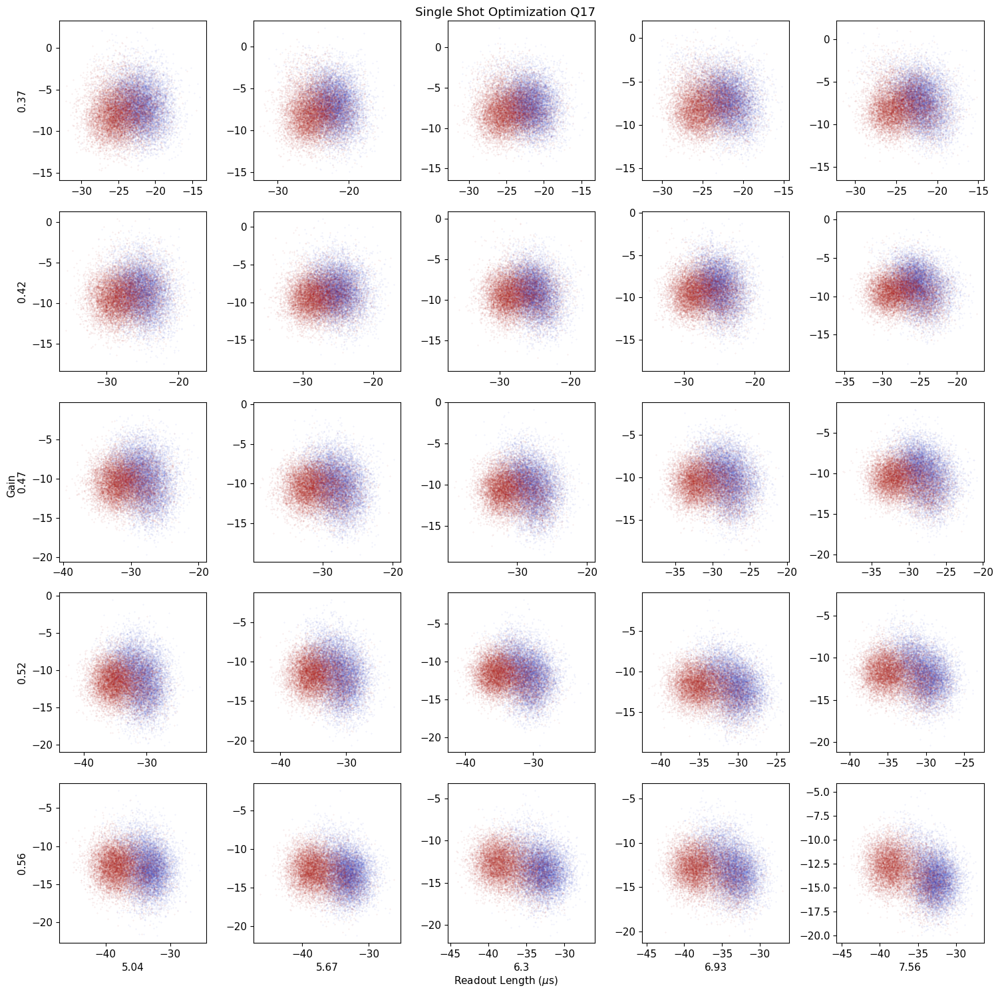

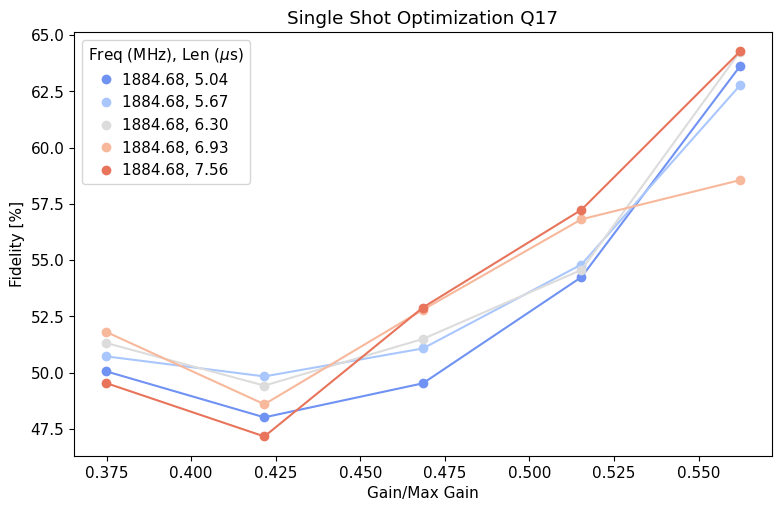

Fidelity is not maximized at the center of the sweep.
Max fidelity found at indices: (0, 4, 4)


In [549]:
qubit_list=np.arange(14,20)

qubit_list=[17]

update=False
params = {'expts_f':1, 'expts_gain':5, 'expts_len':5}
for qi in qubit_list: 
    shotopt=meas.SingleShotOptExperiment(cfg_dict, qi=qi,params=params,style='fine')
    if update:
        config.update_readout(cfg_path, 'gain', shotopt.data['gain'], qi);
        config.update_readout(cfg_path, 'readout_length', shotopt.data['length'], qi);
        config.update_readout(cfg_path, 'frequency', shotopt.data['freq'], qi);

### Run optimization until it converges

Unexpected parameters found in params: {'step_len', 'step_gain', 'step_f'}


  0%|          | 0/5 [00:00<?, ?it/s]

Max fidelity 15.827 %
Optimal params: 
 Freq (MHz) 3022.347 
 Gain (DAC units) 0.792 
 Readout length (us) 1.922
Set fidelity: 15.566 %
Set params: 
 Freq (MHz) 3022.347 
 Gain (DAC units) 0.584 
 Readout length (us) 1.922


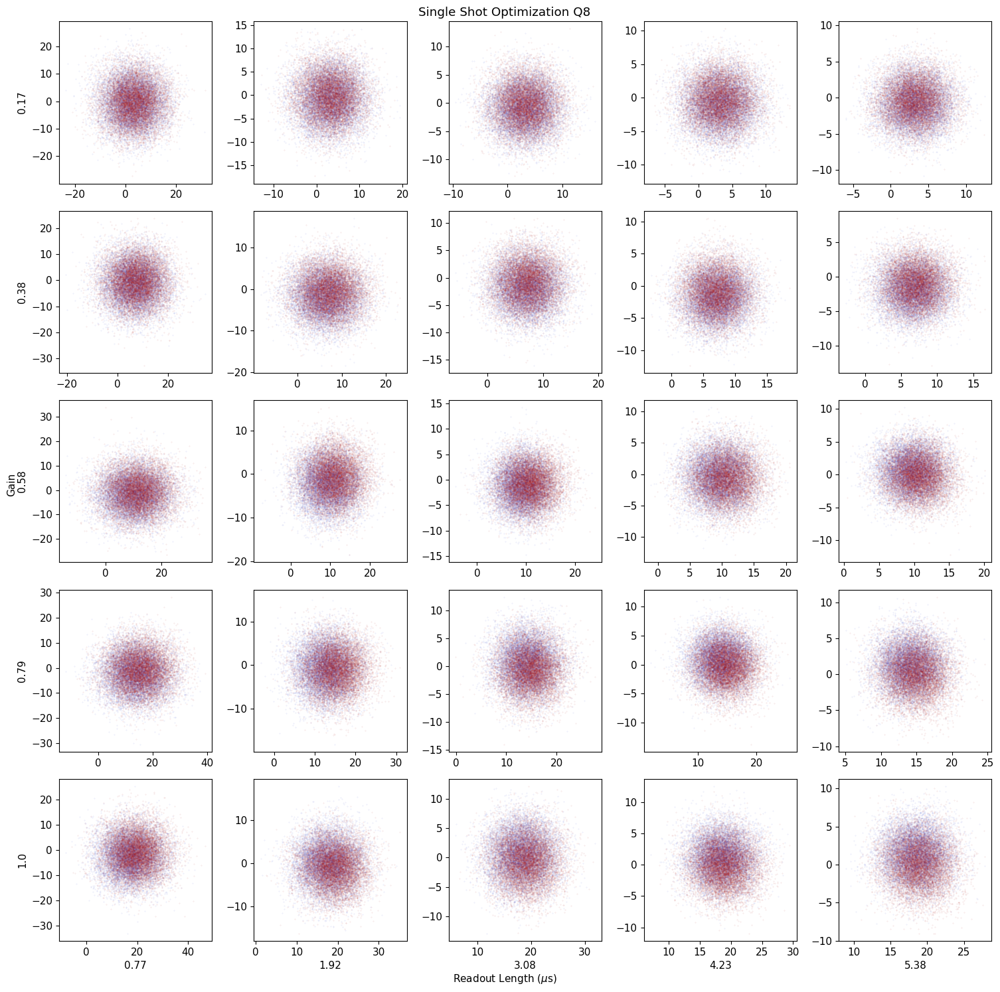

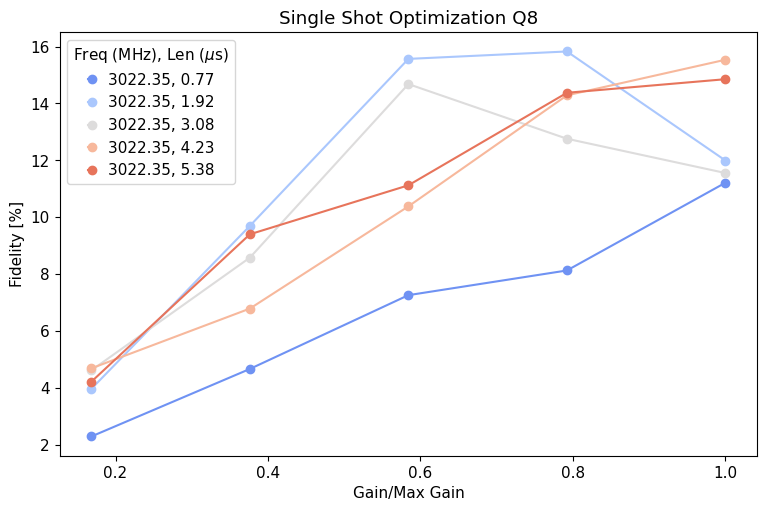

*Set cfg readout 8 gain to 0.5842 from 0.5611*
*Set cfg readout 8 readout_length to 1.922 from 2.5626*


  0%|          | 0/600000 [00:00<?, ?it/s]

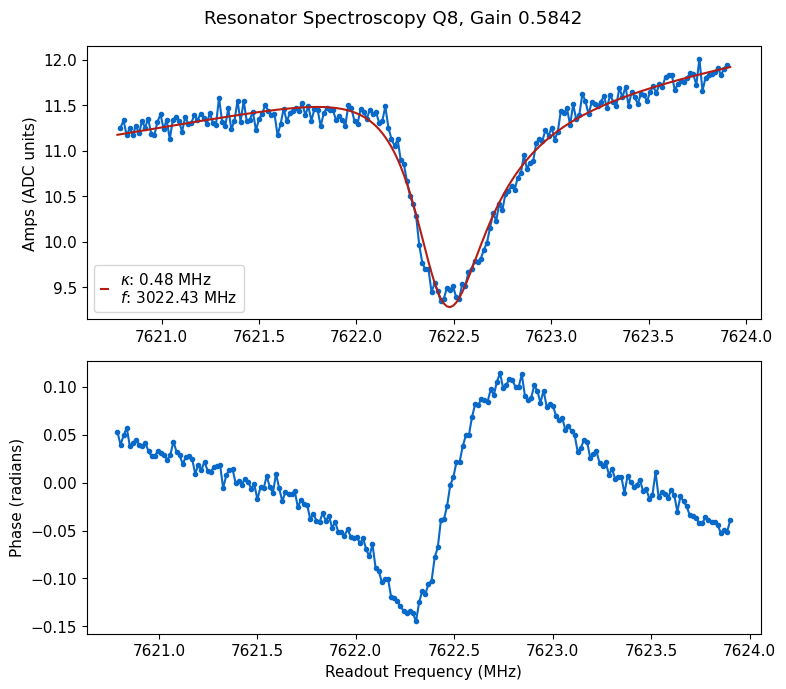

*Set cfg readout 8 frequency to 3022.4325 from 3022.3467*
*Set cfg readout 8 qi to 2.0297 from 2.4318*
*Set cfg readout 8 qe to 7.5234 from 9.547*
*Set cfg readout 8 kappa to 0.4769 from 0.3933*
Unexpected parameters found in params: {'step_len', 'step_gain', 'step_f'}


  0%|          | 0/5 [00:00<?, ?it/s]

Max fidelity 16.176 %
Optimal params: 
 Freq (MHz) 3022.432 
 Gain (DAC units) 0.584 
 Readout length (us) 2.114
Set fidelity: 15.486 %
Set params: 
 Freq (MHz) 3022.432 
 Gain (DAC units) 0.526 
 Readout length (us) 2.114


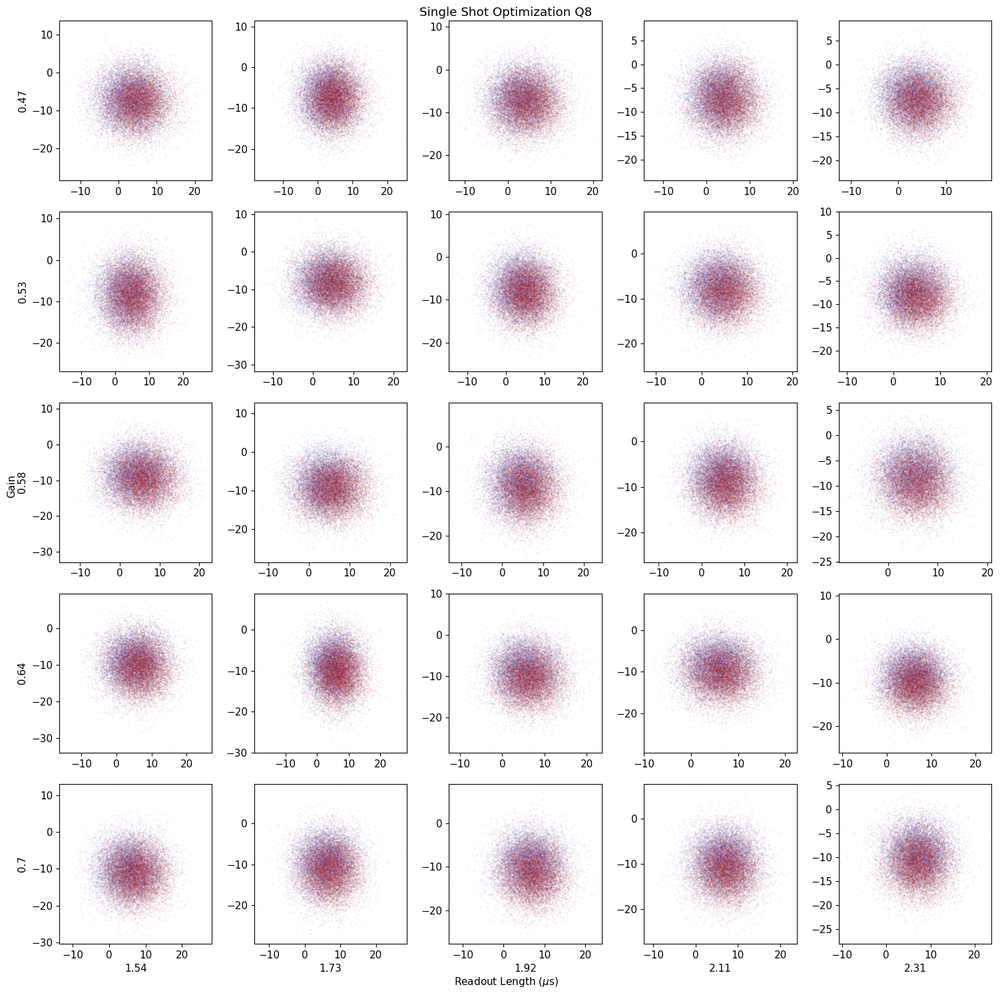

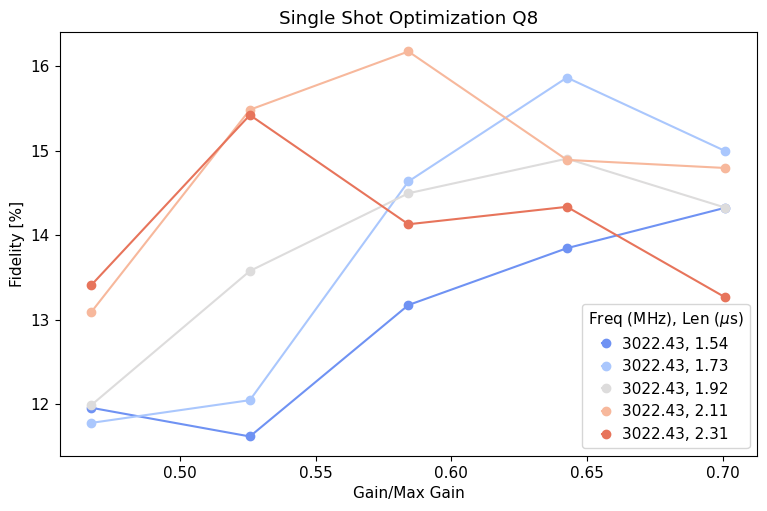

Fidelity is not maximized at the center of the sweep.
Max fidelity found at indices: (0, 2, 3)
*Set cfg readout 8 gain to 0.5258 from 0.5842*
*Set cfg readout 8 readout_length to 2.1142 from 1.922*


  0%|          | 0/600000 [00:00<?, ?it/s]

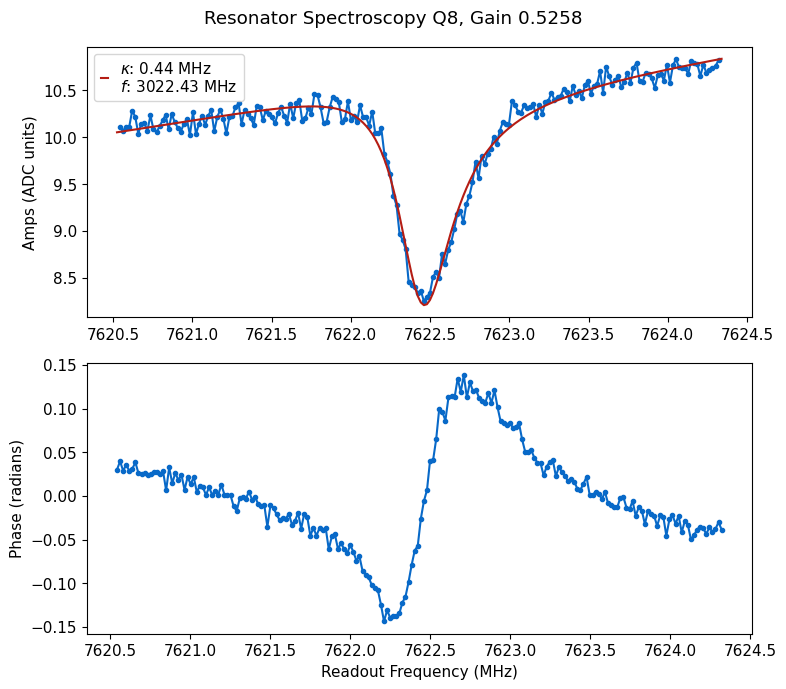

*Set cfg readout 8 frequency to 3022.461 from 3022.4325*
*Set cfg readout 8 qi to 2.2242 from 2.0297*
*Set cfg readout 8 qe to 7.754 from 7.5234*
*Set cfg readout 8 kappa to 0.441 from 0.4769*


In [21]:
qubit_list=np.arange(20)
#qubit_list=[10]
qubit_list=[8]
params = {'expts_f':1, 'expts_gain':5, 'expts_len':5}
qubit_tuning.meas_opt(cfg_dict, qubit_list, params, do_res=True)

*Set cfg readout 11 trig_offset to 0.2 from 0.52*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

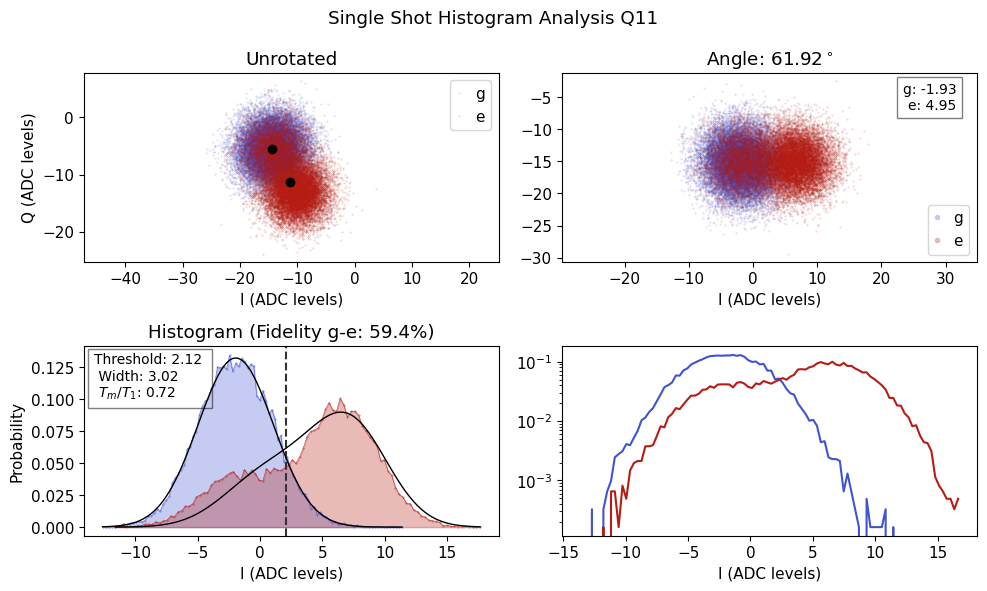

ge Fidelity (%): 59.372
Rotation angle (deg): 61.920
Threshold ge: 2.122
*Set cfg readout 11 trig_offset to 0.2727 from 0.2*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

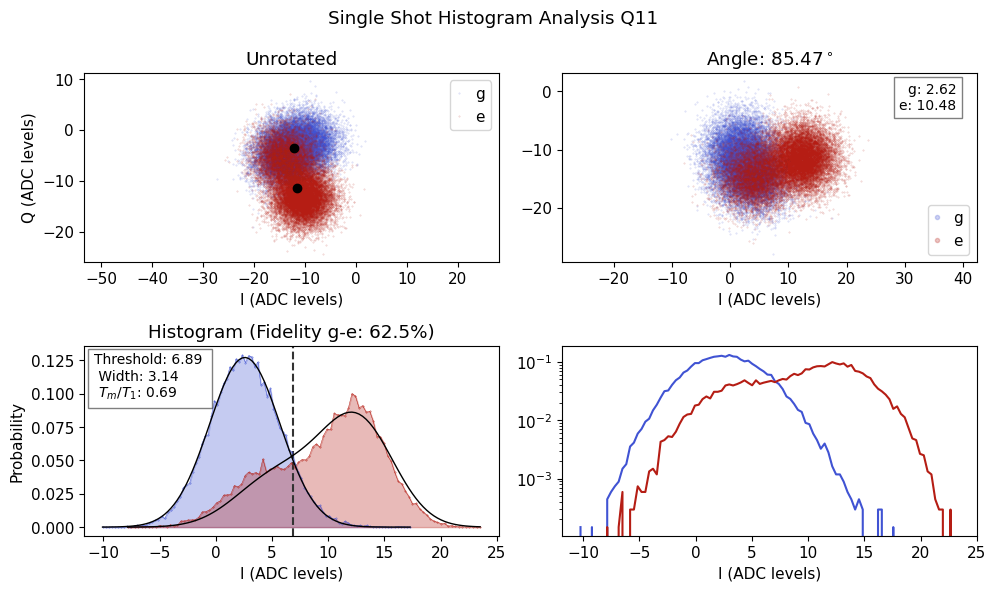

ge Fidelity (%): 62.468
Rotation angle (deg): 85.469
Threshold ge: 6.891
*Set cfg readout 11 trig_offset to 0.3455 from 0.2727*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

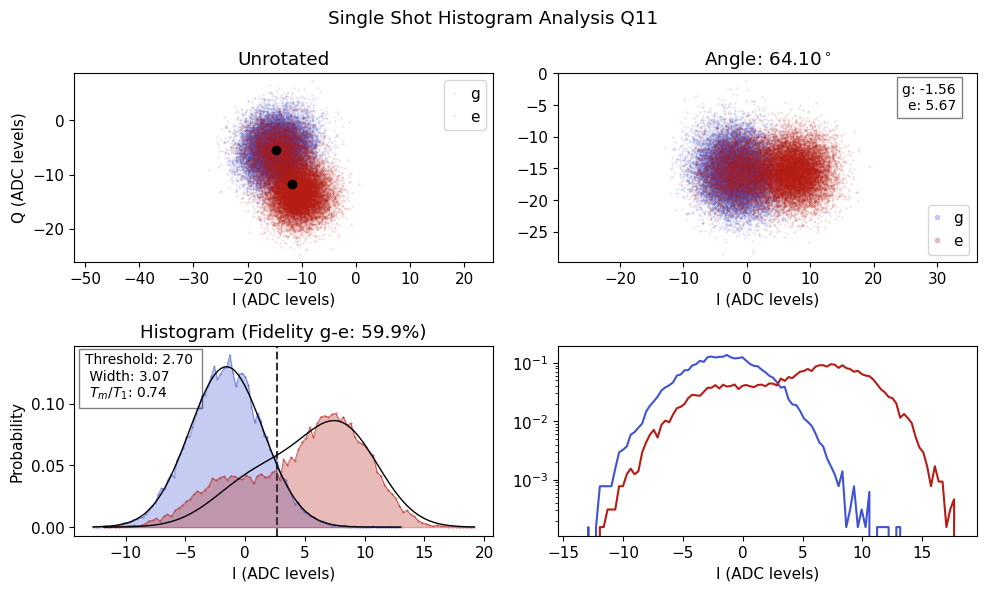

ge Fidelity (%): 59.913
Rotation angle (deg): 64.104
Threshold ge: 2.698
*Set cfg readout 11 trig_offset to 0.4182 from 0.3455*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

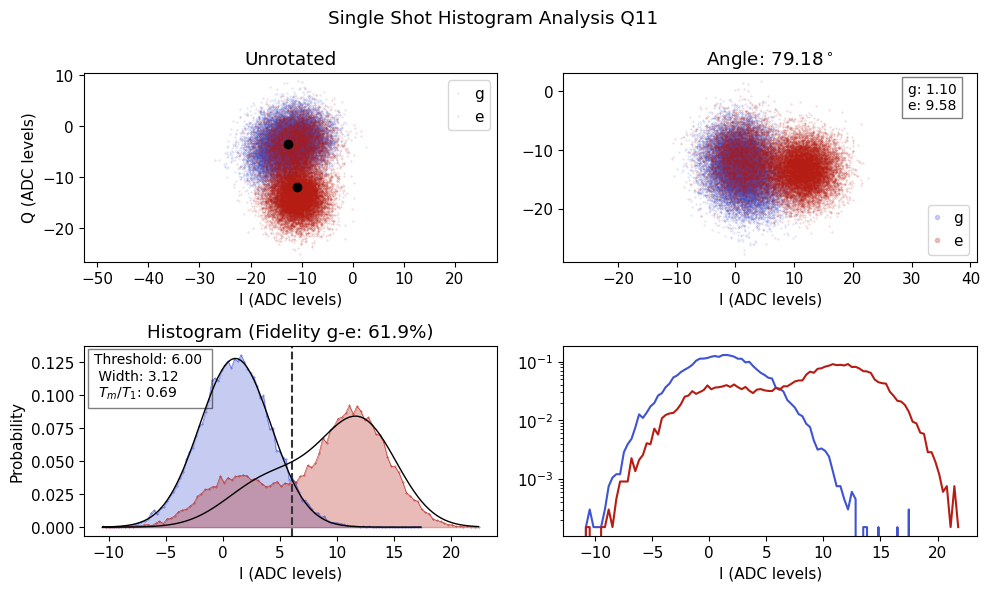

ge Fidelity (%): 61.853
Rotation angle (deg): 79.179
Threshold ge: 6.004
*Set cfg readout 11 trig_offset to 0.4909 from 0.4182*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

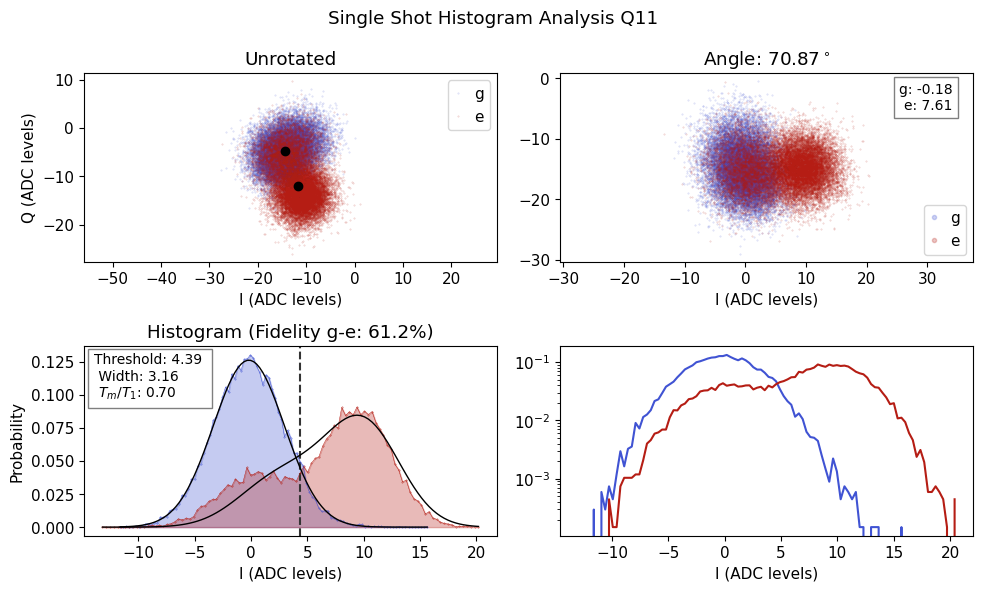

ge Fidelity (%): 61.243
Rotation angle (deg): 70.865
Threshold ge: 4.389
*Set cfg readout 11 trig_offset to 0.5636 from 0.4909*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

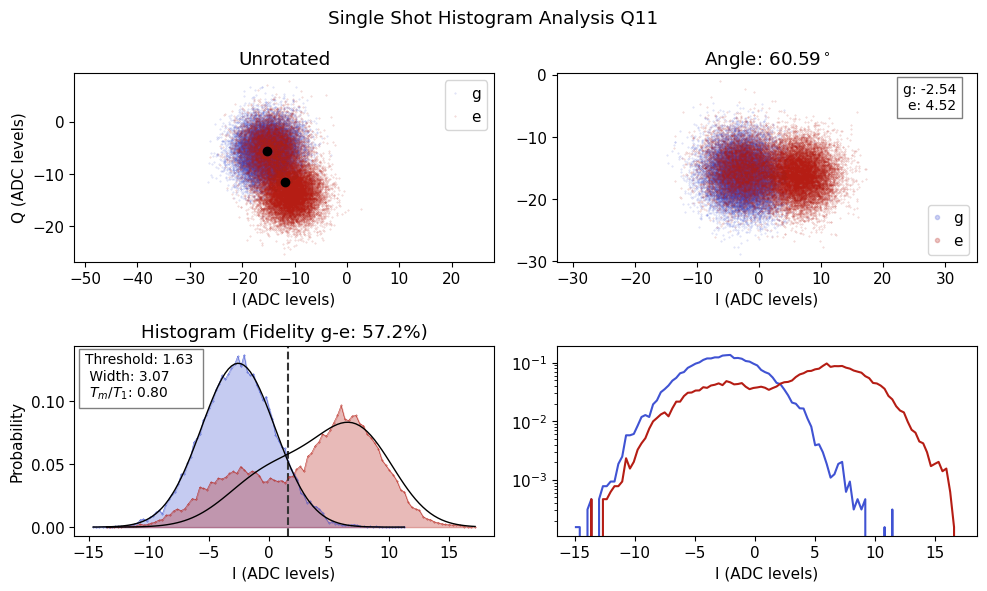

ge Fidelity (%): 57.165
Rotation angle (deg): 60.590
Threshold ge: 1.635
*Set cfg readout 11 trig_offset to 0.6364 from 0.5636*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

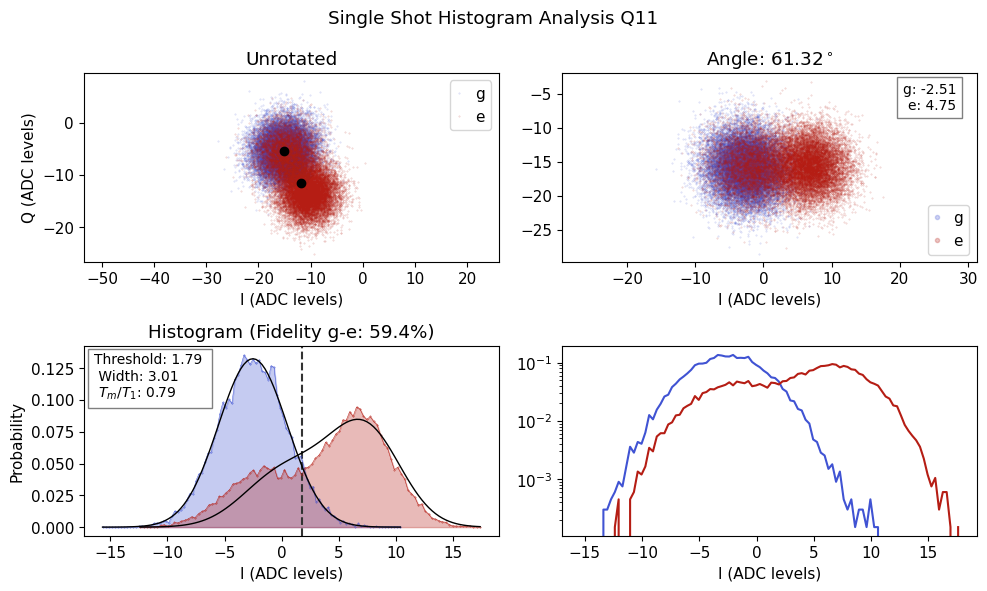

ge Fidelity (%): 59.370
Rotation angle (deg): 61.324
Threshold ge: 1.785
*Set cfg readout 11 trig_offset to 0.7091 from 0.6364*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

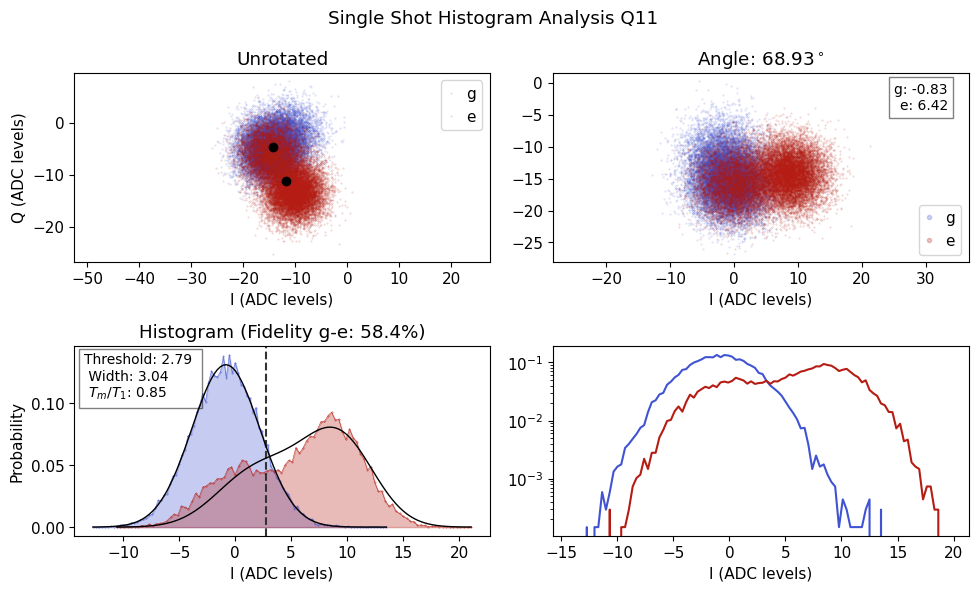

ge Fidelity (%): 58.403
Rotation angle (deg): 68.934
Threshold ge: 2.794
*Set cfg readout 11 trig_offset to 0.7818 from 0.7091*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

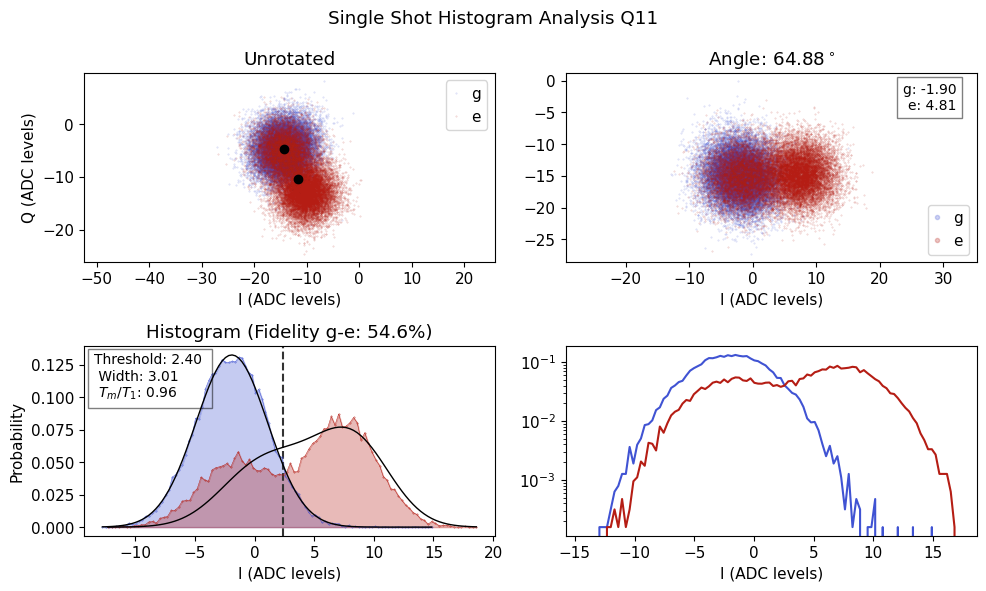

ge Fidelity (%): 54.620
Rotation angle (deg): 64.883
Threshold ge: 2.404
*Set cfg readout 11 trig_offset to 0.8545 from 0.7818*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

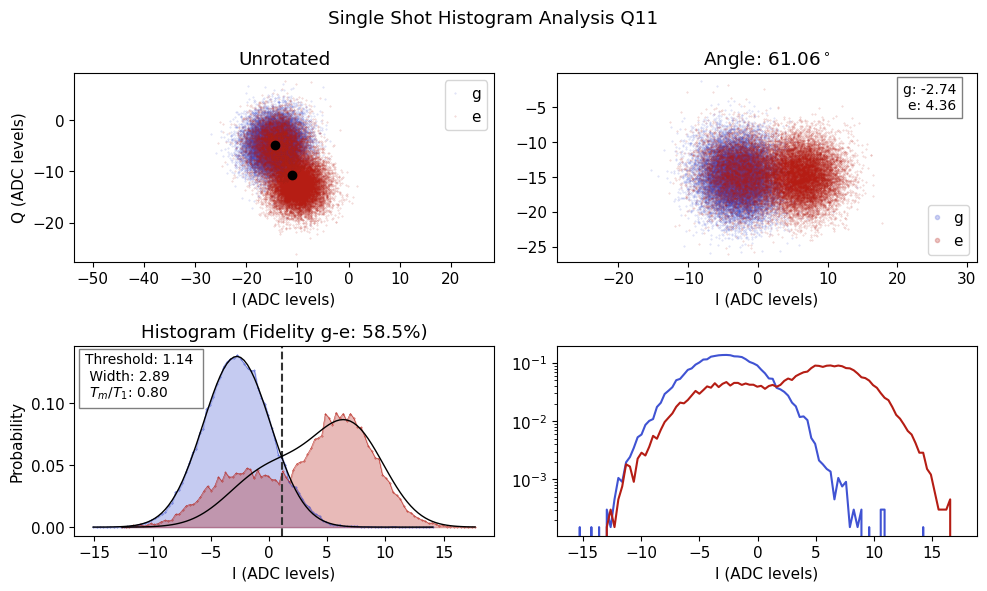

ge Fidelity (%): 58.478
Rotation angle (deg): 61.063
Threshold ge: 1.137
*Set cfg readout 11 trig_offset to 0.9273 from 0.8545*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

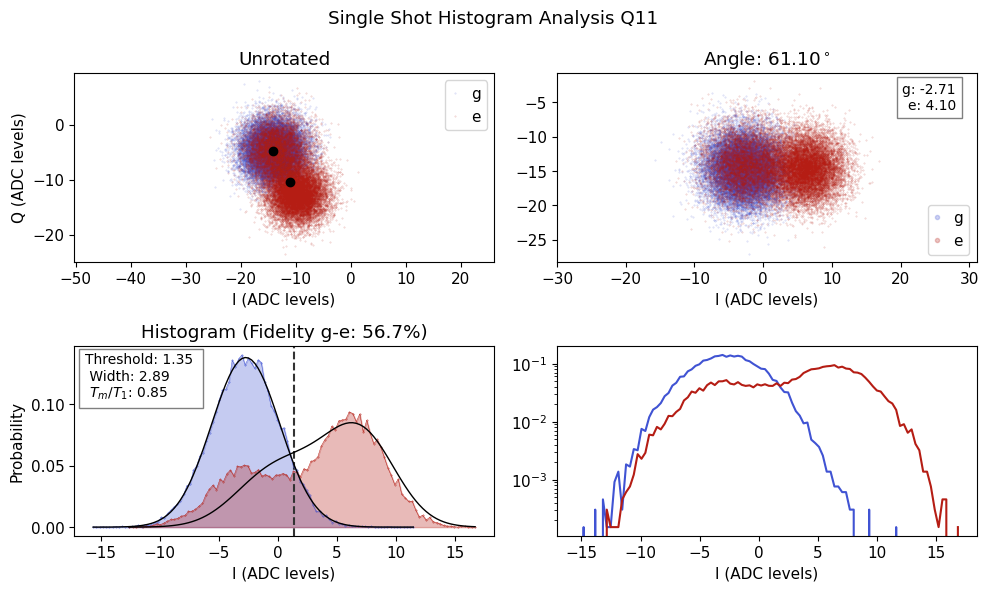

ge Fidelity (%): 56.745
Rotation angle (deg): 61.103
Threshold ge: 1.350
*Set cfg readout 11 trig_offset to 1.0 from 0.9273*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

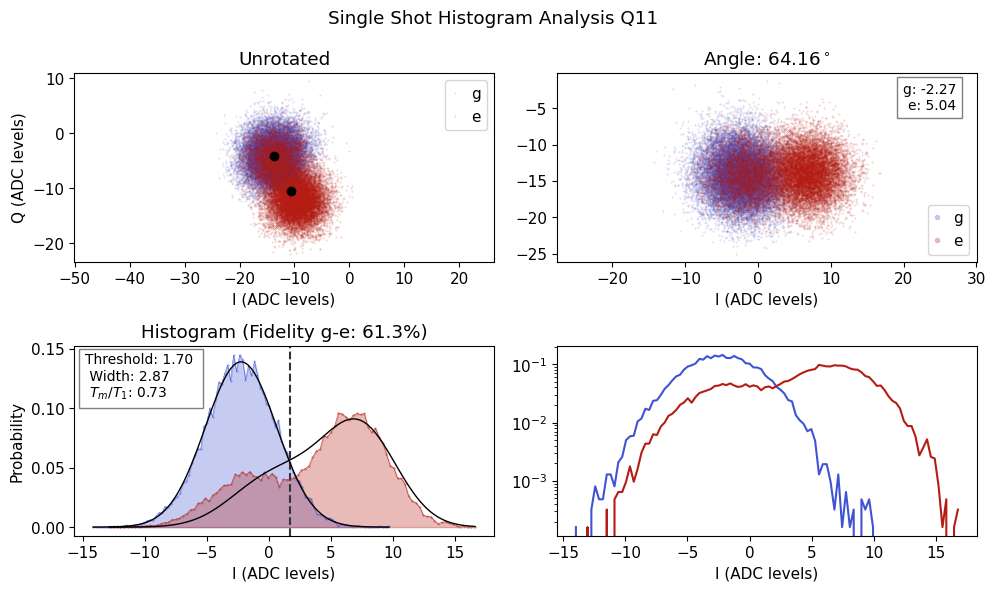

ge Fidelity (%): 61.315
Rotation angle (deg): 64.157
Threshold ge: 1.695


In [528]:
# Single shot 
qubit_list = np.arange(13,20)
qubit_list =[11]
trig_list = np.linspace(0.2,1,12)
fids =[]
for qi in qubit_list:
    for trig in trig_list: 
        config.update_readout(cfg_path, 'trig_offset', trig, qi);
        shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000, 'trigger':trig})
        fids.append(shot.data['fids'][0])
    

### Play with LO freq

In [ ]:
auto_cfg = config.load(cfg_path)
start_freq = auto_cfg.device.readout.frequency[qi]
start_mixer = auto_cfg.hw.soc.lo.mixer_freq[qi]
rng = np.linspace(-1000,1000,11)
for qi in qubit_list: 
    for r in rng: 
        config.update_lo(cfg_path, 'mixer_freq', start_mixer+r, qi)
        config.update_readout(cfg_path, 'frequency', start_freq-r, qi)
        shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000})

config.update_lo(cfg_path, 'mixer_freq', start_mixer, qi)
config.update_readout(cfg_path, 'frequency', start_freq, qi)

#### Play with LO power

In [ ]:
qi = 11
gain_vals = [0.0375,0.05] 
for gain in gain_vals:
    config.update_lo(cfg_path, 'gain', gain, qi)
    shotopt=meas.SingleShotOptExperiment(cfg_dict, qi=qi,params={'npts_f':5, 'npts_gain':5, 'npts_len':5})

### Adjust reps for fidelity 

In [313]:
max_inc = 15 # dont' let it do more than 15x standard number of reps sot hat thtings don't take forever
auto_cfg = config.load(cfg_path)
qubit_list = [10]
for qi in qubit_list:
    config.update_readout(cfg_path, 'reps', 1/auto_cfg['device']['readout']['fidelity'][qi]**1.5, qi, rng_vals=[1,max_inc]);

*Set cfg readout 10 reps to 1.2499 from 1.1902*


## Active reset

### Check active reset at standard threshold

  0%|          | 0/100000 [00:00<?, ?it/s]

  0%|          | 0/100000 [00:00<?, ?it/s]

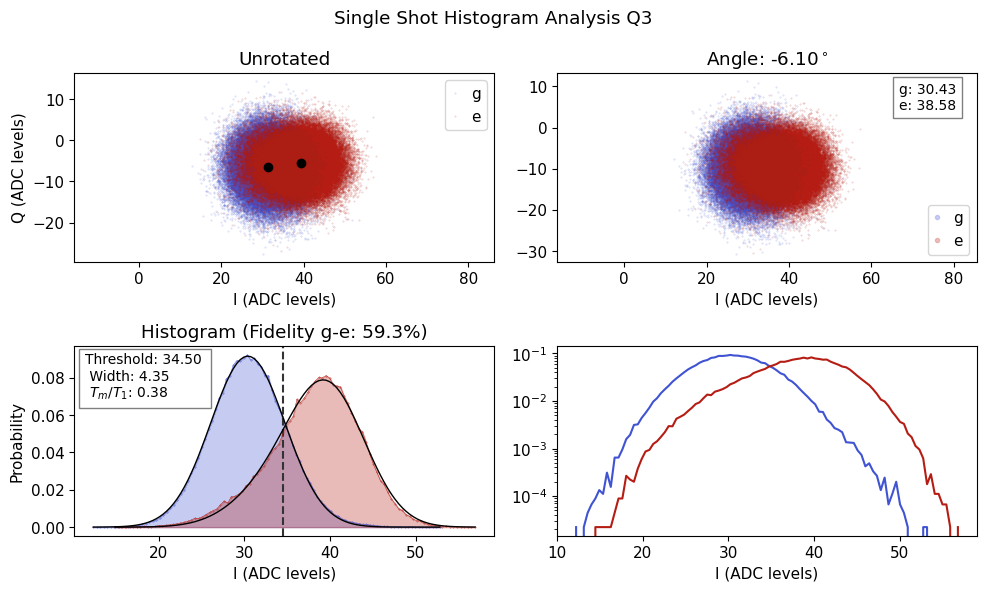

ge Fidelity (%): 59.337
Rotation angle (deg): -6.101
Threshold ge: 34.502
Reset is 0.912598 of e and 2.6879 of g


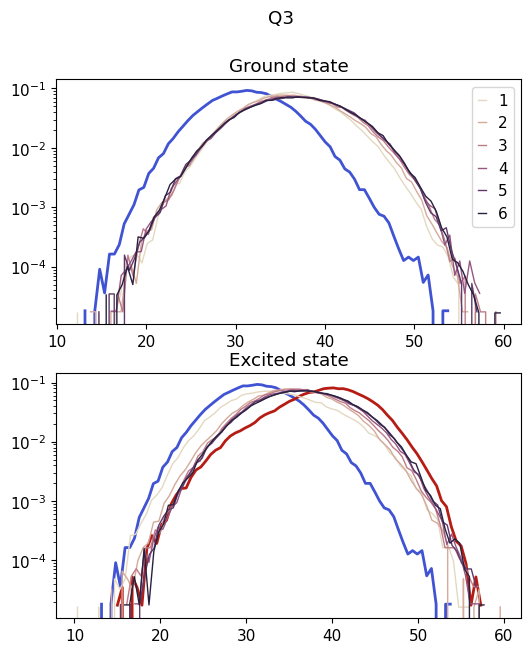

In [373]:
# Setup reset uses the calibrated angle and runs active reset process at end, but also uses usual final_delay so that it's ok if reset not working
qubit_list = np.arange(15,20)
qubit_list=[3]
d=[]
for qi in qubit_list:
    shot = meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':100000,'active_reset':True, 'setup_reset':True})
    shot.check_reset()
    #config.update_readout(cfg_path, 'reset_e', shot.data['reset_e'], qi)
    #config.update_readout(cfg_path, 'reset_g', shot.data['reset_g'], qi)
    d.append(shot)

### Sweep threshold

Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00303.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00304.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00305.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00306.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00307.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00308.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00309.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00310.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00311.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00312.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00313.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00314.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00315.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00316.h5
Saving

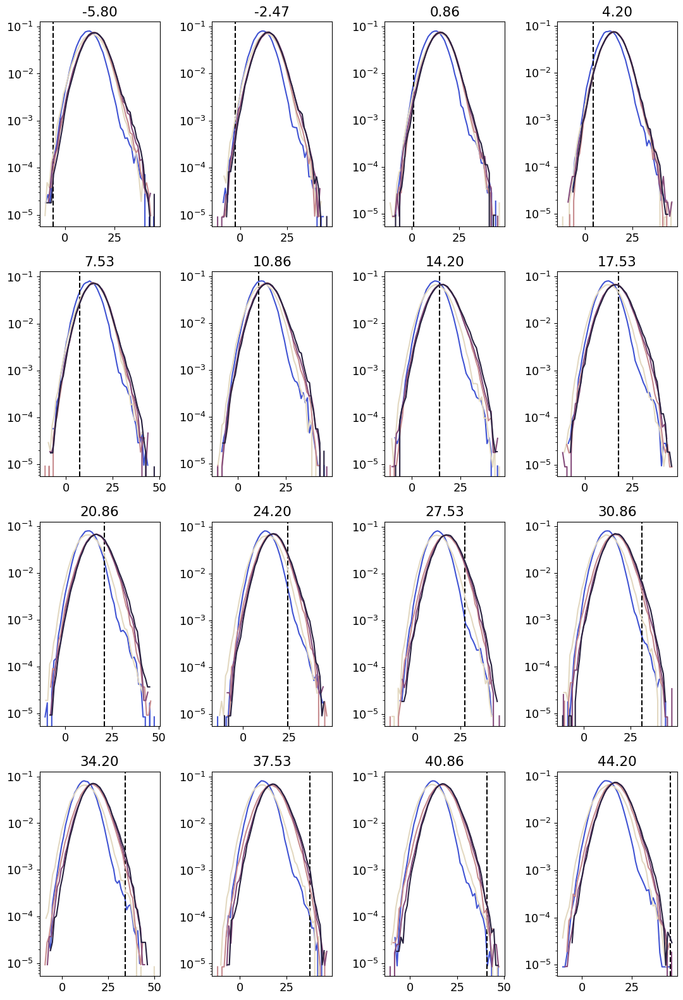

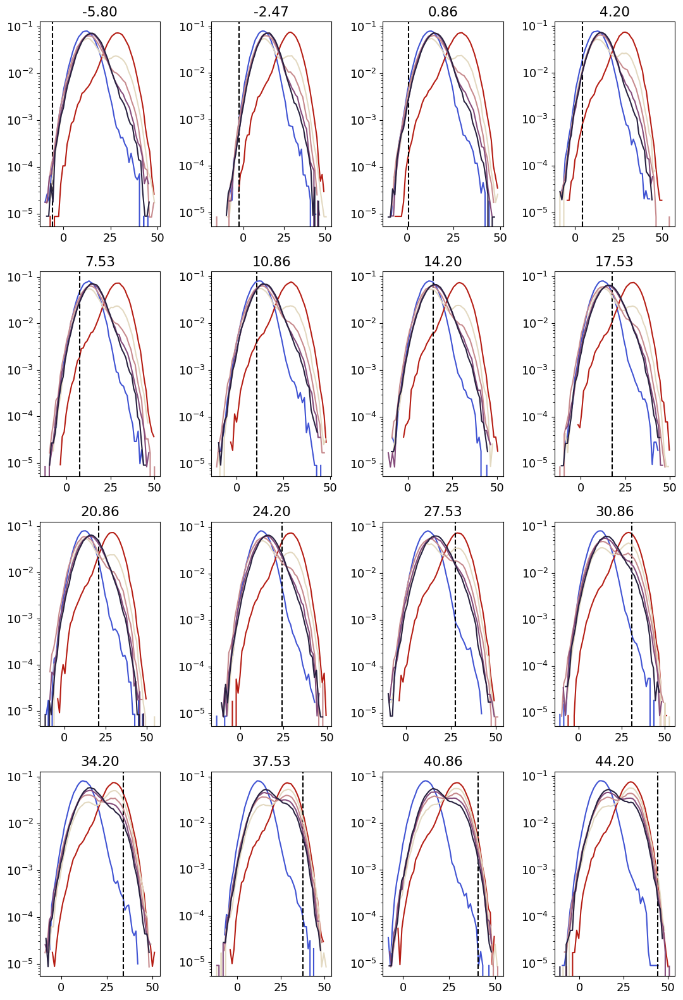

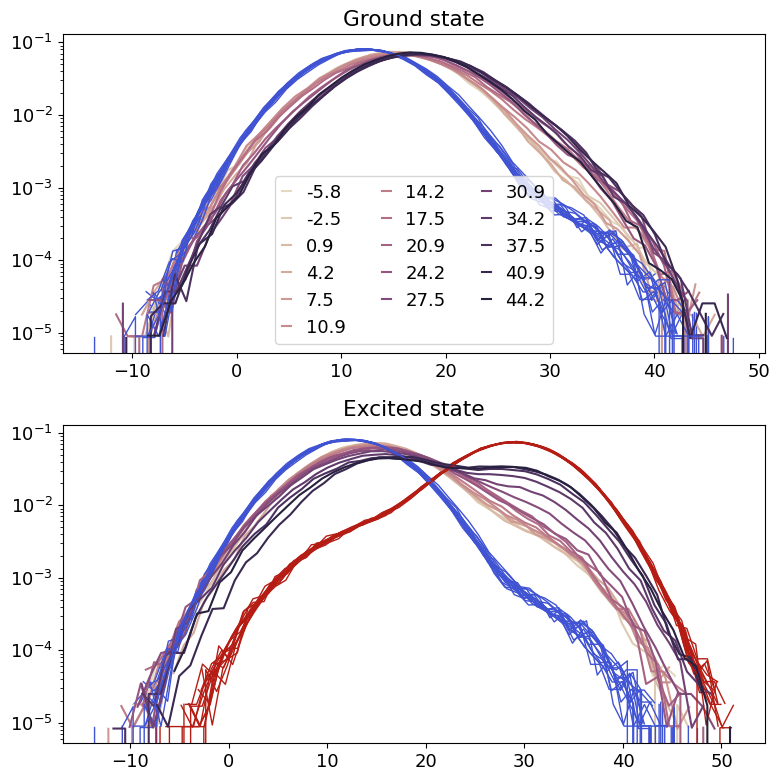

In [15]:
d = []
qi=10
auto_cfg = config.load(cfg_path)
threshold = auto_cfg['device']['readout']['threshold'][qi]
thresh = np.linspace(threshold-25,threshold+25,16)
#thresh = np.linspace(threshold-10,threshold+10,6)
for t in thresh:
    shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':100000,'threshold_v':t, 'active_reset':True,'setup_reset':True}, display=False, progress=False)
    d.append(shot)
    #shot.check_reset()
tuneup.plot_reset(d)

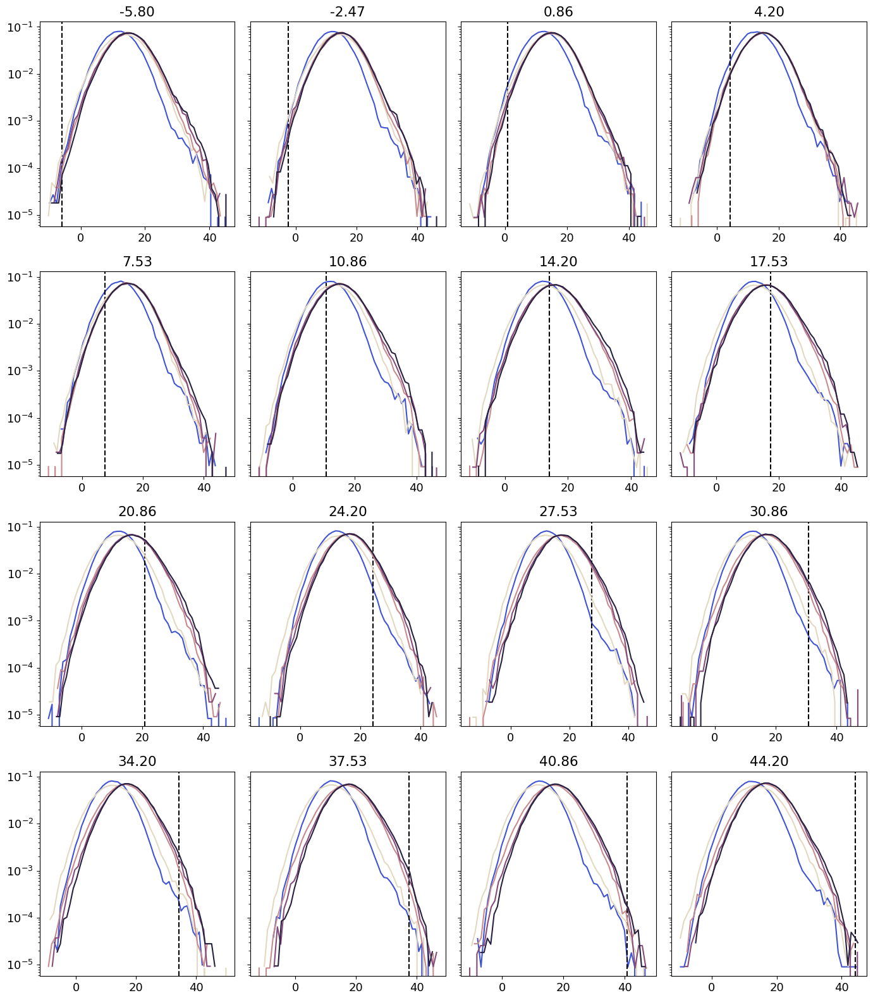

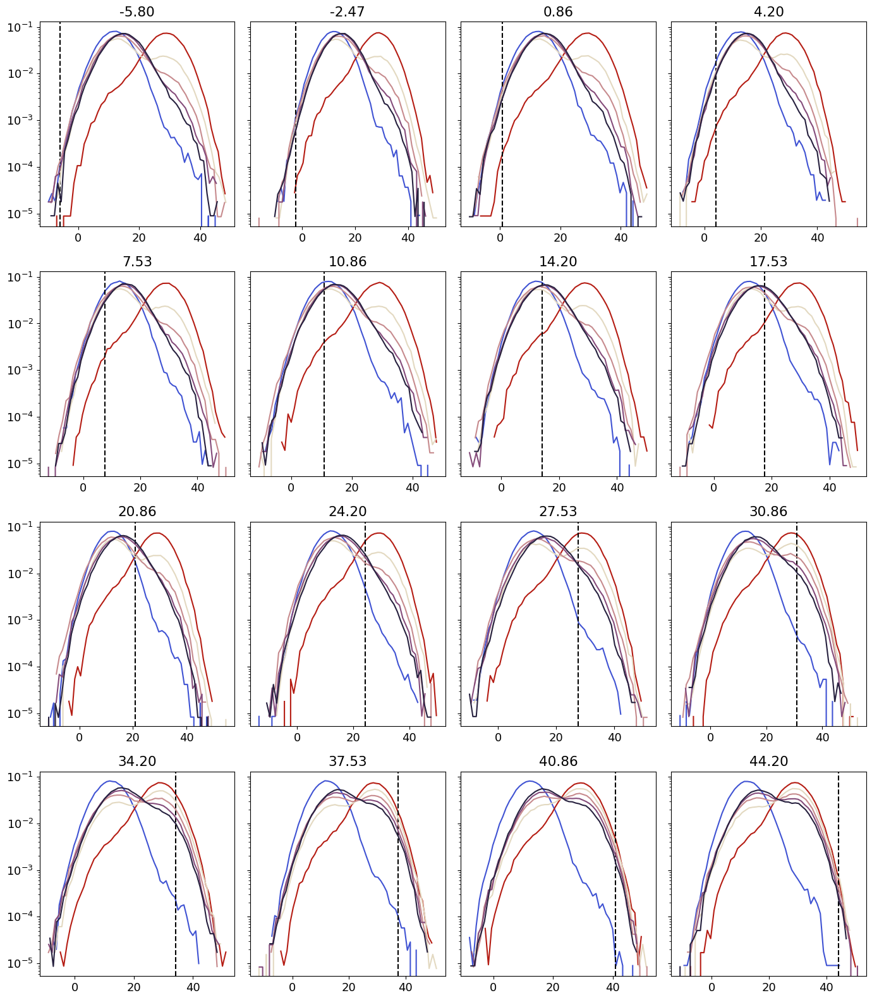

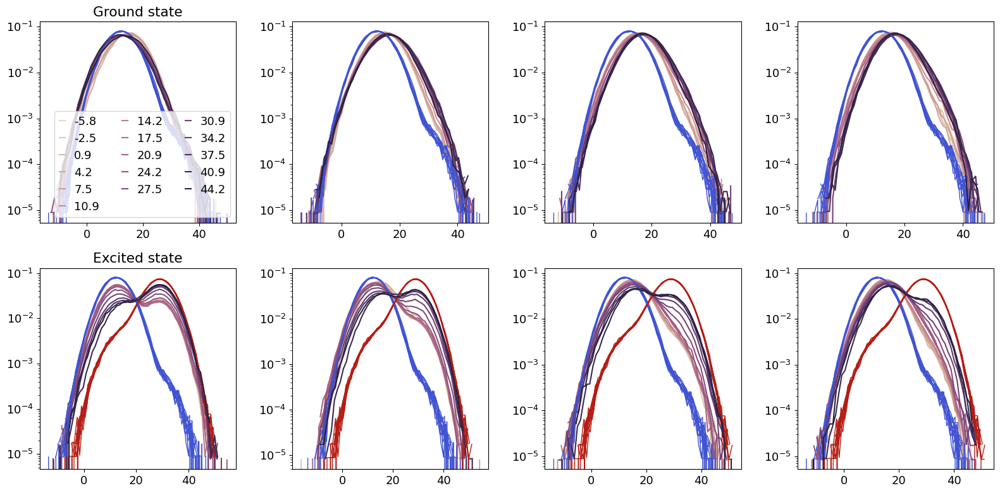

In [21]:
tuneup.plot_reset(d)

In [ ]:
# Check how many qubits meet certain thresholds for success of reset. 
reset_e = [d[i].data['reset_e'] for i in range(len(d))]
reset_g = [d[i].data['reset_g'] for i in range(len(d))]

plt.figure()
plt.semilogy(reset_e,'o')
plt.axhline(y=0.15, color='r', linestyle='--')
plt.semilogy(reset_g,'ro')
plt.semilogy(np.array(reset_g)/np.array(reset_e), 'ko')
plt.axhline(y=1, color='r', linestyle='--')
#plt.show()

### Turn off active reset for all config chans

In [ ]:
for qi in range(20):
    config.update_readout(cfg_path, 'active_reset',False, qi)

In [64]:
config.update_readout(cfg_path, 'active_reset',True, 17);

*Set cfg readout 17 active_reset to True from False*


### Turn on active reset for channels where it seems to be working

In [ ]:
e_success = 0.15 # Ratio of e proportion after active reset compared to before
g_vs_e = 2 # Ratio of g proportion to e proportion after active reset

auto_cfg = config.load(cfg_path)
reset_e = auto_cfg['device']['readout']['reset_e']
reset_g = auto_cfg['device']['readout']['reset_g']
result = np.array(reset_e)< e_success | np.array(reset_g)/np.array(reset_e)<g_vs_e
for qi in range(20):
    config.update_readout(cfg_path, 'active_reset',bool(result[qi]), qi)

### Check reset (plotting result of reset)

  0%|          | 0/50000 [00:00<?, ?it/s]

  0%|          | 0/50000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_17_00028.h5


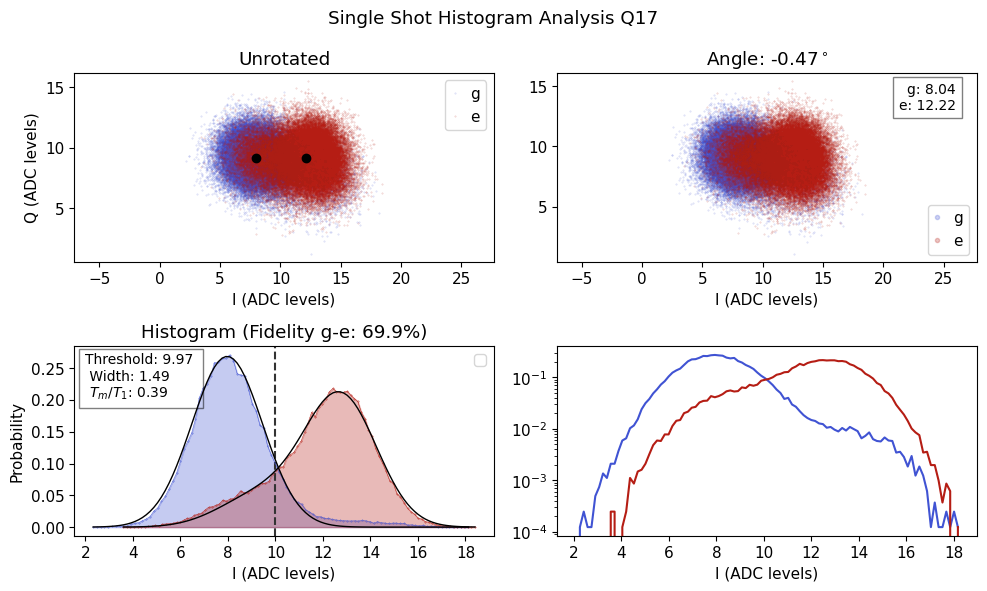

ge Fidelity (%): 69.893
Rotation angle (deg): -0.473
Threshold ge: 9.967
Reset is 0.0836762 of e and 1.41341 of g


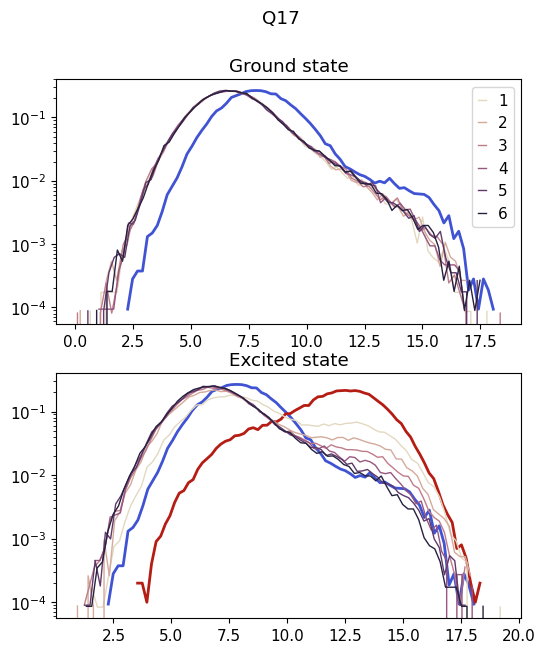

In [66]:
qubit_list = np.arange(11,20)
qubit_list =[17]
for qi in qubit_list:
    shot = meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':50000,'active_reset':True})
    shot.check_reset()

# Chi

  0%|          | 0/5 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_chi_fine_qubit0_00012.h5


  0%|          | 0/2 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_fine_qubit0_00083.h5


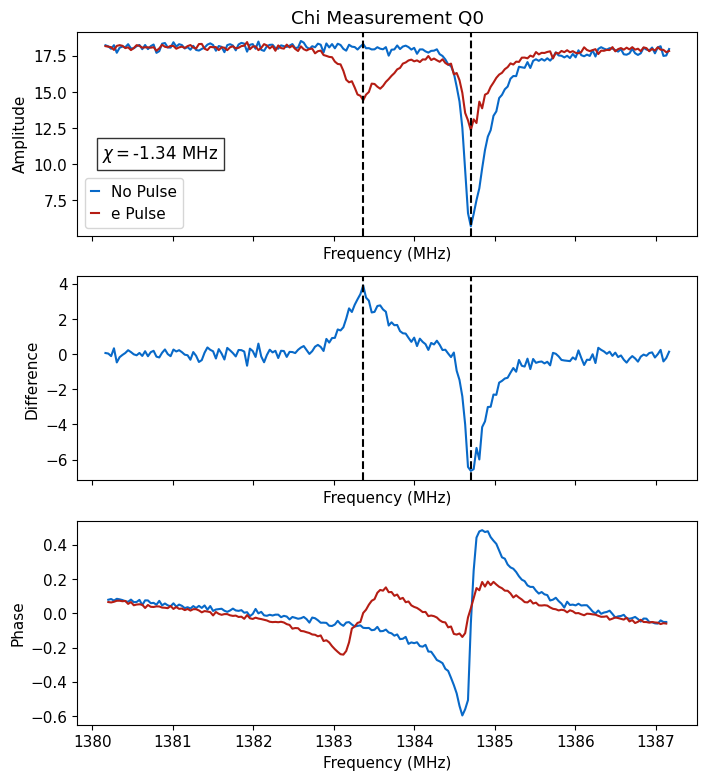

*Set cfg readout 0 chi to -1.3365 from -1.0199*


In [349]:
# Need a tuned up pi pulse for this
#for i in range(num_qubits):
qubit_list = [0]
for qi in qubit_list: 
    chi, chi_val=tuneup.check_chi(cfg_dict, qi)
    auto_cfg = config.update_readout(cfg_path, 'chi', chi_val, qi)


# 2 Qubit

  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.971	Fit par error:0.026	 Best fit:b'avgi'
R2:0.990	Fit par error:0.009	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_Q10_Q0_00022.h5


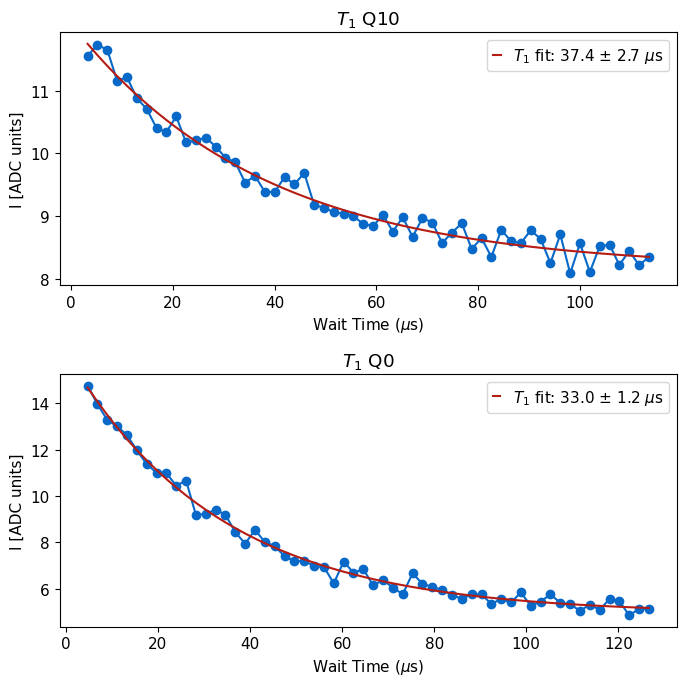

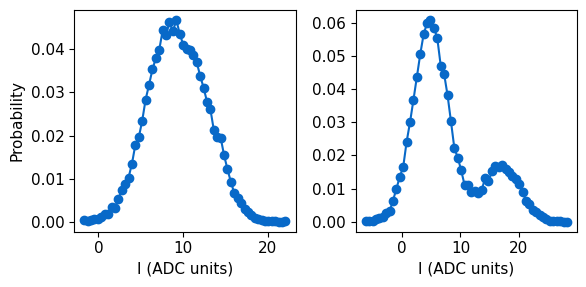

In [350]:
t12q = meas.T1_2Q(cfg_dict, qi=[10,0], params={'active_reset':False, })

In [ ]:
rabi2q = meas.Rabi_2Q(cfg_dict, qi=[10,0], params={'active_reset':True})

# EF 

In [ ]:
## Compare expected EF to actual
auto_cfg = config.load(cfg_path)

alpha=np.array(auto_cfg.device.qubit.f_ef)-np.array(auto_cfg.device.qubit.f_ge)
corr = np.array([188,210,168,186,155,171,187,145,157,169,188,210,168,186,155,171,187,145,157,169])

alpha+corr

#f_ef=np.array(auto_cfg.device.qubit.f_ge)-corr
#f_ef
#6,7,8, 11 16 18

### Initial setting of frequencies based on guess for alpha

In [ ]:
# Initial set of the frequencyies based on guess for alpha 
alpha = -180
qubit_list = np.arange(20)
auto_cfg = config.load(cfg_path)
for i in qubit_list: 
    f_ge = auto_cfg['device']['qubit']['f_ge'][i]
    auto_cfg = config.update_qubit(cfg_path, 'f_ef', f_ge+alpha, i)

## Spectroscopy EF

### General search

2


  0%|          | 0/135000 [00:00<?, ?it/s]

R2:0.840	Fit par error:0.026	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy_ef_medium_qubit0_00002.h5


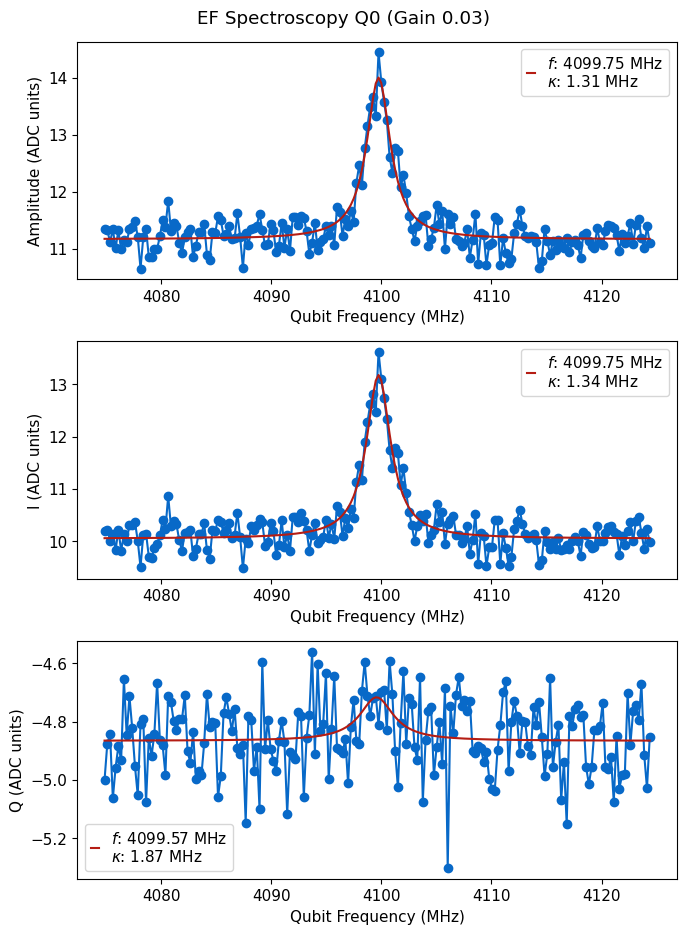

*Set cfg qubit 0 f_ef to 4099.7494 from 4099.6214*
3


  0%|          | 0/135000 [00:00<?, ?it/s]

R2:0.958	Fit par error:0.018	 Best fit:b'amps'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy_ef_fine_qubit0_00001.h5


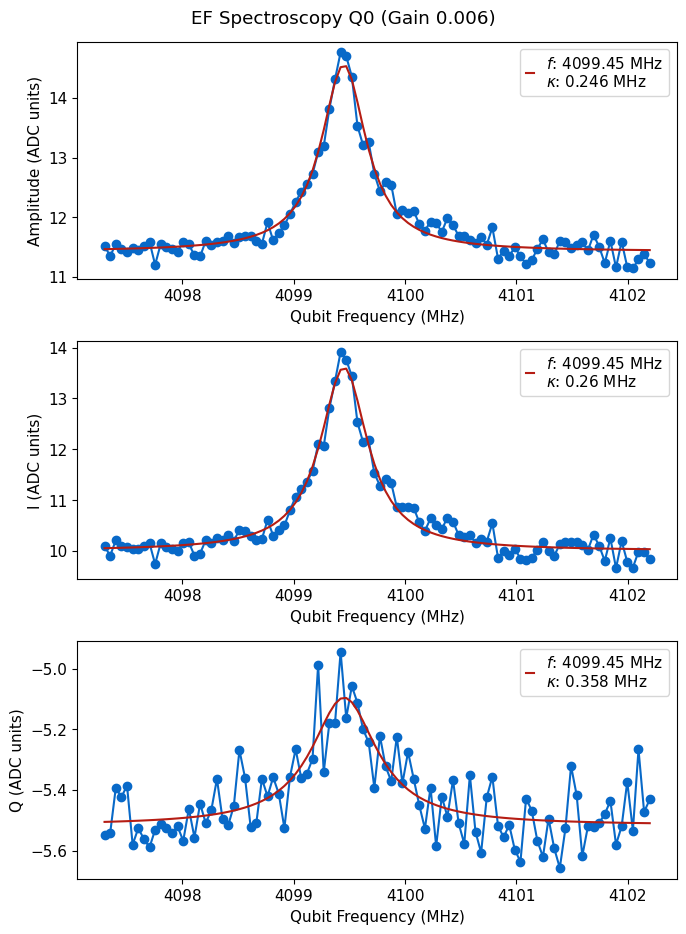

*Set cfg qubit 0 f_ef to 4099.4495 from 4099.7494*
Found qubit 0


In [353]:
qubit_list= np.arange(1,20)
bad_qubits=[]
qubit_list=[0]
for qi in qubit_list:
    status, ntries = qubit_tuning.find_spec(qi, cfg_dict, start='medium', freq='ef')
    if not status:
        bad_qubits.append(qi)

### Specific width

  0%|          | 0/135000 [00:00<?, ?it/s]

R2:0.828	Fit par error:0.027	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy_ef_medium_qubit0_00001.h5


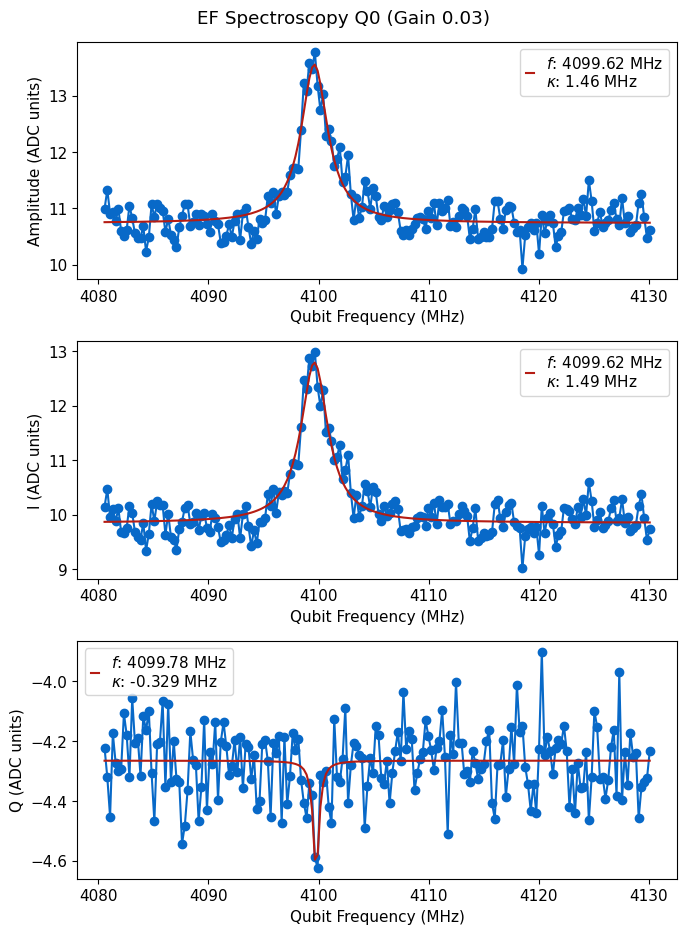

*Set cfg qubit 0 f_ef to 4099.6214 from 4105.32*


In [352]:
# You may want to update this frequency, which will be the center of the scan. 
#style huge, coarse, medium, fine 
update=True
qubit_list = np.arange(10)
qubit_list=[0]
for qi in qubit_list:
    qspec=meas.QubitSpec(cfg_dict, qi=qi, style='medium', params={'checkEF':True})#, params={'span':500, 'expts':1000,'reps':500,'gain':0.2})
    if update and qspec.status:
        auto_cfg = config.update_qubit(cfg_path, 'f_ef', qspec.data["best_fit"][2], qi)

## Rabi EF

  0%|          | 0/8100 [00:00<?, ?it/s]

R2:0.986	Fit par error:0.012	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_ef_qubit0_00016.h5


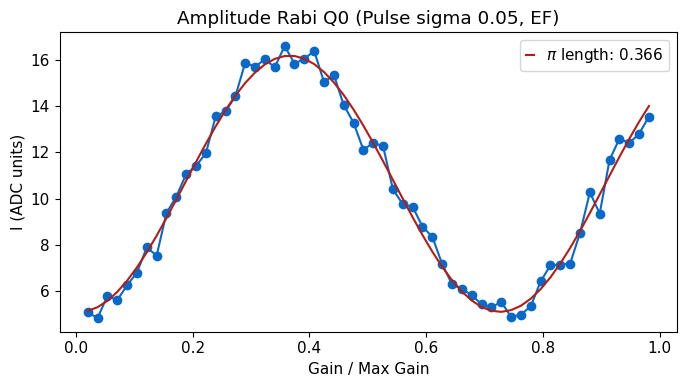

*Set cfg qubit 0 ('pulses', 'pi_ef', 'gain') to 0.3662 from 0.3639*


In [357]:
# If first time, initialize the sigma and gain to those of the ge 
first_time =False
update=True

qubit_list = np.arange(1,20)
qubit_list=[0]

bad_qubits = []
auto_cfg = config.load(cfg_path)

for qi in qubit_list: 
    if first_time:
        #config.update_qubit(cfg_path, 'f_ef', auto_cfg.device.qubit.f_spec_ef[qi], qi)
        auto_cfg = config.update_qubit(cfg_path, ('pulses','pi_ef','sigma'), auto_cfg['device']['qubit']['pulses']['pi_ge']['sigma'][qi], qi)
        auto_cfg = config.update_qubit(cfg_path, ('pulses','pi_ef','gain'), auto_cfg['device']['qubit']['pulses']['pi_ge']['gain'][qi], qi)
    amp_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params={'checkEF':True})
    if update and amp_rabi.status:
        config.update_qubit(cfg_path, ('pulses','pi_ef','gain'), amp_rabi.data['pi_length'], qi)
    else:
        print(f'Amplitude Rabi fit failed for qubit {qi}')
        bad_qubits.append(qi)

## Qubit Temperature

  0%|          | 0/29700 [00:00<?, ?it/s]

R2:0.988	Fit par error:0.015	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_ef_qubit12_00006.h5


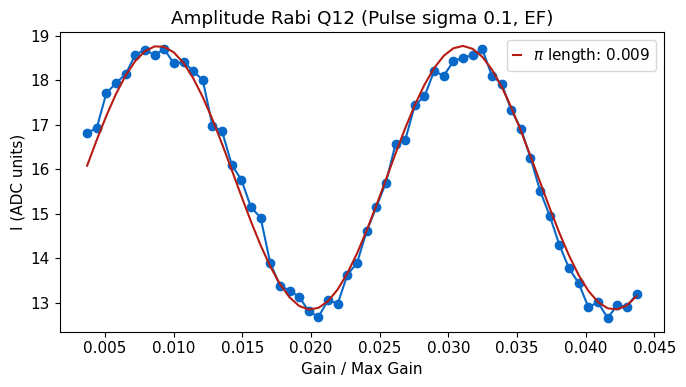

  0%|          | 0/200 [00:00<?, ?it/s]

R2:0.705	Fit par error:0.180	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_ef_no_ge_qubit12_00001.h5


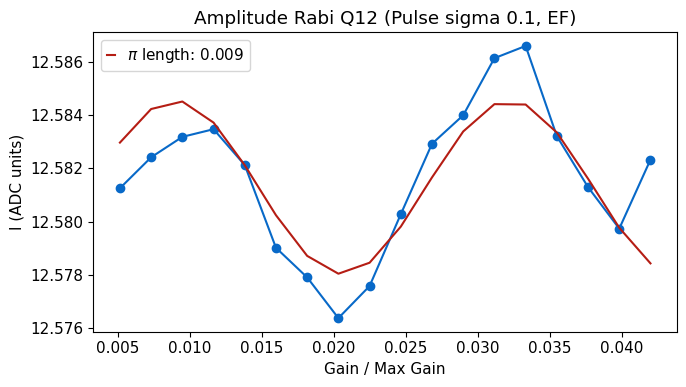

Qubit temp [mK]: 33.90443503247985
State preparation ratio: 0.0010949321079278375
2.965741321358196
0.0032472853965634196


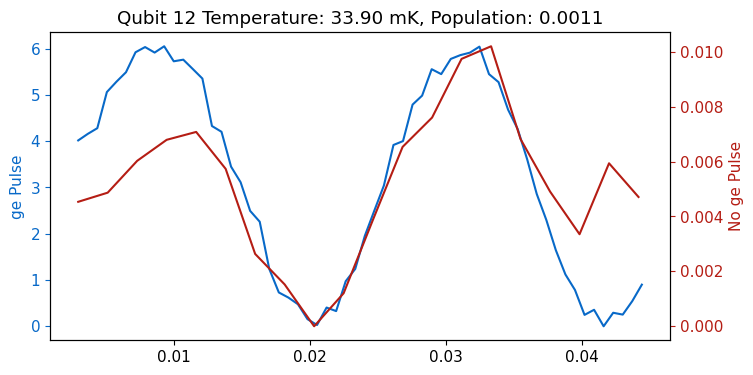

*Set cfg qubit 12 temp to 33.9044 from 32.0787*
*Set cfg qubit 12 pop to 0.0011 from 0.0007*


In [303]:
qubit_list = np.arange(1)
qubit_list=[12]
for qi in qubit_list: 
    temp, pop = tuneup.measure_temp(cfg_dict, qi=qi, soft_avgs=5)
    auto_cfg = config.update_qubit(cfg_path, 'temp', temp, qi)
    auto_cfg = config.update_qubit(cfg_path, 'pop', pop, qi)

In [304]:
0.01/6

0.0016666666666666668

## Ramsey EF

In [ ]:
qubit_list=np.arange(1,20)
qubit_list=[12]
for qi in qubit_list:
    t2r = meas.RamseyExperiment(cfg_dict, qi=qi, params={'ramsey_freq':0.1, 'checkEF':True})

    if t2r.status:
        config.update_qubit(cfg_path, 'f_ef', t2r.data['new_freq'], qi)
        #auto_cfg = config.update_qubit(cfg_path, 'T2r', t2r.data['best_fit'][3], qi, rng_vals=[1.5, max_t1], sig=2)
    else:
        print('T2 Ramsey fit failed')

# Time tracking of params

In [ ]:
qubit_list =np.arange(20)
qubit_list= [0,2,3,4,5,6,10,11,12,14,16]
time_track_data = [{'t1': [], 't2r': [],'t2e': [], 't1_data': [],'rx':[],'r_data':[], 't2r_data':[], 't2e_data':[], 'fid':[], 'phase':[], 't1x':[], 't2rx':[], 't2ex':[], 'fr':[],'fge':[]} for _ in qubit_list]
max_t1=500
update=True
#first, need to configure active reset and check stark for all. 
nexp = 2
t1_data = [[] for _ in qubit_list]
t2r_data = [[] for _ in qubit_list]
t2e_data = [[] for _ in qubit_list]
fid_data = [[] for _ in qubit_list]
phase_data = [[] for _ in qubit_list]
import time
start_time = time.time()
for i in range(nexp):
    
    for j, qi in enumerate(qubit_list):
        print(f"Starting run {i}/{nexp}, for qubit {qi}. Time elapsed {time.time()-start_time}")
        
        # Resonator spectroscopy 
        rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':'kappa'}, display=False, progress=False)
        auto_cfg = config.update_readout(cfg_path, 'frequency', rspec.data['fit'][0], qi, verbose=False)
        if rspec.status:
            auto_cfg = config.update_readout(cfg_path, 'qi', rspec.data['fit'][1], qi, verbose=False)
            auto_cfg = config.update_readout(cfg_path, 'qe', rspec.data['fit'][2], qi, verbose=False)
            auto_cfg = config.update_readout(cfg_path, 'kappa', rspec.data['kappa'], qi, rng_vals=[0.03, 10], verbose=False)
            time_track_data[j]['r_data'].append(rspec.data['amps'])

        shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000}, display=False, progress=False)
        if update:
            config.update_readout(cfg_path, 'phase', shot.data['angle'], qi, verbose=False);
            config.update_readout(cfg_path, 'threshold', shot.data['thresholds'][0], qi, verbose=False);
            config.update_readout(cfg_path, 'fidelity', shot.data['fids'][0], qi, verbose=False);
            
        t1 = meas.T1Experiment(cfg_dict, qi=qi, display=False, progress=False)
        if t1.status:
            auto_cfg = config.update_qubit(cfg_path, 'T1', t1.data['new_t1_i'], qi,sig=2, rng_vals=[1.5, max_t1], verbose=False)
            time_track_data[j]['t1_data'].append(t1.data['avgi'])
            time_track_data[j]['t1'].append(t1.data['new_t1'])
        else:
            time_track_data[j]['t1_data'].append(np.nan*np.ones(len(t1.data['xpts'])))
            time_track_data[j]['t1'].append(np.nan)

        t2r = meas.RamseyExperiment(cfg_dict, qi=qi, display=False, progress=False)
        if t2r.data['fit_err_par'][1]<0.5:
            config.update_qubit(cfg_path, 'f_ge', t2r.data['new_freq'], qi, verbose=False)
            time_track_data[j]['t2r_data'].append(t2r.data['avgi'])
            time_track_data[j]['t2r'].append(t2r.data['fit_avgi'][3])
        else:
            time_track_data[j]['t2r_data'].append(np.nan*np.ones(len(t2r.data['xpts'])))
            time_track_data[j]['t2r'].append(np.nan)

        if t2r.data['fit_err_par'][3]<0.5:
            auto_cfg = config.update_qubit(cfg_path, 'T2r', t2r.data['fit_avgi'][3], qi,sig=2, rng_vals=[1.5, 2*max_t1], verbose=False)

        
        t2e = meas.RamseyEchoExperiment(cfg_dict, qi=qi, display=False, progress=False)
        if t2e.status:
            auto_cfg = config.update_qubit(cfg_path, 'T2e', t2e.data['fit_avgi'][3], qi,sig=2, rng_vals=[1.5, 2*max_t1], verbose=False)
            time_track_data[j]['t2e_data'].append(t2e.data['avgi'])
            time_track_data[j]['t2e'].append(t2e.data['fit_avgi'][3])
        else:
            time_track_data[j]['t2e_data'].append(np.nan*np.ones(len(t2e.data['xpts'])))
            time_track_data[j]['t2e'].append(np.nan)

        
        time_track_data[j]['t1x'].append(t1.data['xpts'])
        time_track_data[j]['rx'].append(rspec.data['xpts'])
        time_track_data[j]['t2rx'].append(t2r.data['xpts'])
        time_track_data[j]['t2ex'].append(t2e.data['xpts'])
        
        time_track_data[j]['fr'].append(rspec.data['fit'][0])
        time_track_data[j]['fge'].append(t2r.data['new_freq'])
        
        time_track_data[j]['phase'].append(shot.data['angle'])
        time_track_data[j]['fid'].append(shot.data['fids'][0])
    # plt.figure()
    # fig, ax = plt.subplots(1, 1, figsize=(15, 15))
    # #ax = ax.flatten()
    # for i, qi in enumerate(qubit_list):
    #     ax.plot(t1_data[i], label=f'Q{qi}')
    # ax.legend()



In [ ]:
%matplotlib inline
plot_line=True

plt.figure()
#qubit_list= [0,1,2,3,4,5,6,10,11,12,14,16]

nqub = len(qubit_list)
sns.set_palette('coolwarm',nqub)
fig, ax = plt.subplots(2, 4, figsize=(14, 8))
fig2, ax2 = plt.subplots(3,5, figsize=(15,15))
fig3, ax3 = plt.subplots(3,5, figsize=(15,15))
fig4, ax4 = plt.subplots(3,5, figsize=(15,15))
fig5, ax5 = plt.subplots(3,5, figsize=(15,15))
ax2 = ax2.flatten()
ax3 = ax3.flatten()
ax4 = ax4.flatten()
ax = ax.flatten()
ax5 = ax5.flatten()
for i, qi in enumerate(qubit_list):
    #if qi==10 or qi==11:
    #    continue
    phase = np.unwrap(np.array(time_track_data[i]['phase']))
    ax[0].plot(time_track_data[i]['t1']/ np.mean(time_track_data[i]['t1']),'o-', label=f'Q{qi}')
    ax[1].plot(time_track_data[i]['t2r']/ np.mean(time_track_data[i]['t2r']),'o-', label=f'Q{qi}')
    ax[2].plot(time_track_data[i]['t2e']/ np.mean(time_track_data[i]['t2e']),'o-', label=f'Q{qi}')
    ax[3].plot(phase- np.mean(phase),'o-', label=f'Q{qi}')
    ax[4].plot(time_track_data[i]['fid'],'o-', label=f'Q{qi}')
    ff=(1-np.array(time_track_data[i]['fid']))/(1-np.mean(time_track_data[i]['fid']))
    
    #ax[5].plot(ff,'o-', label=f'Q{qi}')
    ax[6].plot(time_track_data[i]['fr']-np.mean(time_track_data[i]['fr']),'o-', label=f'Q{qi}')
    ax[7].plot(time_track_data[i]['fge']-np.mean(time_track_data[i]['fge']),'o-', label=f'Q{qi}')
    if plot_line:
        for j in range(nexp):
            ax2[i].plot(time_track_data[i]['t1x'][j],time_track_data[i]['t1_data'][j],label=f'Q{qi}')
            ax3[i].plot(time_track_data[i]['t2rx'][j],time_track_data[i]['t2r_data'][j], label=f'Q{qi}')
            ax4[i].plot(time_track_data[i]['t2ex'][j],time_track_data[i]['t2e_data'][j], label=f'Q{qi}')
    else:
        ax2[i].pcolormesh(time_track_data[i]['t1_data'],label=f'Q{qi}')
        #ax2[i].pcolormesh(time_track_data[i]['t1x'][0], np.arange(len(time_track_data[i]['t1_data'][0])), time_track_data[i]['t1_data'], shading='auto')
        ax3[i].pcolormesh(time_track_data[i]['t2r_data'], label=f'Q{qi}')
        ax4[i].pcolormesh(time_track_data[i]['t2e_data'], label=f'Q{qi}')
        ax5[i].pcolormesh(time_track_data[i]['r_data'], label=f'Q{qi}')
    ax2[i].set_title(f'Q{qi} T1')
    ax3[i].set_title(f'Q{qi} T2r')
    ax4[i].set_title(f'Q{qi} T2e')

ax[0].set_ylabel('$T_1/\bar{T_1}$')
ax[1].set_ylabel('$T_{2r}/\bar{T_{2r}}$')
ax[2].set_ylabel('$T_{2e}/\bar{T_{2e}}$')
ax[3].set_ylabel('Phase')
ax[4].set_ylabel('Fidelity')  
fig.tight_layout()
ax[0].legend(ncol=2)

In [ ]:
ax2[i].pcolormesh(time_track_data[i]['t1x'][0], np.arange(len(time_track_data[i]['t1_data'][0])), time_track_data[i]['t1_data'][j], shading='auto')

In [ ]:
plt.figure()
sns.set_palette('coolwarm',20)
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
#ax = ax.flatten()
for i, qi in enumerate(qubit_list):
    ax.plot(t1_data[i]/ np.mean(t1_data[i]), label=f'Q{qi}')
    
ax.legend()

In [ ]:
#first, need to configure active reset and check stark for all. 
nexp = 3
qubit_list =np.arange(20)
t1_data = [[] for _ in qubit_list]

for i in range(nexp):
    for j, qi in enumerate(qubit_list):
        t1_cont = meas.T1Experiment(cfg_dict, qi=qi)
        t1_data[j].append(t1_cont.data['new_t1'])

plt.figure()
fig, ax = plt.subplots(5, 4, figsize=(15, 15))
ax = ax.flatten()
for i, qi in enumerate(qubit_list):
    ax[i].set_title(f'Q{qi}')
    ax[i].pcolormesh(t1_data[i])
    plt.colorbar(ax[i].collections[0], ax=ax[i])

# Stark

## Ramsey

### Single experiment

Unexpected parameters found in params: {'stark_freq'}


  0%|          | 0/2 [00:00<?, ?it/s]

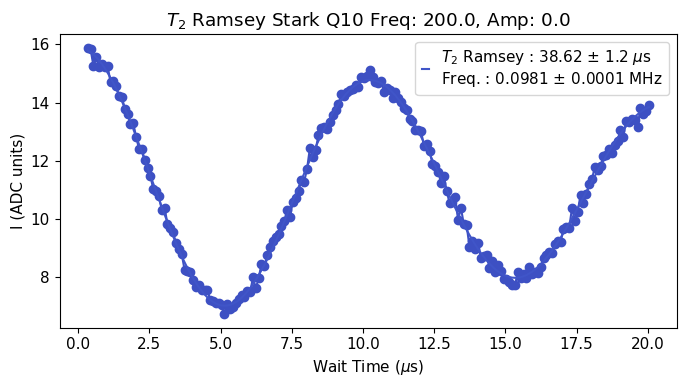

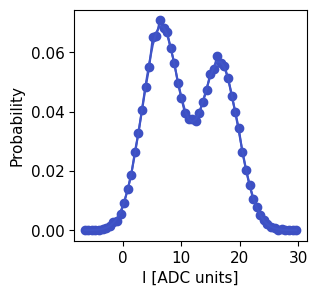

In [515]:
qi=10
meas.RamseyStarkExperiment(cfg_dict, qi=qi, params={'stark_gain':0.0,'step':0.1,'df':200,'acStark':False,'ramsey_freq':0.1})

Unexpected parameters found in params: {'stark_freq'}
macros:
	WriteReg(dst='s_core_w1', src=0)
	Delay(t=1.0, auto=True, gens=True, ros=True, tag=None, t_params={'t': <qick.asm_v2.QickParam object at 0x0000026AA796A230>}, t_regs={'t': 430})
	OpenLoop(n=484, name='reps')
	OpenLoop(n=200, name='wait_loop')
	ConfigReadout(ch=0, name='readout', t=0, tag=None, t_params={'t': <qick.asm_v2.QickParam object at 0x0000026AA796BA30>}, t_regs={'t': 0})
	Pulse(ch=0, name='pi2_prep', t=0.0, tag=None, t_params={'t': <qick.asm_v2.QickParam object at 0x0000026AA796AE00>}, t_regs={'t': 0})
	Delay(t=<qick.asm_v2.QickParam object at 0x0000026AA68D1150>, auto=True, gens=True, ros=True, tag='waiting', t_params={'t': <qick.asm_v2.QickParam object at 0x0000026A9B071240>}, t_regs={'t': 'r2'})
	Pulse(ch=0, name='pi2_read', t=0, tag=None, t_params={'t': <qick.asm_v2.QickParam object at 0x0000026AA796AD10>}, t_regs={'t': 0})
	Delay(t=0.01, auto=True, gens=True, ros=True, tag='wait', t_params={'t': <qick.asm_v2.Qi

  0%|          | 0/2 [00:00<?, ?it/s]

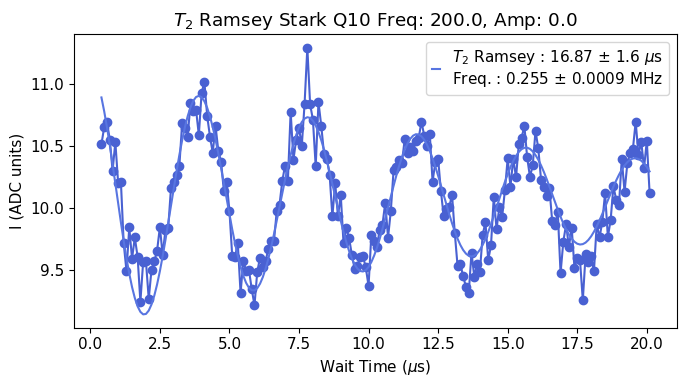

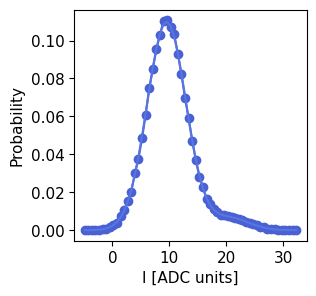

In [485]:
qi=10
meas.RamseyStarkExperiment(cfg_dict, qi=qi, params={'stark_gain':0.0,'step':0.1,'df':200,'acStark':False,'ramsey_freq':0.1})

### Sweep frequency

In [520]:
qubit_list = np.arange(3,20)
qubit_list=[10]
for qi in qubit_list:
    t2rstark=meas.RamseyStarkFreqExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'stark_gain':0.1, 'start_df':-30, 'end_df':30, 'expts_df':10})

Unexpected parameters found in params: {'end_df', 'expts_df', 'start_df', 'stark_freq'}
Unexpected parameters found in params: {'end_df', 'expts_df', 'start_df', 'stark_freq'}


  0%|          | 0/10 [00:00<?, ?it/s]

KeyboardInterrupt: 

Unexpected parameters found in params: {'end_df', 'expts_df', 'start_df', 'stark_freq'}
Unexpected parameters found in params: {'end_df', 'expts_df', 'start_df', 'stark_freq'}


  0%|          | 0/40 [00:00<?, ?it/s]

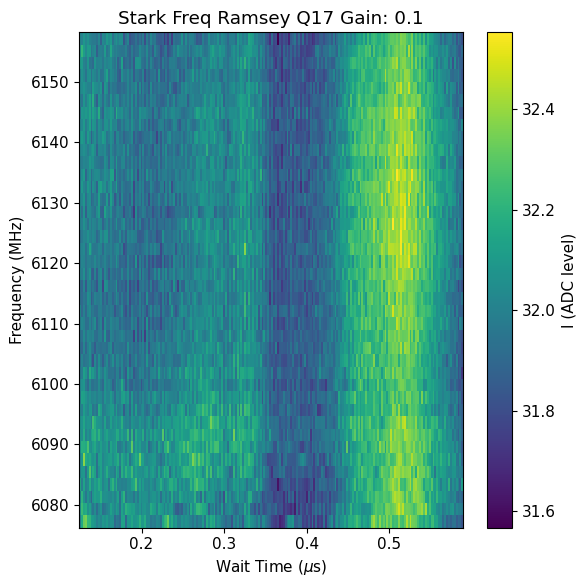

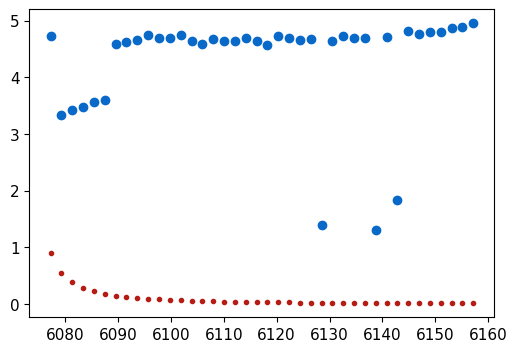

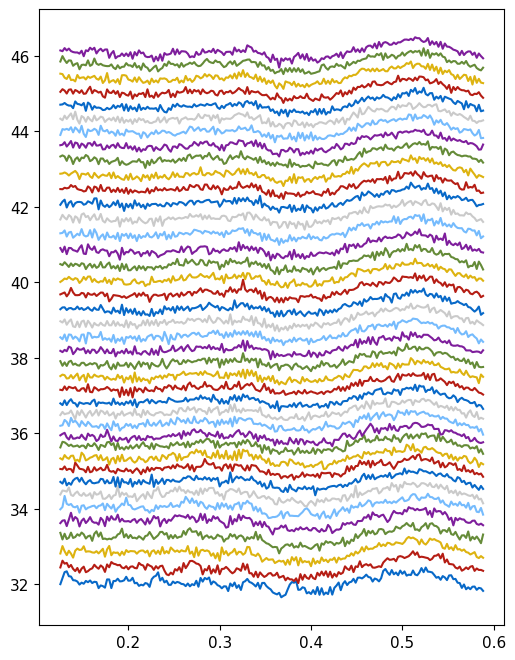

In [429]:
qubit_list = np.arange(3,20)
qubit_list=[17]
for qi in qubit_list:
    t2rstark=meas.RamseyStarkFreqExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'stark_gain':0.1, 'start_df':20, 'end_df':100, 'expts_df':40})

In [447]:
1/430*100

0.23255813953488372

### Calibrate stark power positive freq

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}
Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/20 [00:00<?, ?it/s]

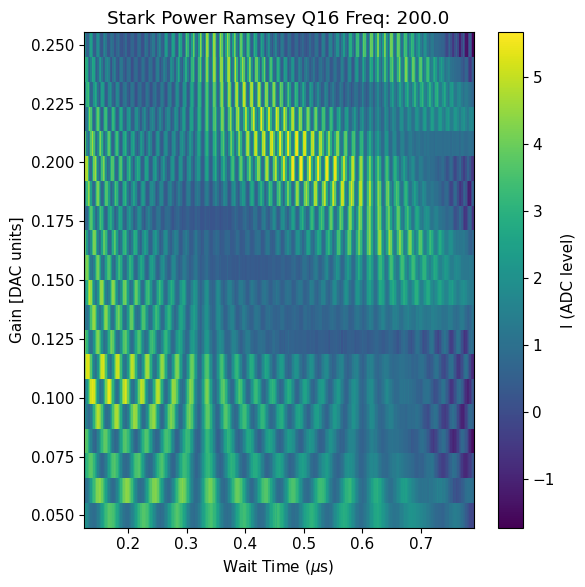

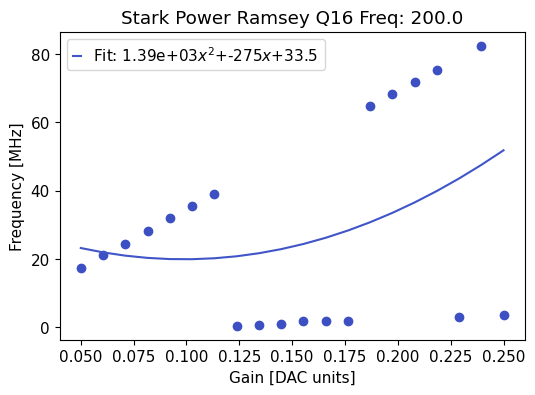

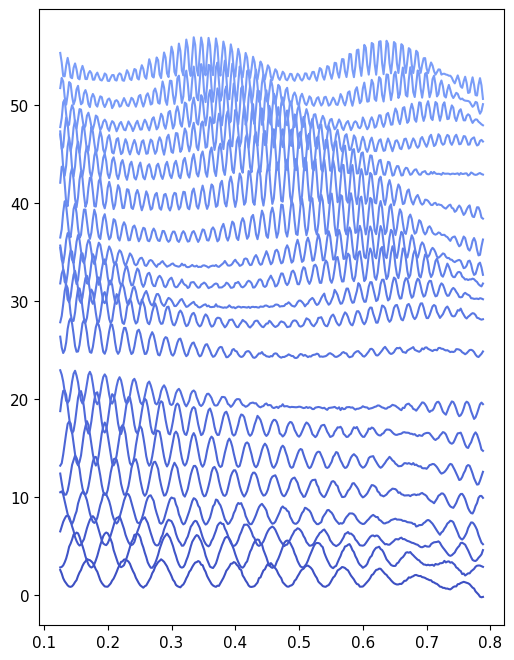

*Set cfg stark 16 q to 1391.9982 from 703.2375*
*Set cfg stark 16 l to -274.6114 from -386.9576*
*Set cfg stark 16 o to 33.4558 from 56.6382*
Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}
Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/20 [00:00<?, ?it/s]

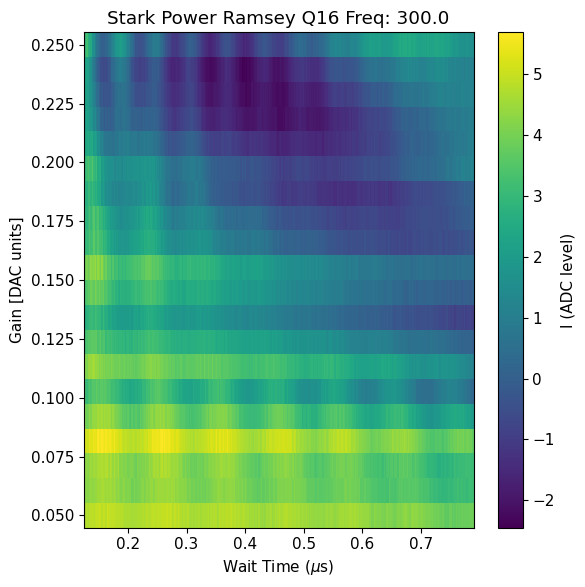

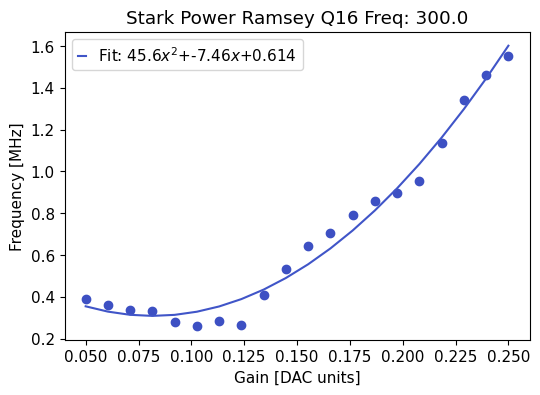

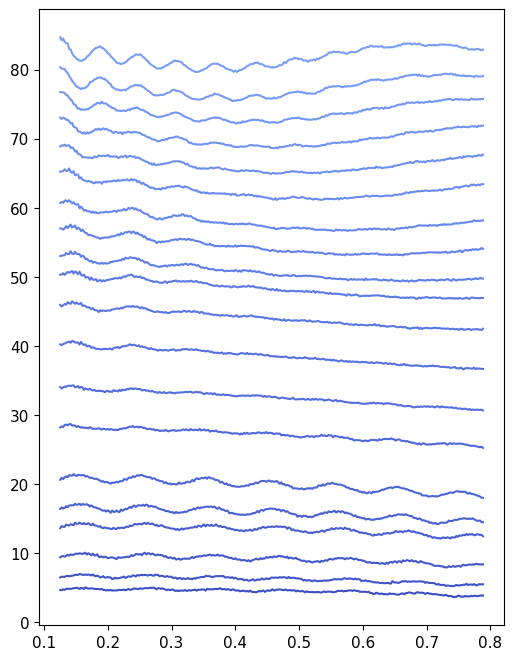

*Set cfg stark 16 q to 45.6312 from 1391.9982*
*Set cfg stark 16 l to -7.4557 from -274.6114*
*Set cfg stark 16 o to 0.6135 from 33.4558*


In [ ]:
qubit_list = np.arange(13,20)
qubit_list=[10]
d=[]
freqs= [200,300]
for f in freqs:
    for qi in qubit_list:
        t2rstark=meas.RamseyStarkPowerExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'expts_gain':20, 'df':f, 'start_gain':0.05, 'end_gain':0.25,'expts':286})
        d.append(t2rstark)
        config.update_stark(cfg_path, 'q', t2rstark.data['quad_fit'][0], qi)
        config.update_stark(cfg_path, 'l', t2rstark.data['quad_fit'][1], qi)
        config.update_stark(cfg_path, 'o', t2rstark.data['quad_fit'][2], qi)

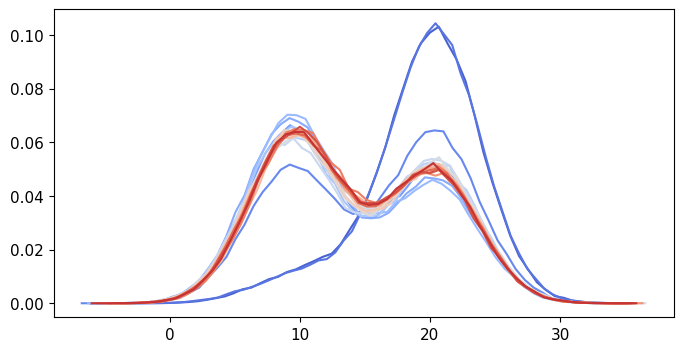

In [489]:
plt.figure()
for i in range(len(t2rstark.data['bin_centers'])):
    plt.plot(t2rstark.data['bin_centers'][i], t2rstark.data['hist'][i])
               

### Negative frequency

In [ ]:
#qubit_list = np.arange(20)
d=[]
qubit_list=[19]
for qi in qubit_list:
    t2rstark=meas.RamseyStarkPowerExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'expts_gain':12, 'df':-100, 'start_gain':0.08, 'end_gain':0.35, 'soft_avgs':2})
    d.append(t2rstark)
    config.update_stark(cfg_path, 'qneg', t2rstark.data['quad_fit'][0], qi)
    config.update_stark(cfg_path, 'lneg', t2rstark.data['quad_fit'][1], qi)
    config.update_stark(cfg_path, 'oneg', t2rstark.data['quad_fit'][2], qi)
#handy.plot_many(d, title='Ramsey Stark', save_path=cfg_dict['expt_path'])

## T1

### Single exp

In [522]:
t1 = meas.T1StarkExperiment(cfg_dict, qi=10, params={'active_reset':False, 'df':100}) 

Unexpected parameters found in params: {'stark_freq'}


RuntimeError: tried to cast a swept QickRawParam to int, which is not safe

### Gain sweep

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

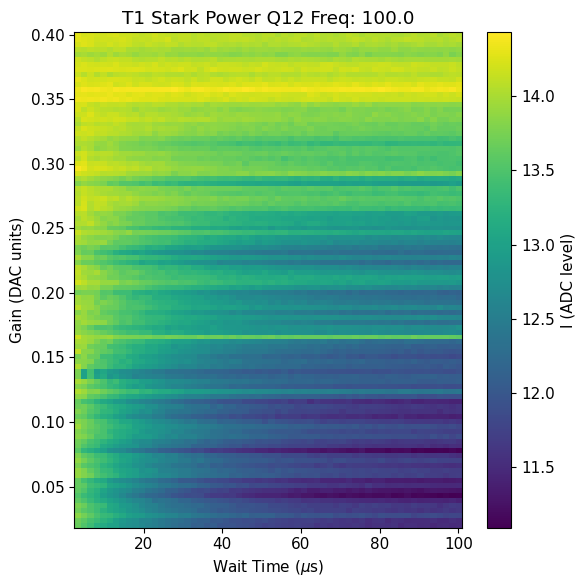

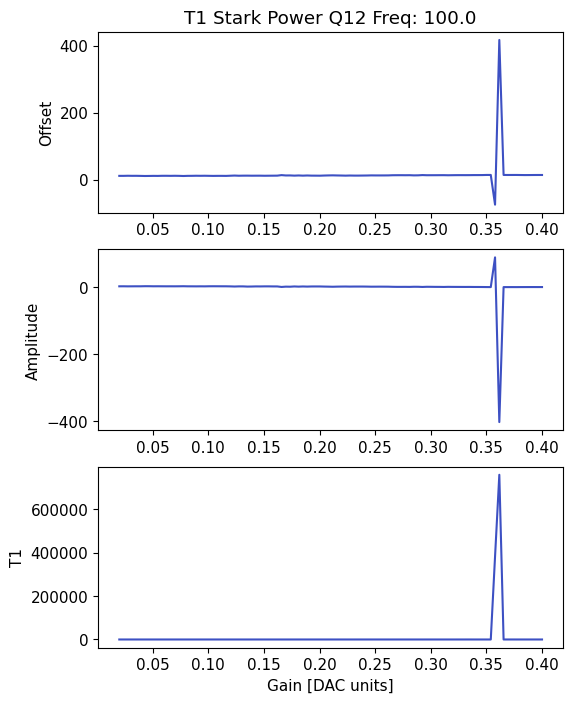

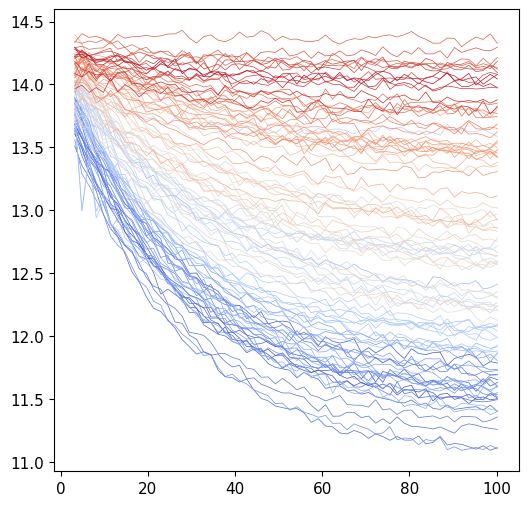

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

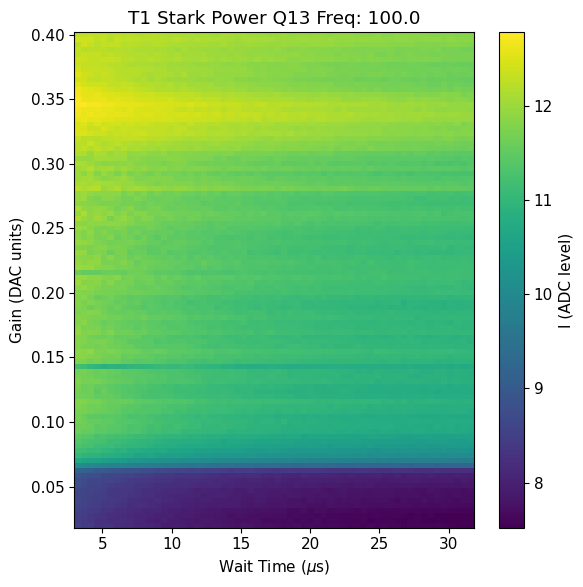

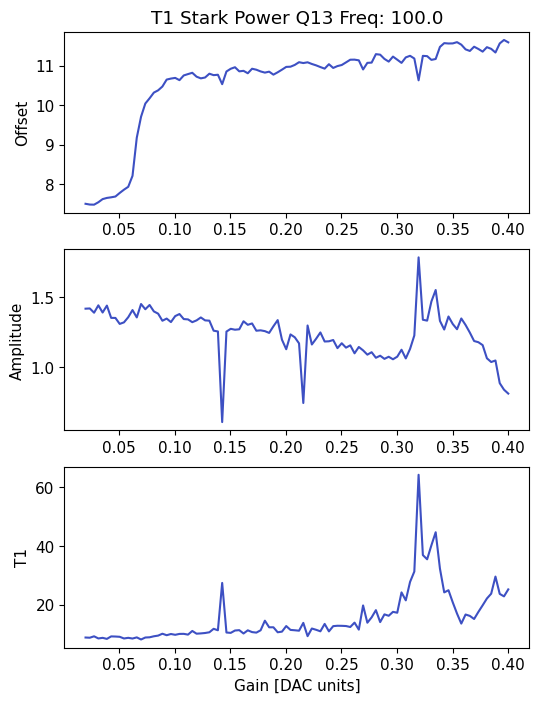

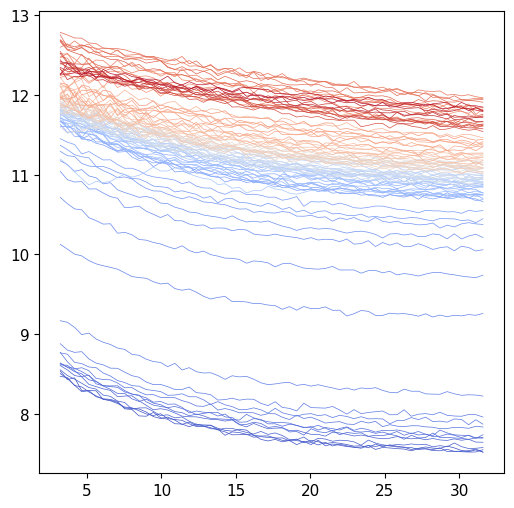

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

[15.621391925895596, -0.3538413887794718, 20.577566964285715]


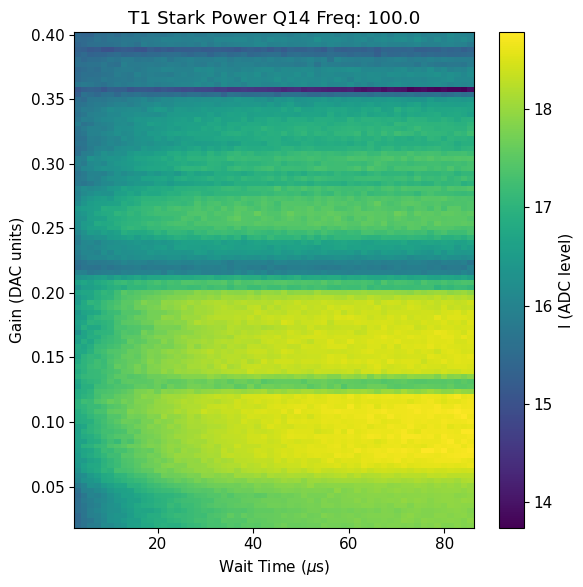

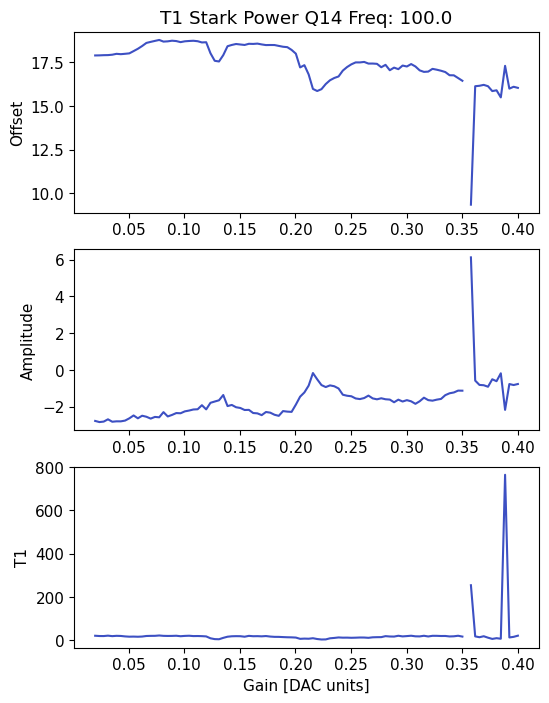

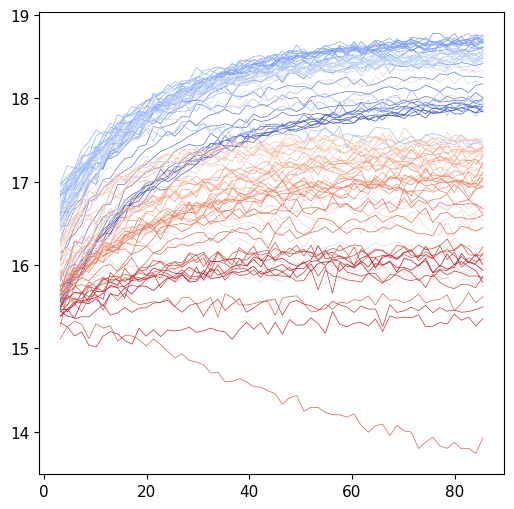

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

[3.5595462914876537, -0.019801462288242977, 8.36821056547619]


c:\Users\slab\anaconda3\envs\slab\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


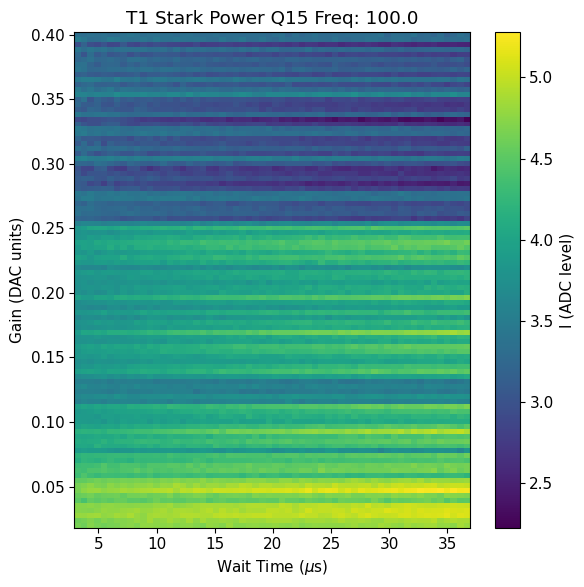

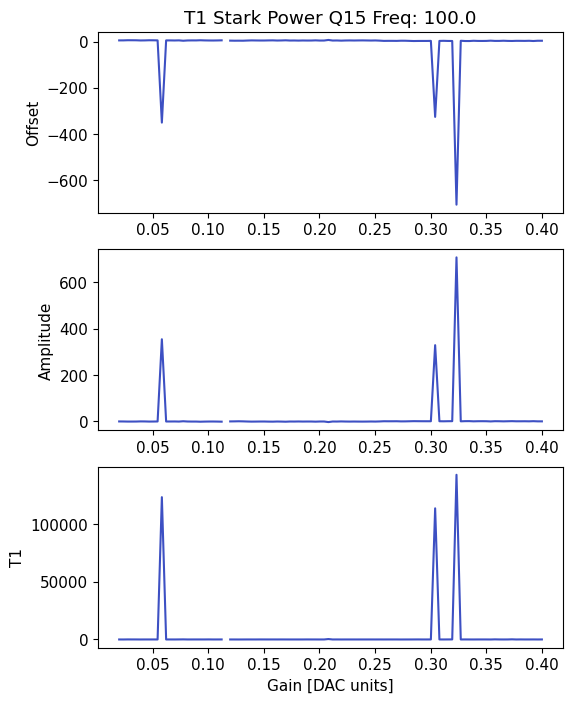

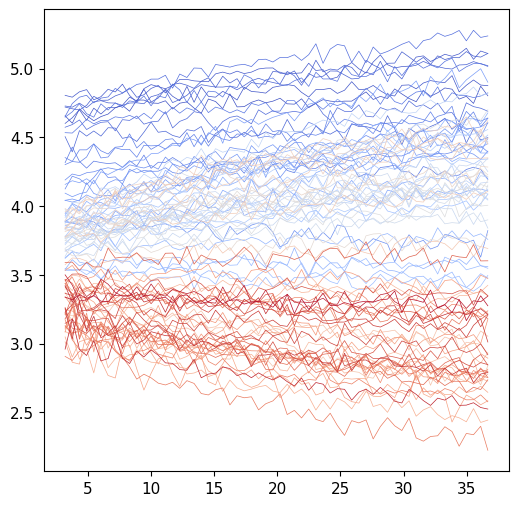

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

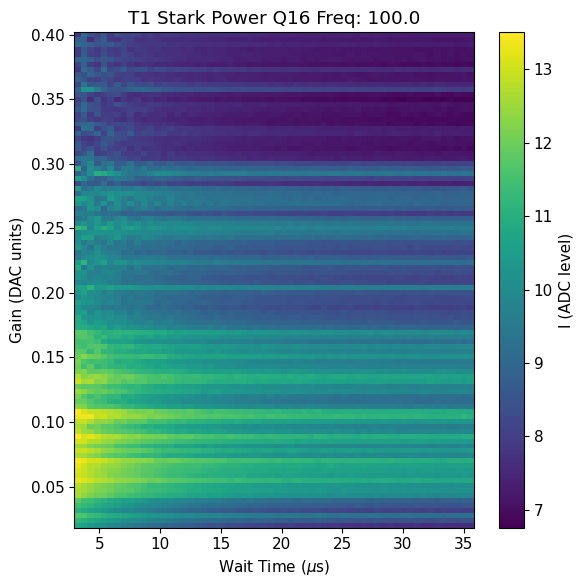

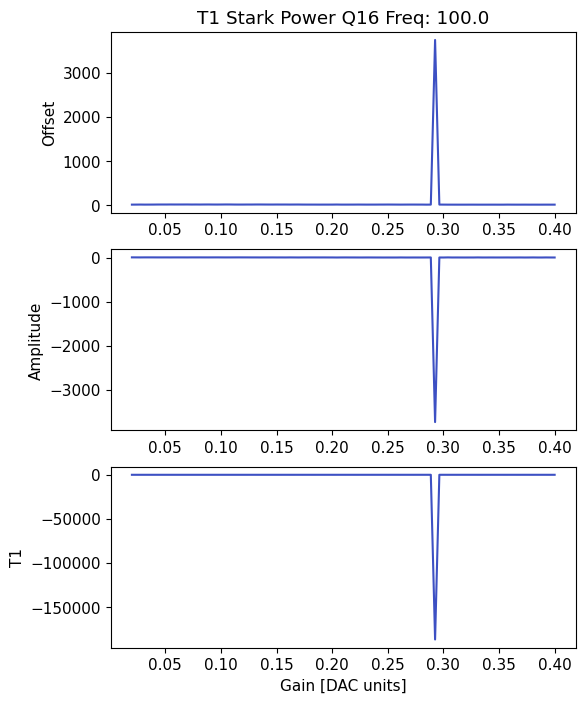

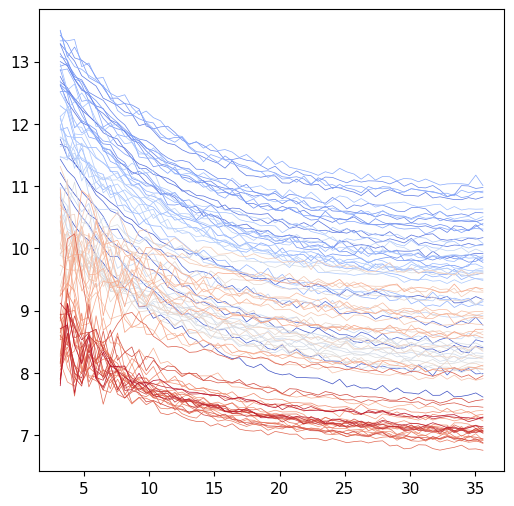

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

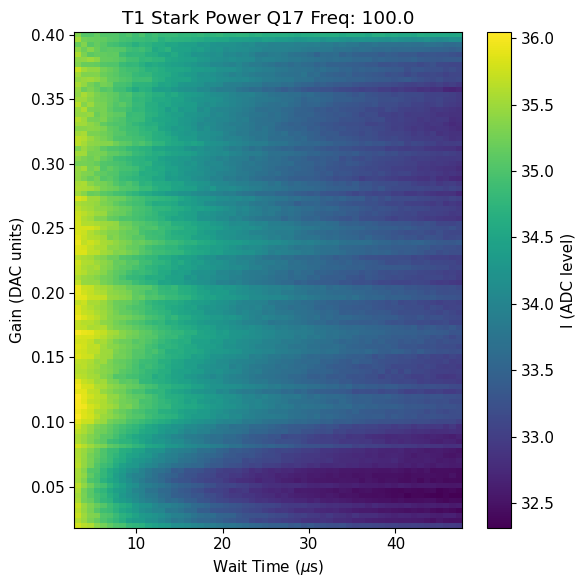

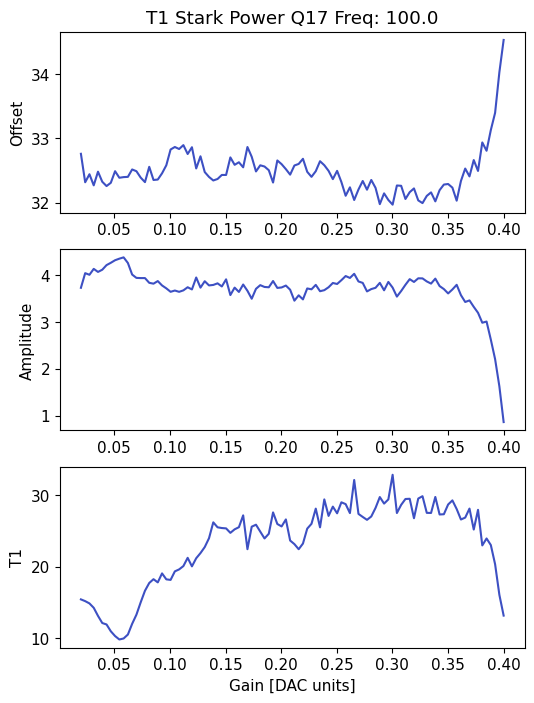

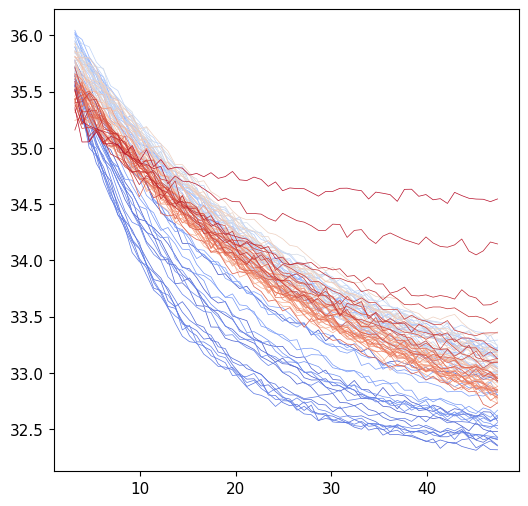

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

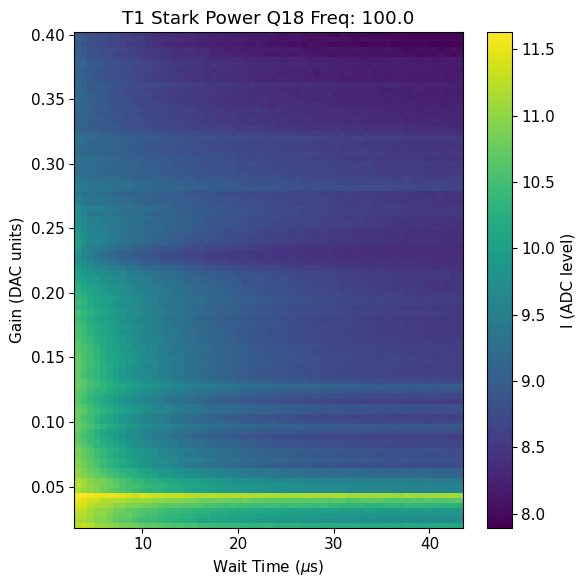

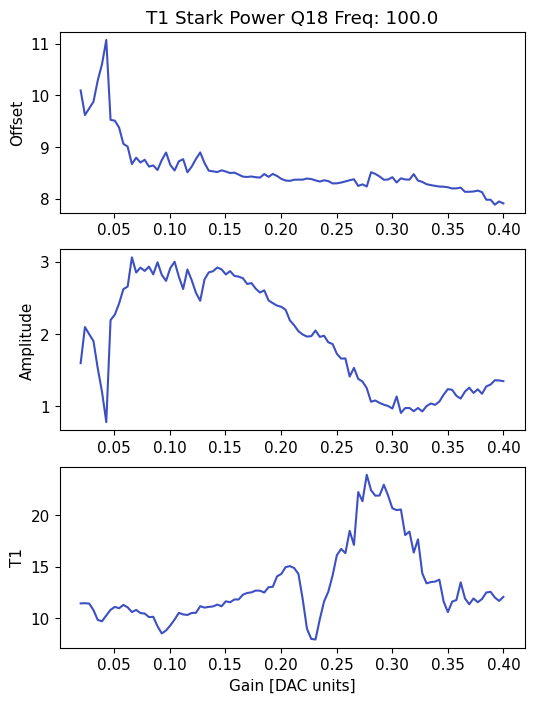

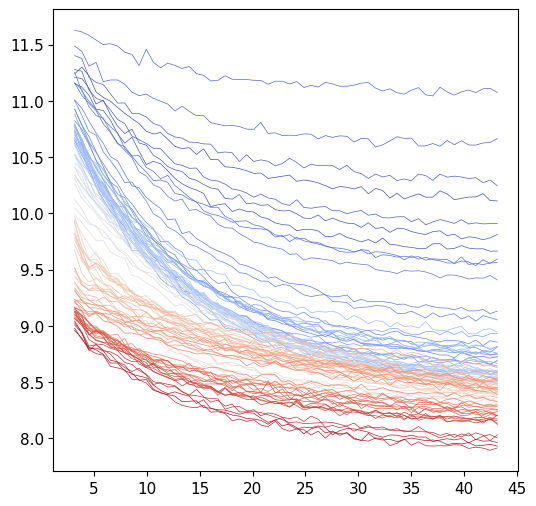

Unexpected parameters found in params: {'end_gain', 'expts_gain', 'start_gain', 'stark_freq'}


  0%|          | 0/100 [00:00<?, ?it/s]

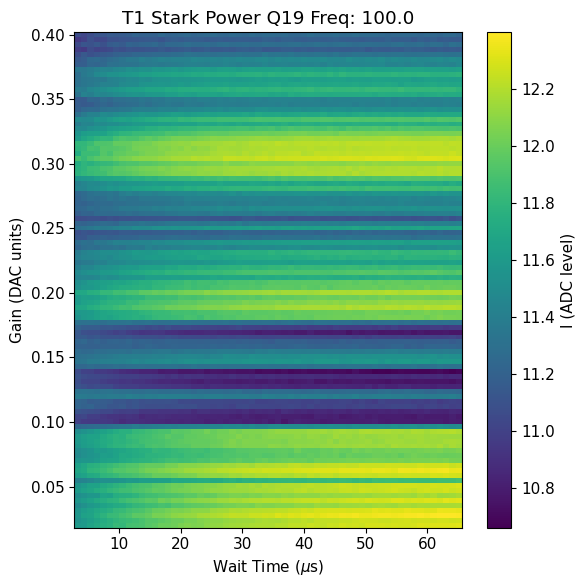

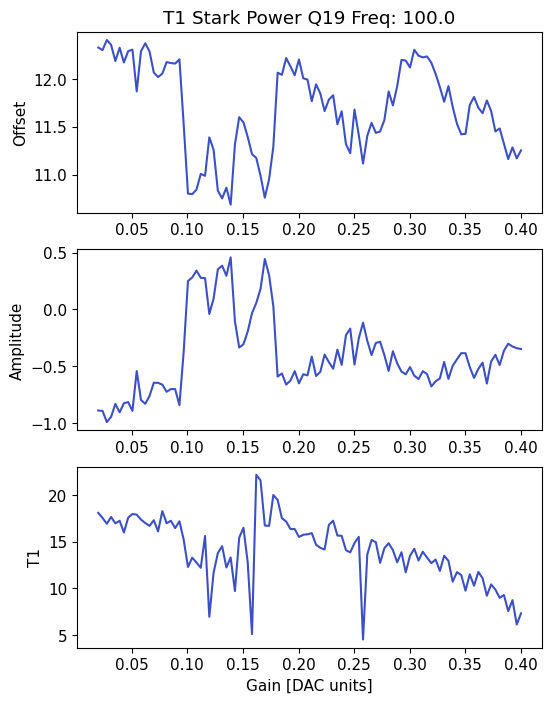

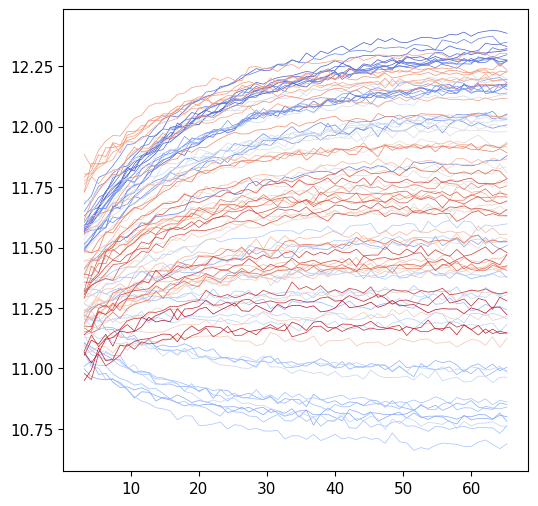

In [523]:
qubit_list = np.arange(12,20)
for qi in qubit_list: 
    #t1_neg = meas.T1StarkPowerExperiment(cfg_dict, qi=qi, params={'df':-70,'start_gain':0.02,'end_gain':0.2,'start':3, 'soft_avgs':4})

    t1_pos = meas.T1StarkPowerExperiment(cfg_dict, qi=qi, params={'df':100,'start_gain':0.02,'end_gain':0.4,'start':3, 'soft_avgs':4,'expts_gain':100})#, 'start':100,'span':0.34, 'expts':100, 'soft_avgs':3})

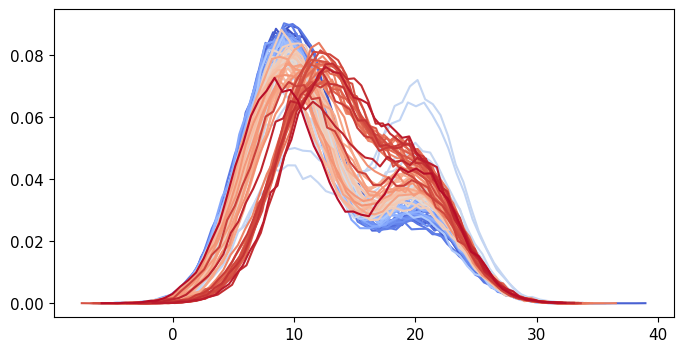

In [493]:
plt.figure()
for i in range(len(t1_pos.data['bin_centers'])):
    plt.plot(t1_pos.data['bin_centers'][i], t1_pos.data['hist'][i])

### Freq sweep

In [ ]:
t1_freq = meas.T1StarkFreqExperiment(cfg_dict, qi=0, params={'reps':800, 'span':0.5, 'expts':150, 'span_f':50, 'start_df':50})

### Single evo point linear gain sweep

In [ ]:
t1_cont = meas.T1StarkPowerSingle(cfg_dict, qi=0, params={"soft_avgs":4})

### Run linear scan for multiple qubits

In [ ]:
#first, need to configure active reset and check stark for all. 
nexp = 3
qubit_list =[1,2]#2,4,5,6,7]
expts = 200
t1_data = [[] for _ in qubit_list]

for i in range(nexp):
    for j, qi in enumerate(qubit_list):
        t1_cont = meas.T1StarkPowerSingle(cfg_dict, qi=qi, params={ "soft_avgs":2,'expts':100})
        t1_data[j].append(t1_cont.data['t1'])

plt.figure()
fig, ax = plt.subplots(3, 2, figsize=(10, 10))
ax = ax.flatten()
for i, qi in enumerate(qubit_list):
    ax[i].set_title(f'Q{qi}')
    ax[i].pcolormesh(t1_data[i])
    plt.colorbar(ax[i].collections[0], ax=ax[i])

### Repeated single evo, sweep frequency linearly with gain [Main scan]

In [ ]:
d=[]
qi=6
params={'stop_f':20, 'df_pos':100, 'df_neg':-70}
for i in range(200):
    if i%10==0:
        t1stark=meas.T1StarkPowerQuadSingle(cfg_dict, qi=qi, params=params)
        shot = meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000})
        config.update_readout(cfg_path, 'threshold',shot.data['thresholds'][0], qi);
        config.update_readout(cfg_path, 'phase', shot.data['angle'], qi);
        phase.append(shot.data['angle'])
    else:
        t1stark=meas.T1StarkPowerQuadSingle(cfg_dict, qi=qi, params=params, display=False, progress=False)

    d.append(t1stark)

times = [d[i].data['start_time'] for i in range(0, len(d))] 
tm = [datetime.strptime(times[i].decode('utf-8'), '%Y-%m-%d %H:%M:%S') for i in range(len(times))]
time_from_first = [(t - tm[0]).total_seconds() for t in tm]
print(time_from_first)

concatenated_data = np.concatenate([d[i].data['avgi'] for i in range(0, len(d))], axis=1)

plt.figure()
plt.pcolormesh(concatenated_data)

In [ ]:
plt.figure()
concatenated_data = np.concatenate([d[i].data['avgi'] for i in range(0, len(d))], axis=1)
import matplotlib.dates as mdates

plt.pcolormesh(np.array(time_from_first)/60/60, d[-1].data['f_pts'], concatenated_data)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
#plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))
#plt.gcf().autofmt_xdate()


### Multiple time evos (not currently using)

In [ ]:
t1stark=meas.T1StarkPowerQuadMulti(cfg_dict, qi=0, params={'stop_f':25, 'df_pos':100, 'df_neg':-90, 'active_reset':True})

### Calib sweep

### Analysis of multiple evo times using normal fittingh

In [ ]:
# Processing for multiple evo times 
cd0 = np.concatenate([d[i].data['avgi_0'] for i in range(0, len(d))], axis=1)
cd1 = np.concatenate([d[i].data['avgi_1'] for i in range(0, len(d))], axis=1)
cd2 = np.concatenate([d[i].data['avgi_2'] for i in range(0, len(d))], axis=1)
cd3 = np.concatenate([d[i].data['avgi_3'] for i in range(0, len(d))], axis=1)

combined_cd = np.stack((cd0, cd1, cd2, cd3), axis=-1)
print(combined_cd.shape)

tms=d[0].data['wait_times']

sns.set_palette('coolwarm',len(combined_cd))
from scipy.optimize import curve_fit
plt.figure()
def t1_fit(x, a, b, c):
    return b * np.exp(-x / c) + a
fits=[]
tm_full = np.linspace(0, tms[3])
#for i in range(5):
for i in range(len(combined_cd)):
    plt.plot(tms, combined_cd[i][0][:],'o-')
    p0 = (np.min(combined_cd[i][0][:]), np.max(combined_cd[i][0][:])-np.min(combined_cd[i][0][:]), tms[2])
    popt, err = curve_fit(t1_fit, tms, combined_cd[i][0][:], p0=p0)
    fit_err = np.sqrt(np.diag(err))   
    if np.mean(fit_err/np.abs(popt))>0.5:
        fits.append(np.nan*np.ones(3))   
    else:
        fits.append(popt)
    #print(p0)
    #plt.plot(tm_full, t1_fit(np.array(tm_full), *popt),'k', label=f'Fit {i}')
    #print(popt)
#plt.legend()
t1_data = [fits[i][2] for i in range(len(fits))]    
offset = [fits[i][0] for i in range(len(fits))]
amp = [fits[i][1] for i in range(len(fits))]

fig, ax = plt.subplots(3, 1, figsize=(8, 7))
ax[0].plot(t1_data, 'o-')
ax[1].plot(offset, 'o-')
ax[2].plot(amp, 'o-')

In [ ]:
# Concatenate all d[i].data['avgi'] into a single dataset
concatenated_data = np.concatenate([d[i].data['avgi'] for i in range(1, len(d))], axis=1)

#print(concatenated_data)

plt.figure()
plt.pcolormesh(concatenated_data)

#### Check max value for calibration

In [ ]:
np.max(t1.data['avgi'], axis=1)
plt.figure()
plt.plot(np.max(t1.data['avgi'], axis=1))